In [1]:
import numpy as np
from astropy import units as u, constants as const
from matplotlib import pyplot as plt
from scipy.stats import beta
from scipy.special import beta as betafct
from numba import jit, jitclass
from scipy import interpolate
from scipy.interpolate import interp1d
import logging
import sys
import os
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats
import numdifftools as nd
from findiff import FinDiff
from scipy.interpolate import CubicSpline, splrep, splev

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)
ss = SelfSimilarSolution(t_i, G, rho_H)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_cycloid_config(r_min=1e-2, r_max=1, N=1, t_max=5000, dt_min=1e-9, rho_bar=rho_H, delta_i=1, stepper_strategy='velocity_verlet', timescale_strategy='dyn', save_strategy='vflip', safety_factor=1e-4, reflect_bool=False, save_dt=1e-2, j_coeff=0, softlen=0, thickness_coef=0, irs='r0min_start_equal', mes='overlap_inclusive', pressure_strategy='zero', polytropic_index=-1, polytropic_coef=0, accel_strategy='soft_all', r_th=None, no_pm=False, density_strategy='background_plus_tophat2', relaxation_time=0, energy_strategy='kin_grav_rot', H=H0, drhodr_strategy='finite_diff', cq=0, hbar2_over_m2=0):
    if r_th is None:
        r_th = r_max
    m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    if no_pm:
        point_mass = 0
        shell_volume_strategy = 'keep_edges'
    else:
        point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
        shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'absorb'
    # if energy_strategy == 'gas':
    #     t_ta_strategy = 't_ta_gas'
    #     r_ta_strategy = 'r_ta_gas'
    # else:
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    if j_coeff > 0:
        ang_mom_strategy = 'const'
    else:
        ang_mom_strategy = 'zero'
    return {
        'point_mass': point_mass,
        'initial_radius_strategy': irs,
        'density_strategy': density_strategy,
        'delta': delta_i,
        'tophat_radius': r_th,
        'r0_min': r0_min,
        'rho_bar': rho_H,
        't_max': t_max,
        'dt_min': dt_min,
        'N': N,
        'r_min': r_min,
        'r_min_strategy': r_min_strategy,
        'H': H,
        'r_max': r_max,
        'm_pert': m_pert, 
        'stepper_strategy': stepper_strategy,
        'timescale_strategy': timescale_strategy,
        'save_strategy': save_strategy,
        'safety_factor': safety_factor,
        'save_dt': save_dt,
        'j_coef': j_coeff,
        'ang_mom_strategy': ang_mom_strategy,
        'r_ta_strategy': r_ta_strategy,
        't_ta_strategy': t_ta_strategy,
        'save_strategy': 'vflip',
        'softlen': softlen,
        'thickness_coef': thickness_coef,
        'm_enc_strategy': mes,
        'pressure_strategy': pressure_strategy,
        'polytropic_index': polytropic_index,
        'polytropic_coef': polytropic_coef,
        'accel_strategy': accel_strategy,
        'shell_volume_strategy': shell_volume_strategy,
        'relaxation_time': relaxation_time,
        'energy_strategy': energy_strategy,
        'drhodr_strategy': drhodr_strategy,
        'viscosity_cq': cq,
        'hbar2_over_m2': hbar2_over_m2,
    }

def run_and_plot(config, profile=False):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()

        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run() 
    plotter = SimulationPlotter(results, sc)
    # Configuration 1: Radius analysis
    plotter.plot_radius_analysis()
    # Configuration 2: Velocity and acceleration analysis
    plotter.plot_velocity_acceleration()
    # Configuration 3: Mass, density, and timescales
    plotter.plot_mass_density_timescales()
    # Configuration 4: Energy analysis
    plotter.plot_energy_analysis()
    # Configuration 5: Pressure analysis
    plotter.plot_pressure_analysis()
    return sc, results, plotter

def just_plot(plotter, t_center=None, window=None):
    if (t_center is None) or (window is None):
        plotter.plot_radius_analysis()
        plotter.plot_velocity_acceleration()
        plotter.plot_mass_density_timescales()
        plotter.plot_energy_analysis()
    else:
        t_min = t_center - window
        t_max = t_center + window

        # Add time window to all plots using a custom shell configuration
        shell_config = PlotConfig(
            property_name='',
            xlim=(t_min, t_max)
        )
        plotter.plot_radius_analysis(shell_config=shell_config)
        plotter.plot_velocity_acceleration(shell_config=shell_config)
        plotter.plot_mass_density_timescales(shell_config=shell_config)
        plotter.plot_energy_analysis(shell_config=shell_config)
        plotter.plot_pressure_analysis(shell_config=shell_config)


In [2]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [ ]:
t_max = 0.48784 # DEFINED ON R_HALF
hm2 = 1e-4
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

In [ ]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [12]:
t_max = 0.48784 # DEFINED ON R_HALF
hm2 = 1e-4
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 03:12:32,948 - collapse - INFO - Simulation setup complete


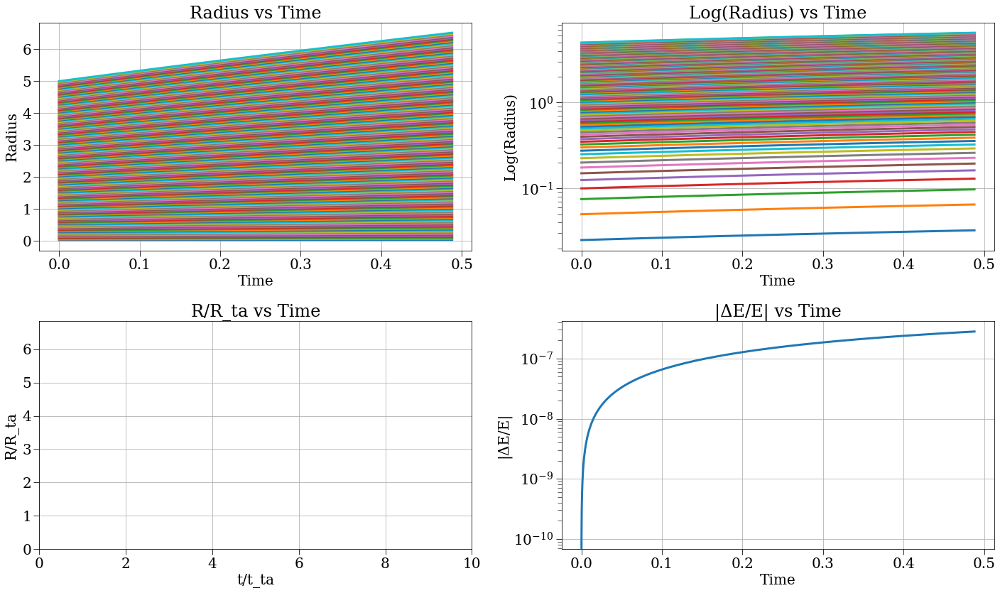

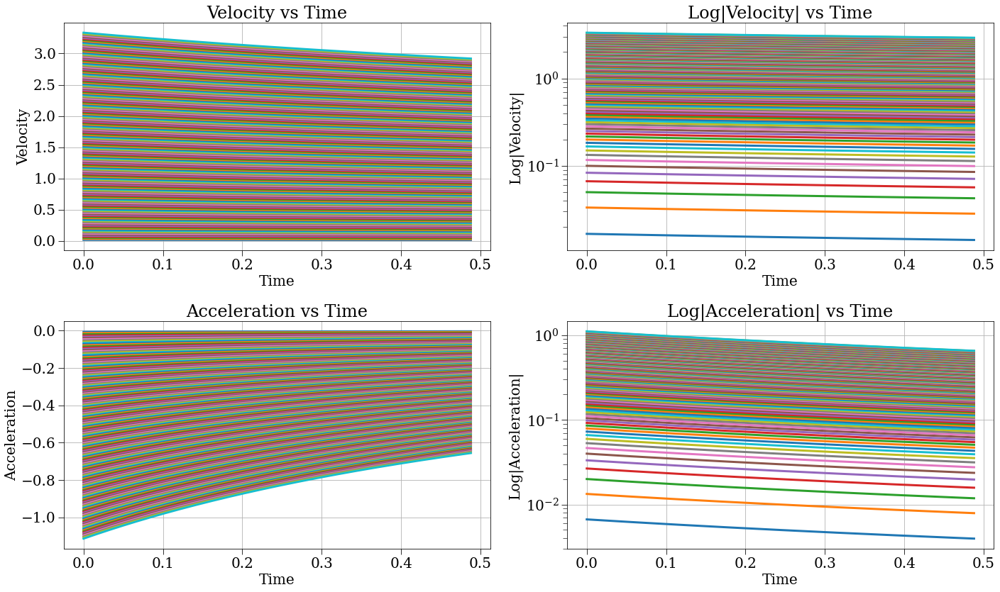

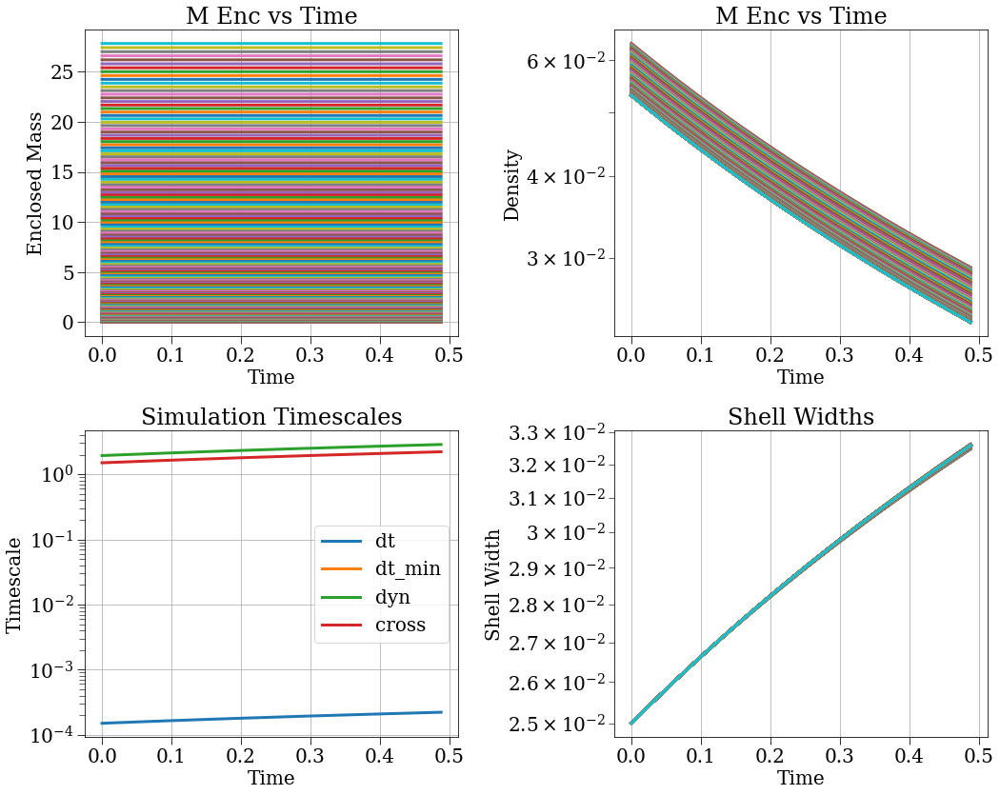

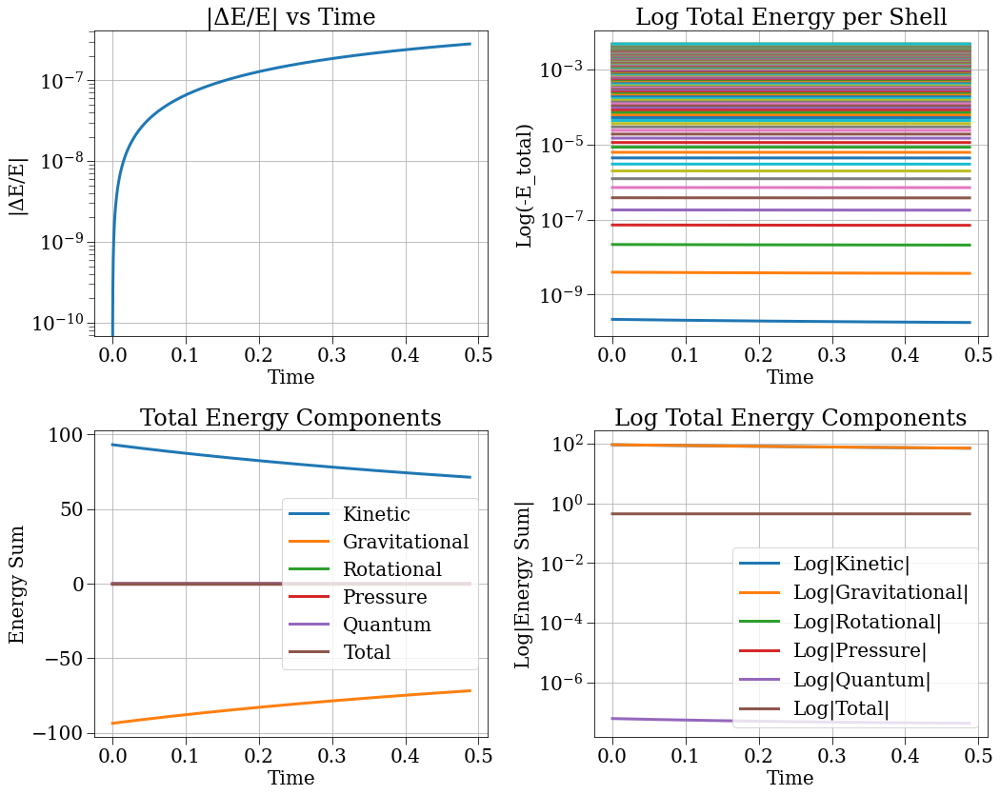

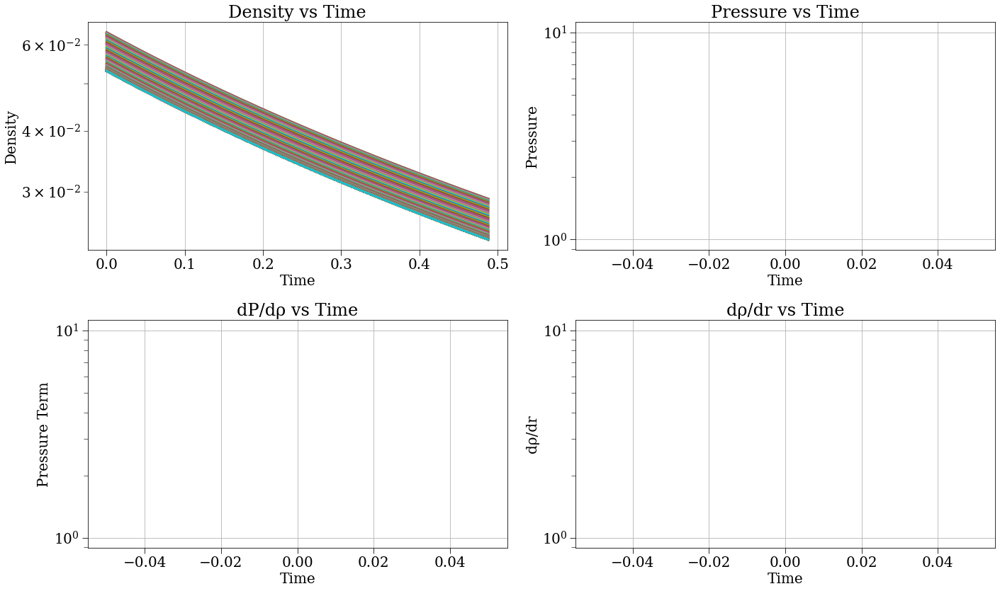

[0.025 0.05  0.075 0.1   0.125 0.15  0.175 0.2   0.225 0.25  0.275 0.3
 0.325 0.35  0.375 0.4   0.425 0.45  0.475 0.5   0.525 0.55  0.575 0.6
 0.625 0.65  0.675 0.7   0.725 0.75  0.775 0.8   0.825 0.85  0.875 0.9
 0.925 0.95  0.975 1.    1.025 1.05  1.075 1.1   1.125 1.15  1.175 1.2
 1.225 1.25  1.275 1.3   1.325 1.35  1.375 1.4   1.425 1.45  1.475 1.5
 1.525 1.55  1.575 1.6   1.625 1.65  1.675 1.7   1.725 1.75  1.775 1.8
 1.825 1.85  1.875 1.9   1.925 1.95  1.975 2.    2.025 2.05  2.075 2.1
 2.125 2.15  2.175 2.2   2.225 2.25  2.275 2.3   2.325 2.35  2.375 2.4
 2.425 2.45  2.475 2.5   2.525 2.55  2.575 2.6   2.625 2.65  2.675 2.7
 2.725 2.75  2.775 2.8   2.825 2.85  2.875 2.9   2.925 2.95  2.975 3.
 3.025 3.05  3.075 3.1   3.125 3.15  3.175 3.2   3.225 3.25  3.275 3.3
 3.325 3.35  3.375 3.4   3.425 3.45  3.475 3.5   3.525 3.55  3.575 3.6
 3.625 3.65  3.675 3.7   3.725 3.75  3.775 3.8   3.825 3.85  3.875 3.9
 3.925 3.95  3.975 4.    4.025 4.05  4.075 4.1   4.125 4.15  4.175 4.2
 4.225 

In [13]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[-0.00394991 -0.00789761 -0.01184152]


Text(0, 0.5, '$-a$')

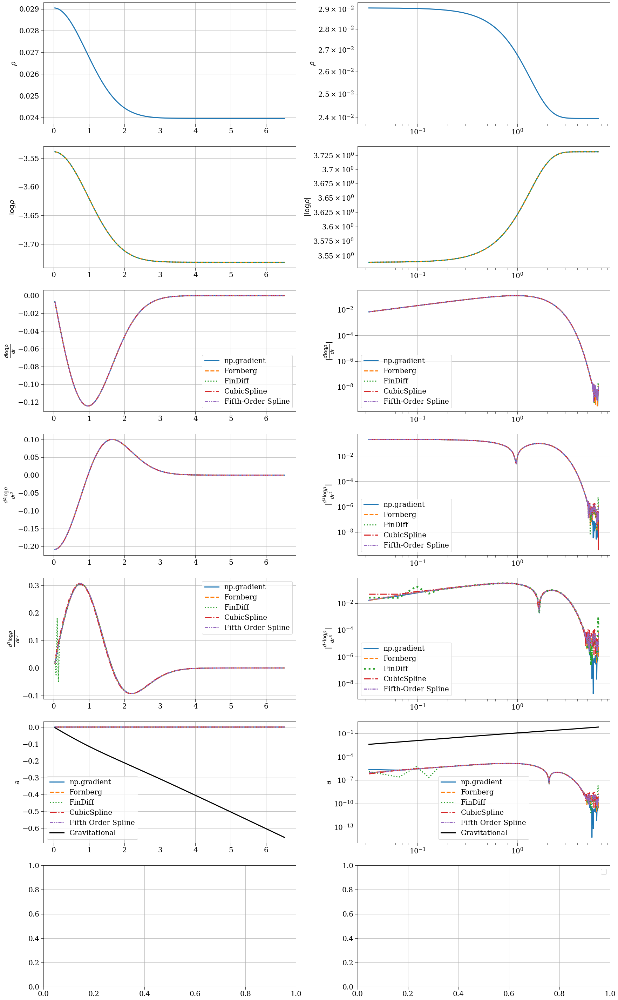

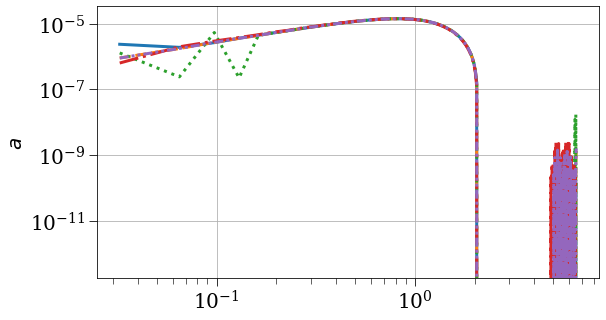

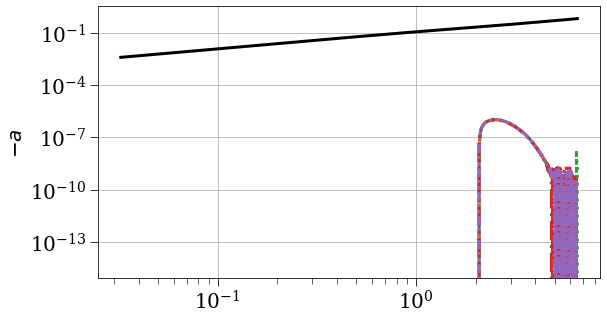

In [14]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [21]:
t_max = 1.727 # DEFINED ON R
hm2 = 1e-3
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 03:41:12,744 - collapse - INFO - Simulation setup complete


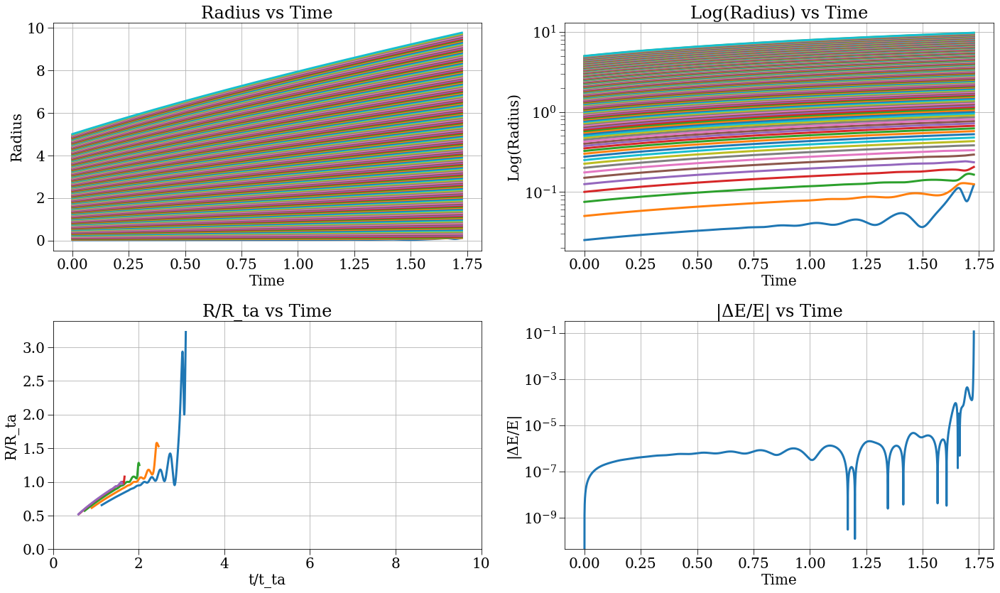

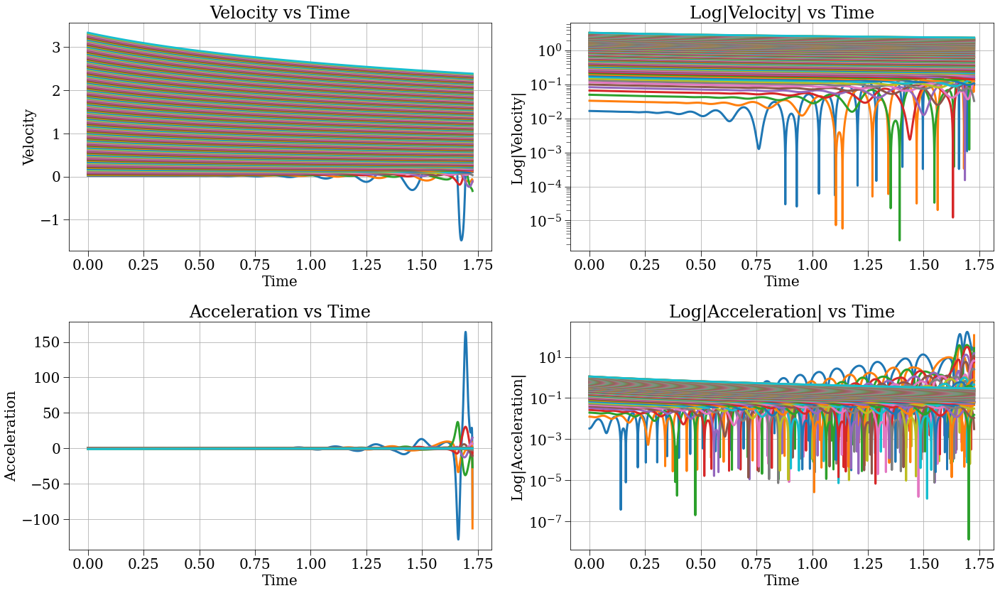

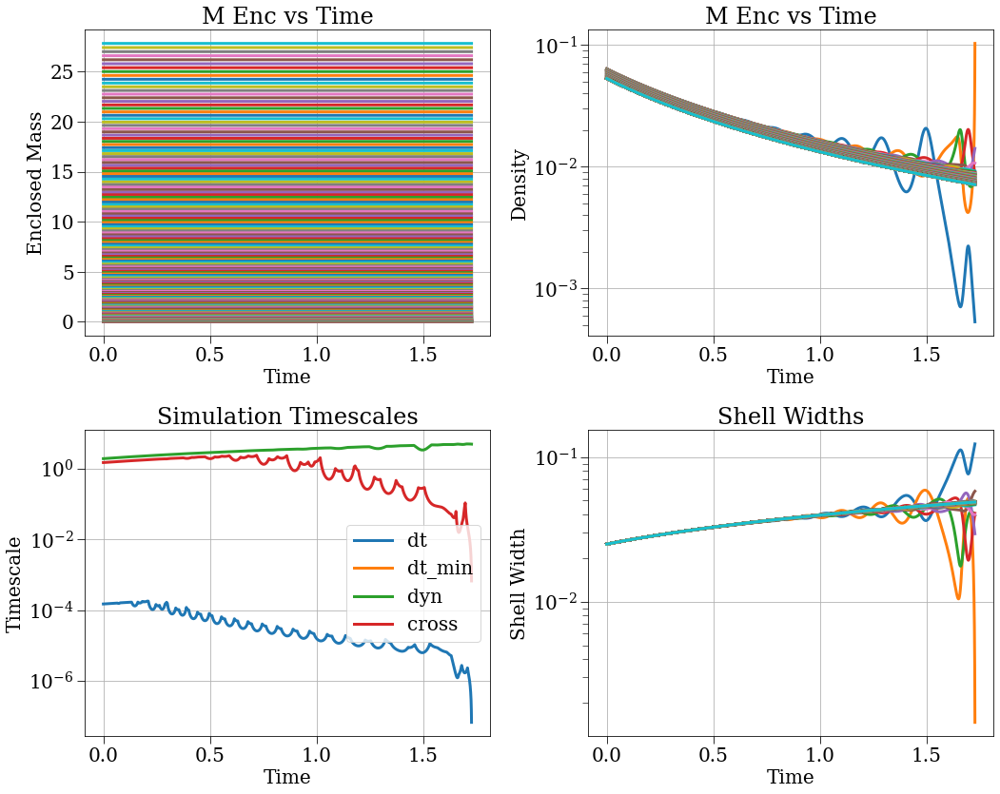

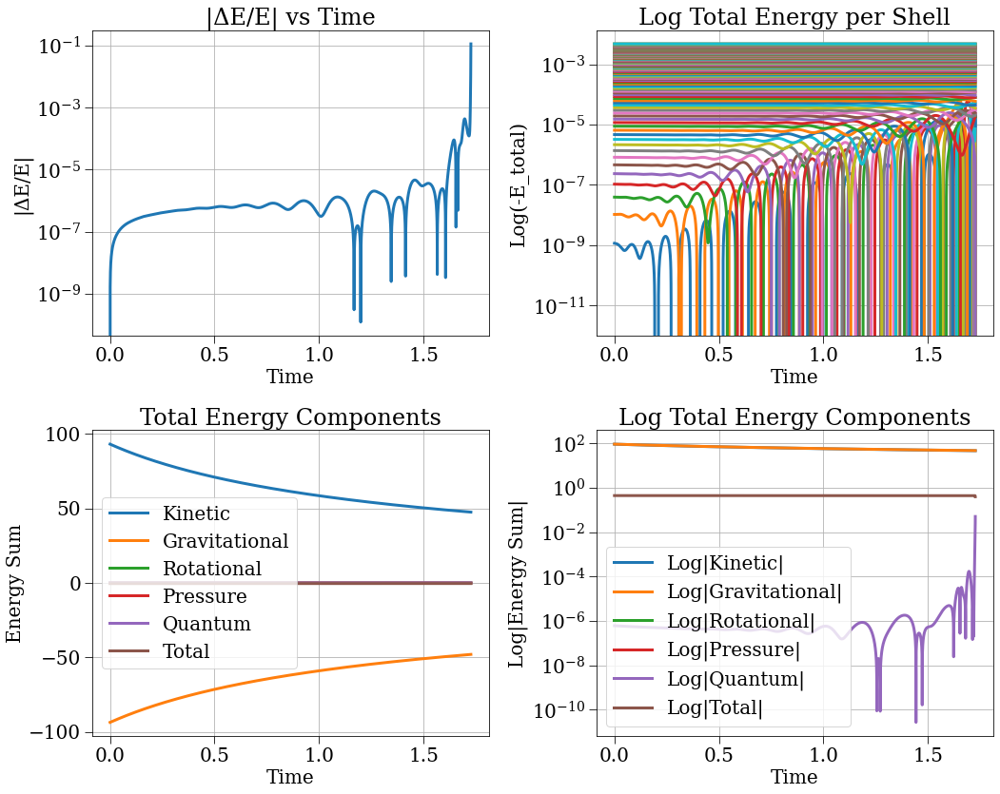

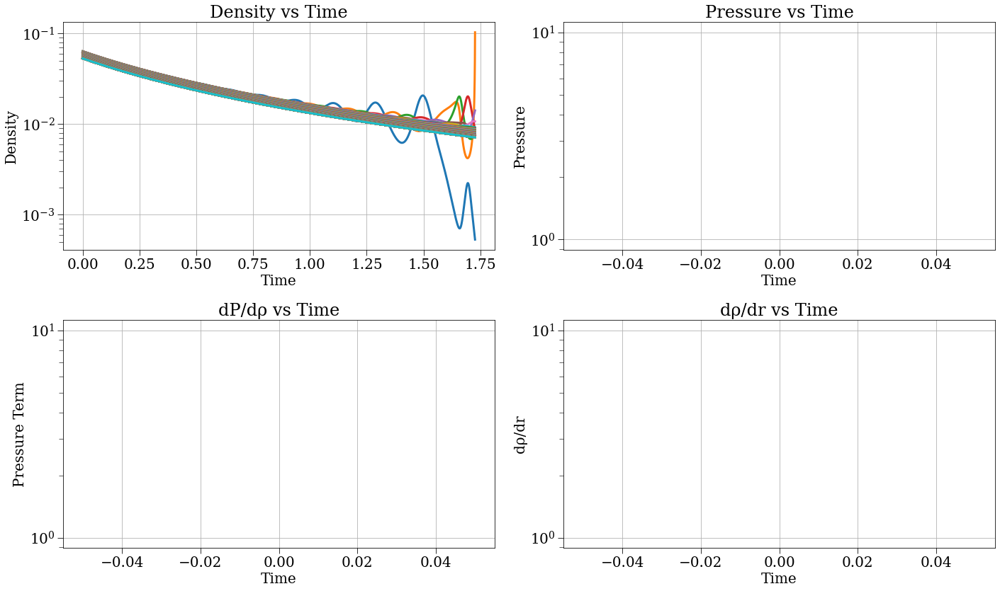

[0.025 0.05  0.075 0.1   0.125 0.15  0.175 0.2   0.225 0.25  0.275 0.3
 0.325 0.35  0.375 0.4   0.425 0.45  0.475 0.5   0.525 0.55  0.575 0.6
 0.625 0.65  0.675 0.7   0.725 0.75  0.775 0.8   0.825 0.85  0.875 0.9
 0.925 0.95  0.975 1.    1.025 1.05  1.075 1.1   1.125 1.15  1.175 1.2
 1.225 1.25  1.275 1.3   1.325 1.35  1.375 1.4   1.425 1.45  1.475 1.5
 1.525 1.55  1.575 1.6   1.625 1.65  1.675 1.7   1.725 1.75  1.775 1.8
 1.825 1.85  1.875 1.9   1.925 1.95  1.975 2.    2.025 2.05  2.075 2.1
 2.125 2.15  2.175 2.2   2.225 2.25  2.275 2.3   2.325 2.35  2.375 2.4
 2.425 2.45  2.475 2.5   2.525 2.55  2.575 2.6   2.625 2.65  2.675 2.7
 2.725 2.75  2.775 2.8   2.825 2.85  2.875 2.9   2.925 2.95  2.975 3.
 3.025 3.05  3.075 3.1   3.125 3.15  3.175 3.2   3.225 3.25  3.275 3.3
 3.325 3.35  3.375 3.4   3.425 3.45  3.475 3.5   3.525 3.55  3.575 3.6
 3.625 3.65  3.675 3.7   3.725 3.75  3.775 3.8   3.825 3.85  3.875 3.9
 3.925 3.95  3.975 4.    4.025 4.05  4.075 4.1   4.125 4.15  4.175 4.2
 4.225 

In [22]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[ -98.17415368 -112.98338754  -26.66426437]


Text(0, 0.5, '$-a$')

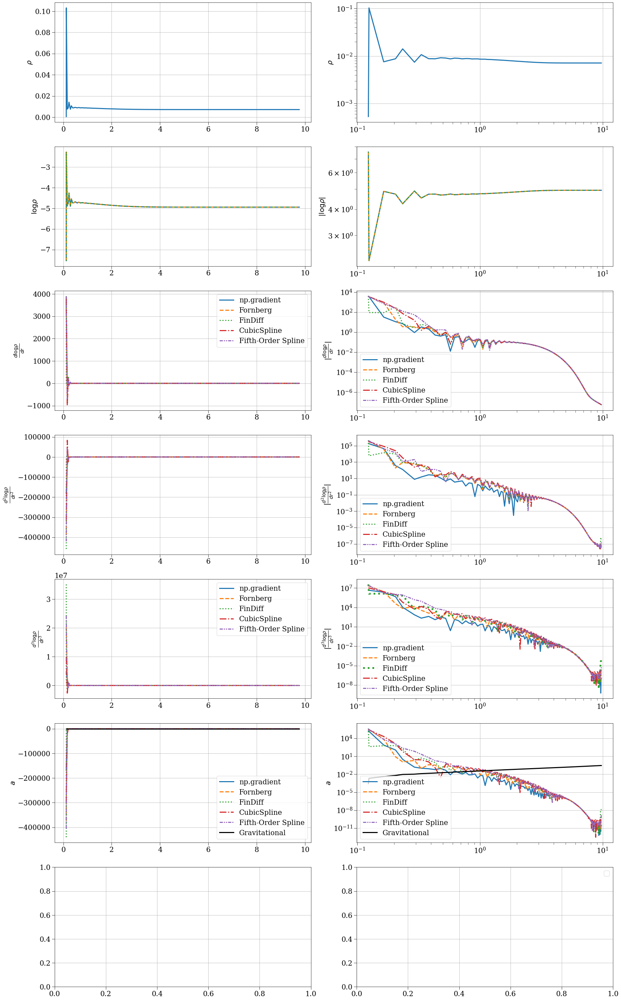

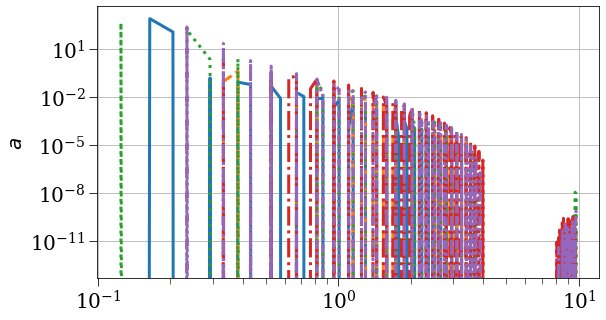

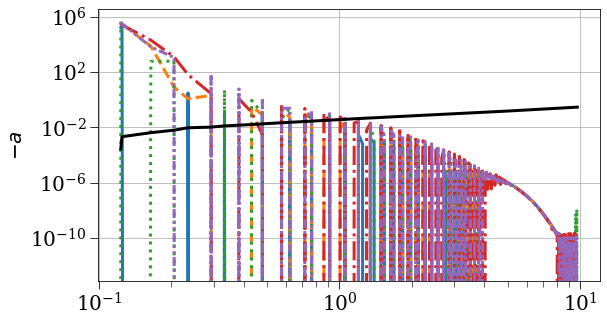

In [23]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [11]:
t_max = 0.48784 # DEFINED ON R NOT R_HALF
hm2 = 1e-3
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 02:43:33,206 - collapse - INFO - Simulation setup complete


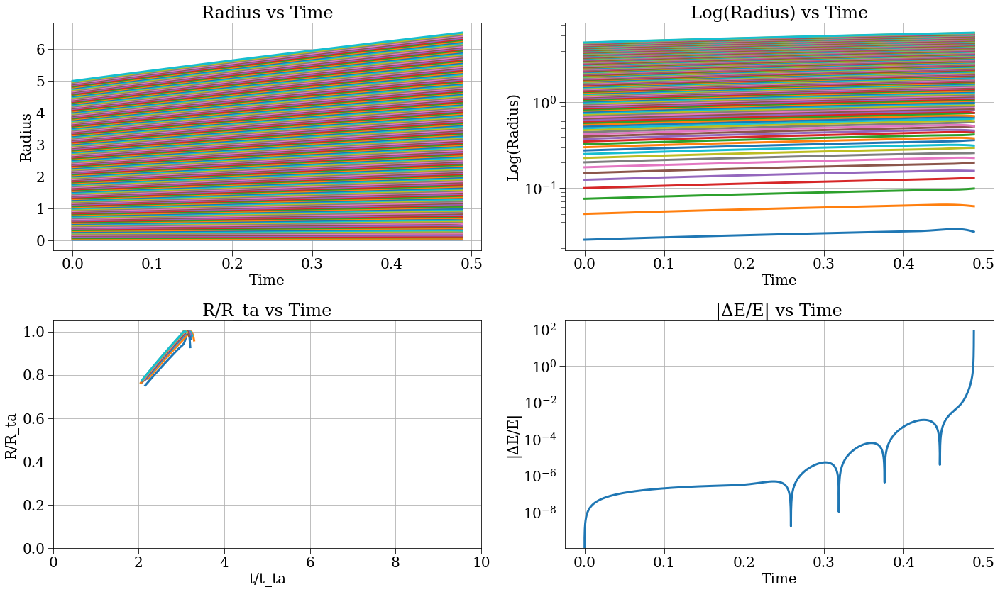

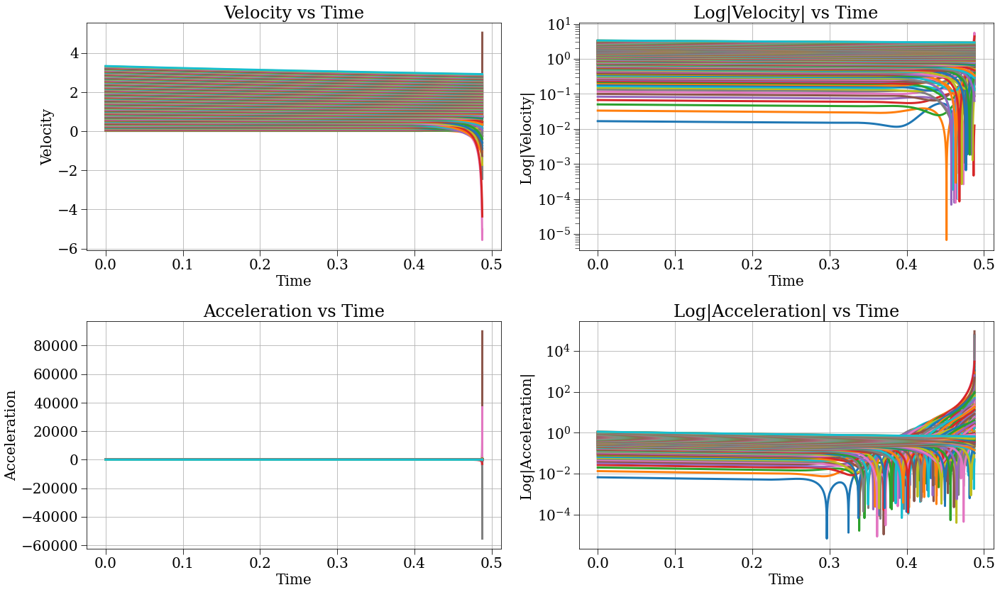

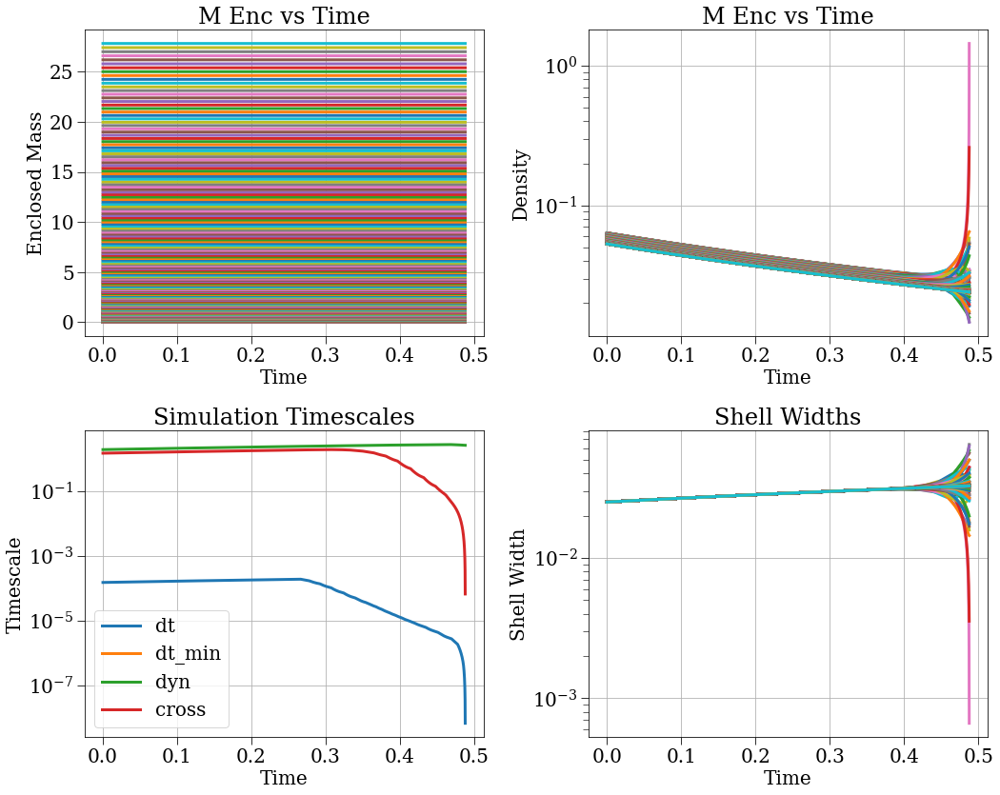

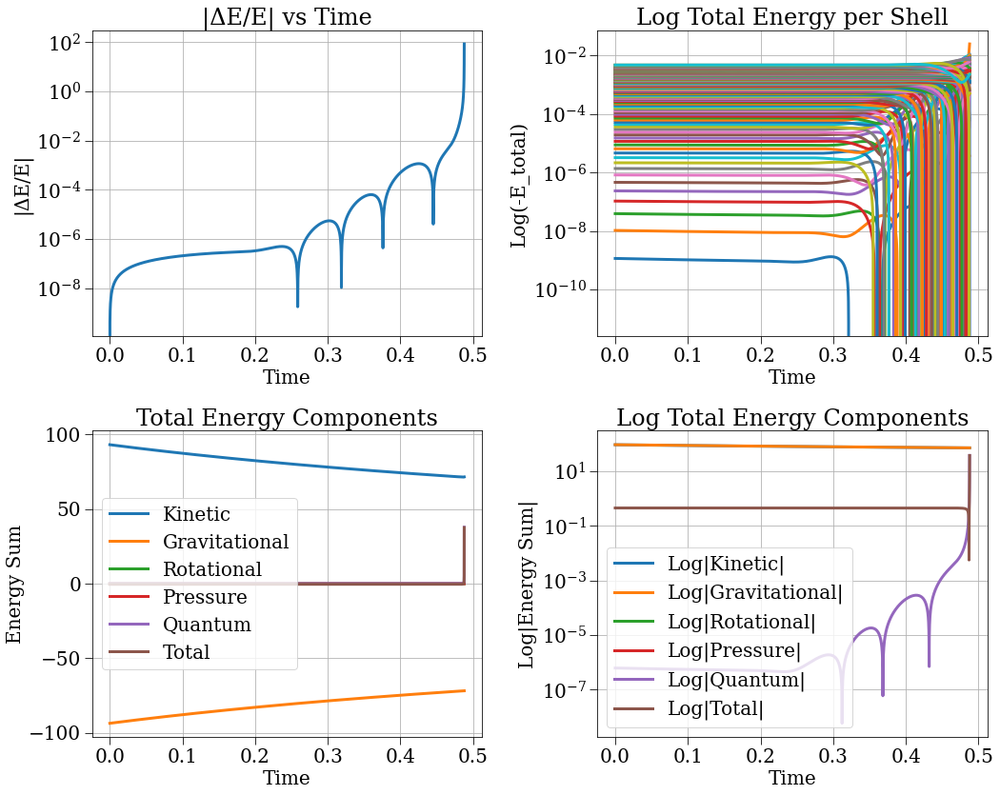

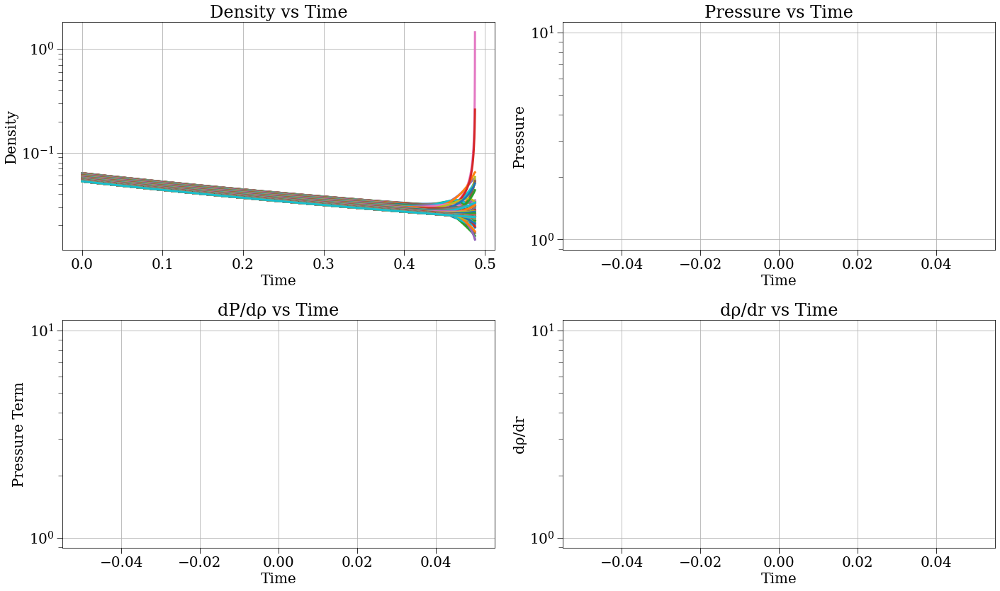

[0.025 0.05  0.075 0.1   0.125 0.15  0.175 0.2   0.225 0.25  0.275 0.3
 0.325 0.35  0.375 0.4   0.425 0.45  0.475 0.5   0.525 0.55  0.575 0.6
 0.625 0.65  0.675 0.7   0.725 0.75  0.775 0.8   0.825 0.85  0.875 0.9
 0.925 0.95  0.975 1.    1.025 1.05  1.075 1.1   1.125 1.15  1.175 1.2
 1.225 1.25  1.275 1.3   1.325 1.35  1.375 1.4   1.425 1.45  1.475 1.5
 1.525 1.55  1.575 1.6   1.625 1.65  1.675 1.7   1.725 1.75  1.775 1.8
 1.825 1.85  1.875 1.9   1.925 1.95  1.975 2.    2.025 2.05  2.075 2.1
 2.125 2.15  2.175 2.2   2.225 2.25  2.275 2.3   2.325 2.35  2.375 2.4
 2.425 2.45  2.475 2.5   2.525 2.55  2.575 2.6   2.625 2.65  2.675 2.7
 2.725 2.75  2.775 2.8   2.825 2.85  2.875 2.9   2.925 2.95  2.975 3.
 3.025 3.05  3.075 3.1   3.125 3.15  3.175 3.2   3.225 3.25  3.275 3.3
 3.325 3.35  3.375 3.4   3.425 3.45  3.475 3.5   3.525 3.55  3.575 3.6
 3.625 3.65  3.675 3.7   3.725 3.75  3.775 3.8   3.825 3.85  3.875 3.9
 3.925 3.95  3.975 4.    4.025 4.05  4.075 4.1   4.125 4.15  4.175 4.2
 4.225 

In [12]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[-11.18571209  -1.86239333   7.97251349]


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/utils.py:138: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (array(float64, 1d, A), array(float64, 1d, C))
  dy[i] = np.dot(w[:, m], ys)


Text(0, 0.5, '$-a$')

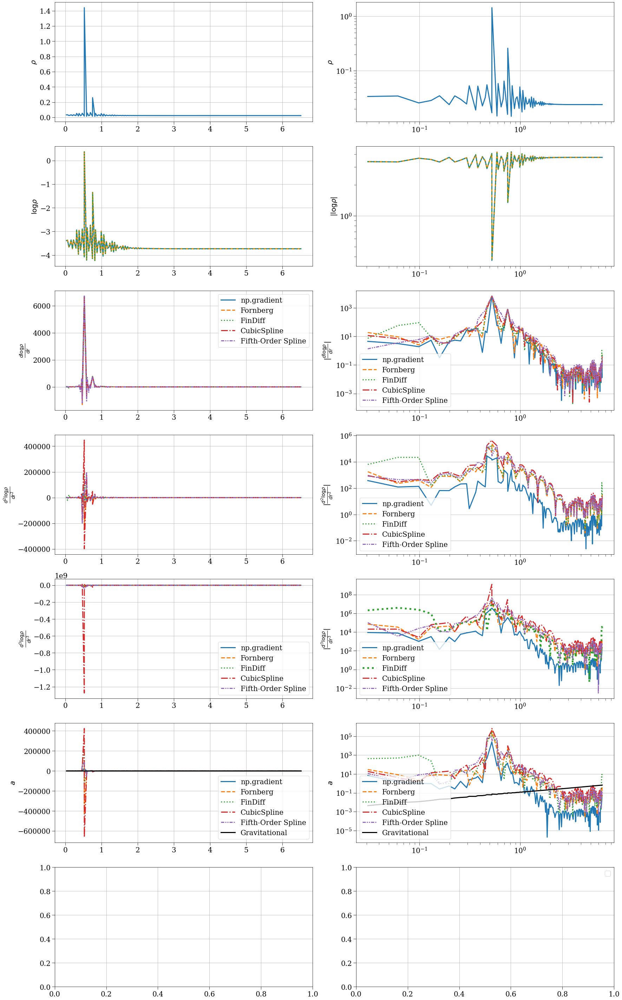

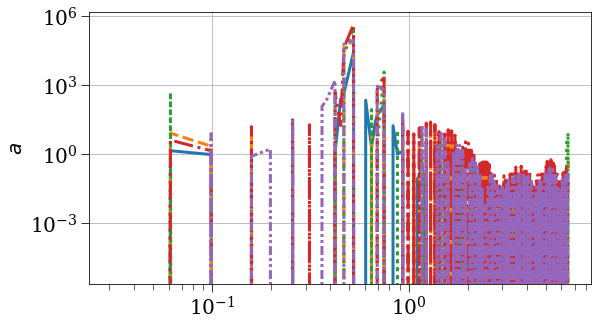

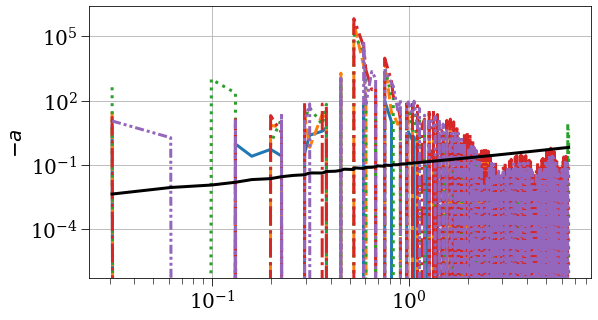

In [13]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [19]:
t_max = 51.636 # on r_half
hm2 = 1e-3
config_gauss = make_cycloid_config(N=100, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 12:53:15,919 - collapse - INFO - Simulation setup complete


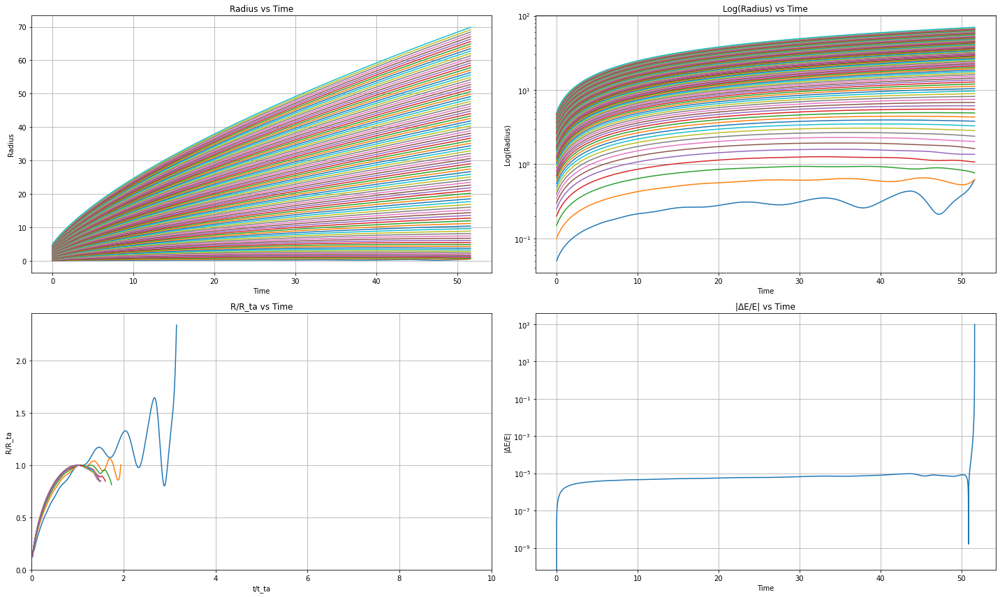

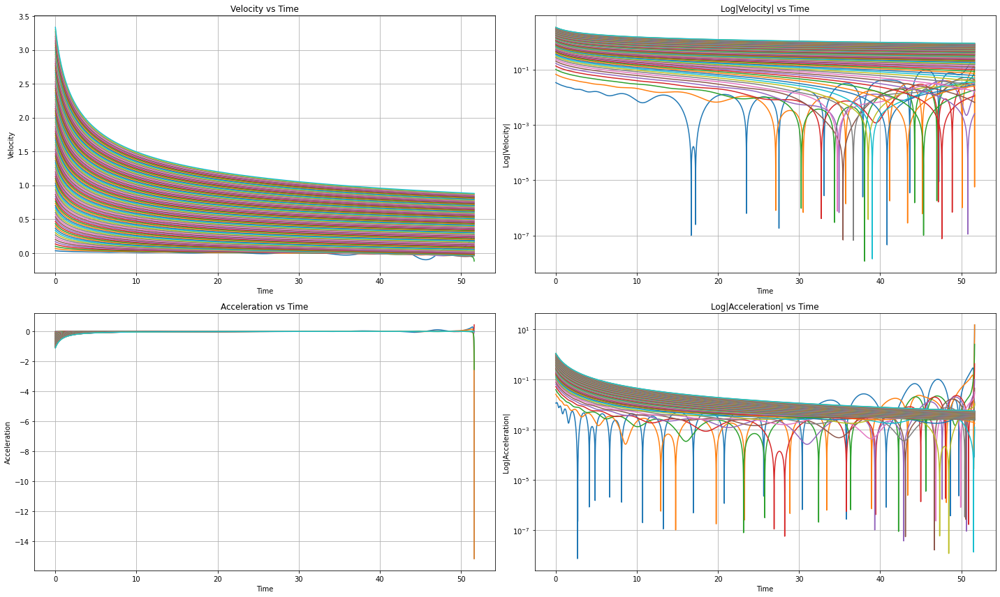

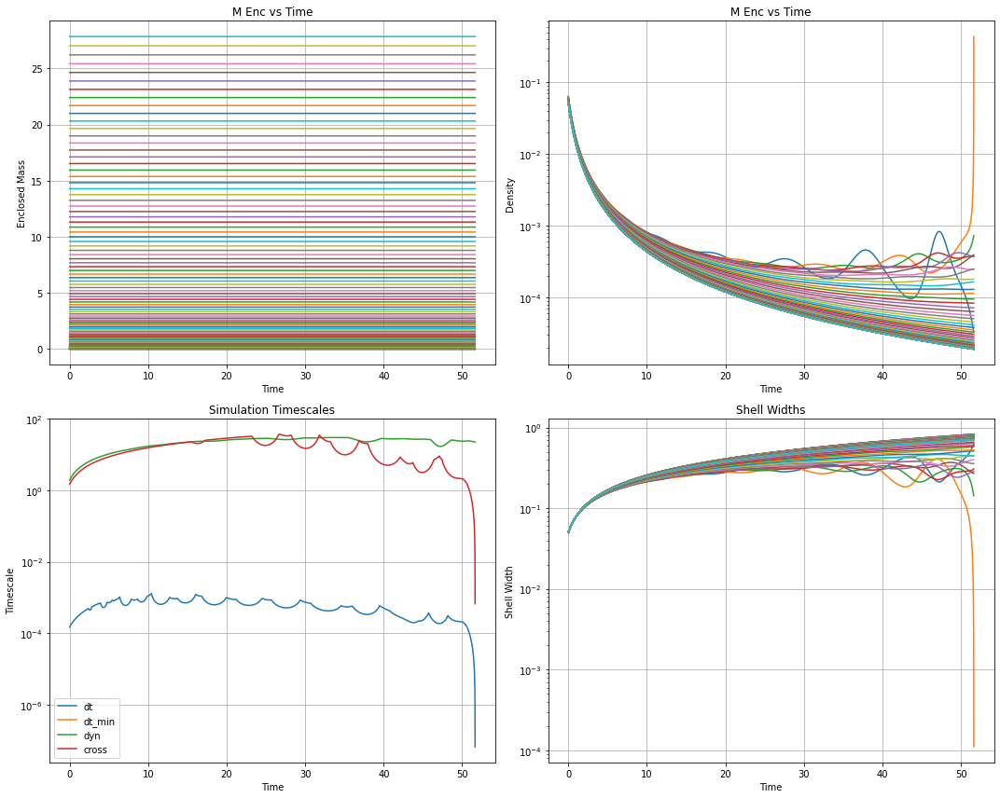

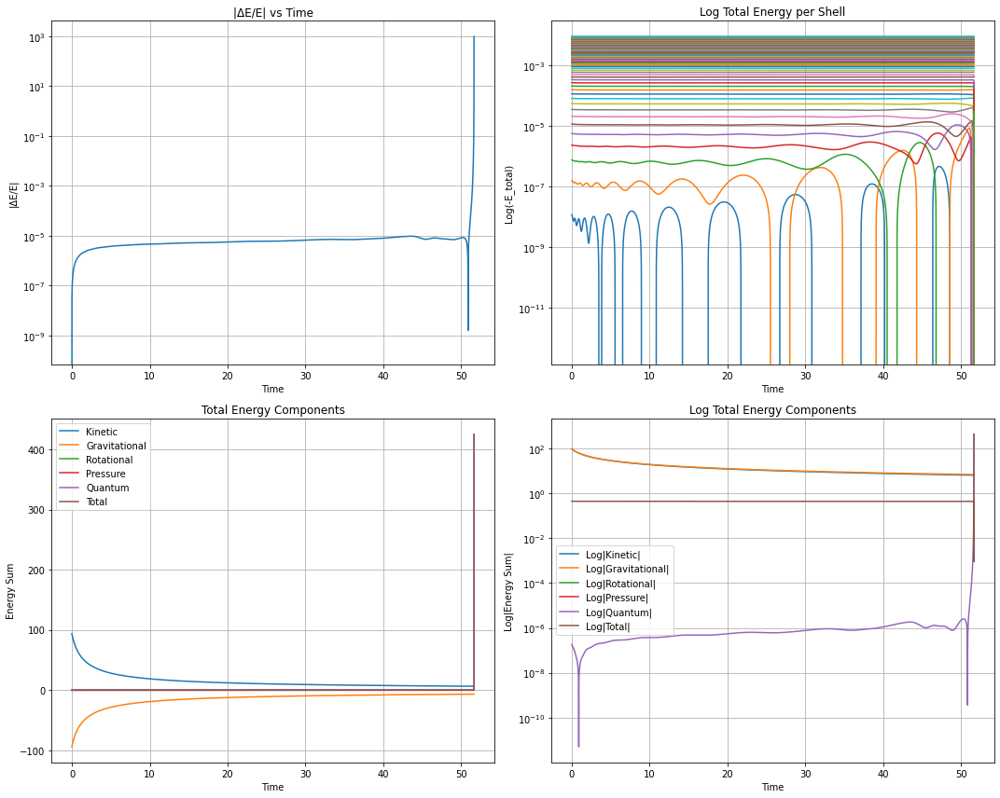

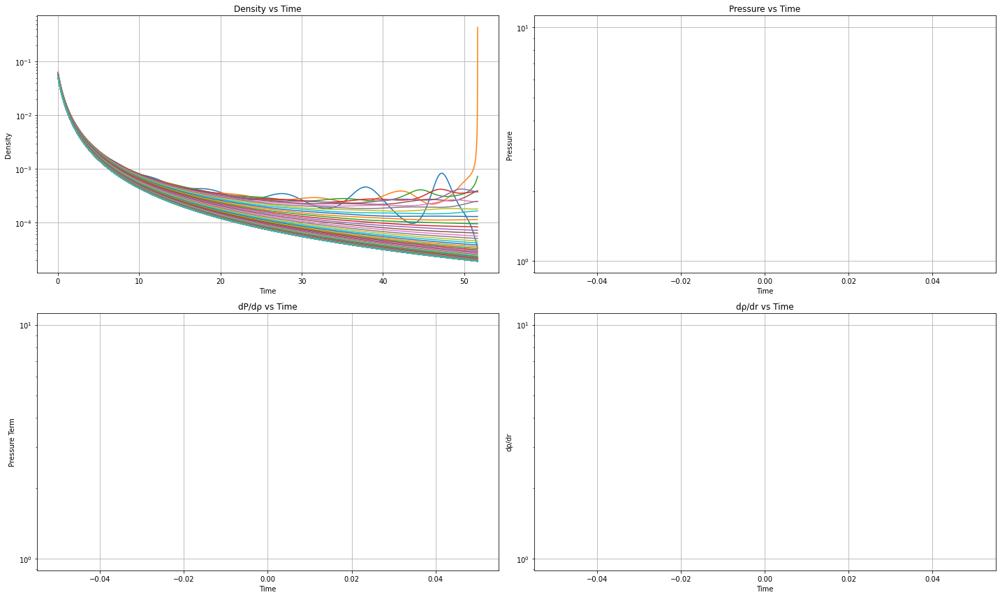

[0.05 0.1  0.15 0.2  0.25 0.3  0.35 0.4  0.45 0.5  0.55 0.6  0.65 0.7
 0.75 0.8  0.85 0.9  0.95 1.   1.05 1.1  1.15 1.2  1.25 1.3  1.35 1.4
 1.45 1.5  1.55 1.6  1.65 1.7  1.75 1.8  1.85 1.9  1.95 2.   2.05 2.1
 2.15 2.2  2.25 2.3  2.35 2.4  2.45 2.5  2.55 2.6  2.65 2.7  2.75 2.8
 2.85 2.9  2.95 3.   3.05 3.1  3.15 3.2  3.25 3.3  3.35 3.4  3.45 3.5
 3.55 3.6  3.65 3.7  3.75 3.8  3.85 3.9  3.95 4.   4.05 4.1  4.15 4.2
 4.25 4.3  4.35 4.4  4.45 4.5  4.55 4.6  4.65 4.7  4.75 4.8  4.85 4.9
 4.95 5.  ]


In [20]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[-15.15564978 -15.16486093  -2.54894725]


Text(0, 0.5, '$-a$')

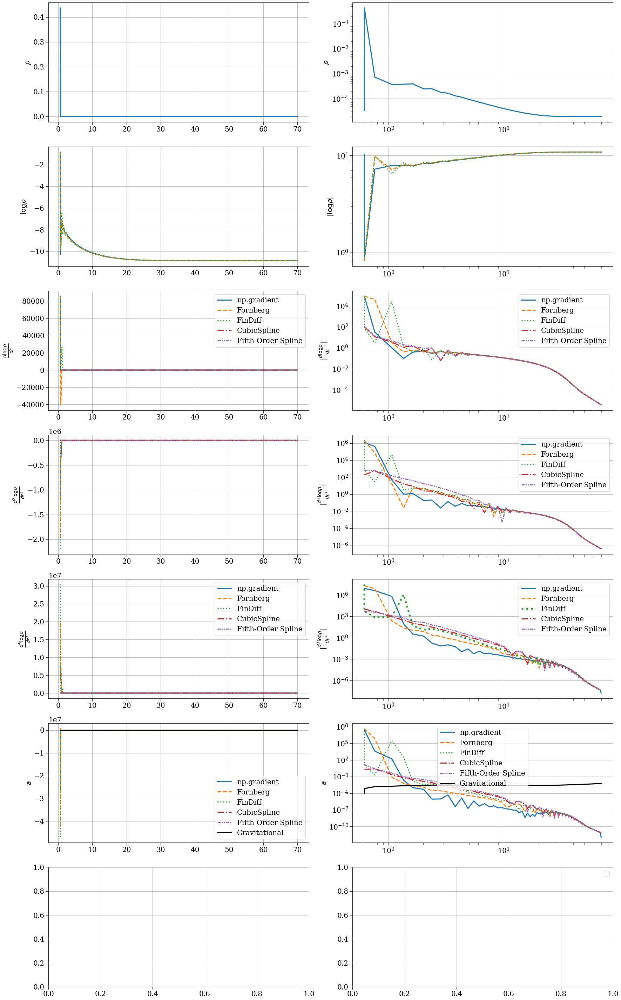

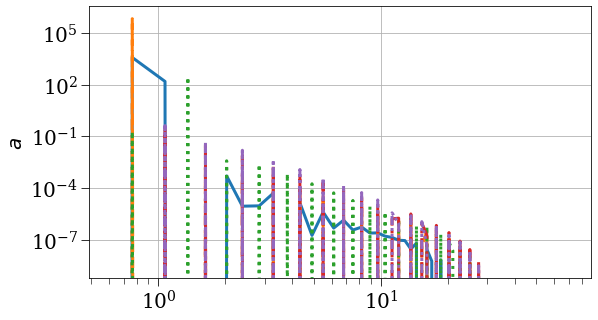

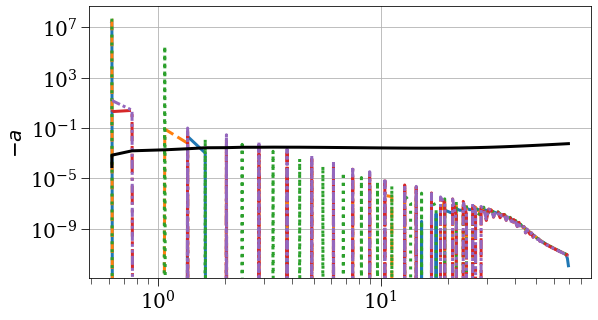

In [23]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])
r_halfs = np.zeros_like(r0)
r_halfs[0] = r0[0]/2
r_halfs[1:] = (r0[1:] + r0[:-1])/2

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r_halfs, log0)
fs = splrep(r_halfs, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

2025-05-01 12:21:37,945 - collapse - INFO - Simulation setup complete


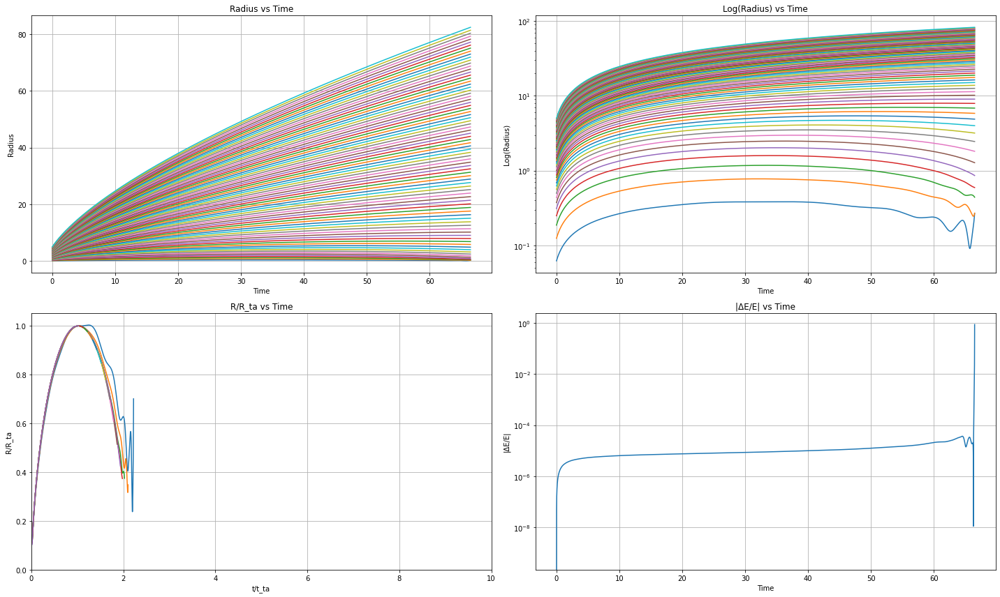

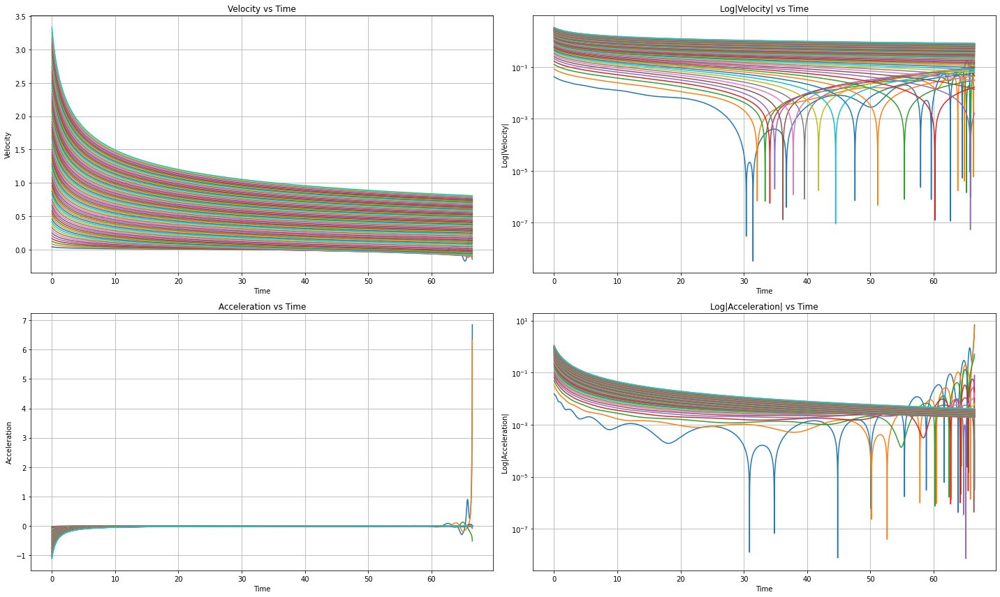

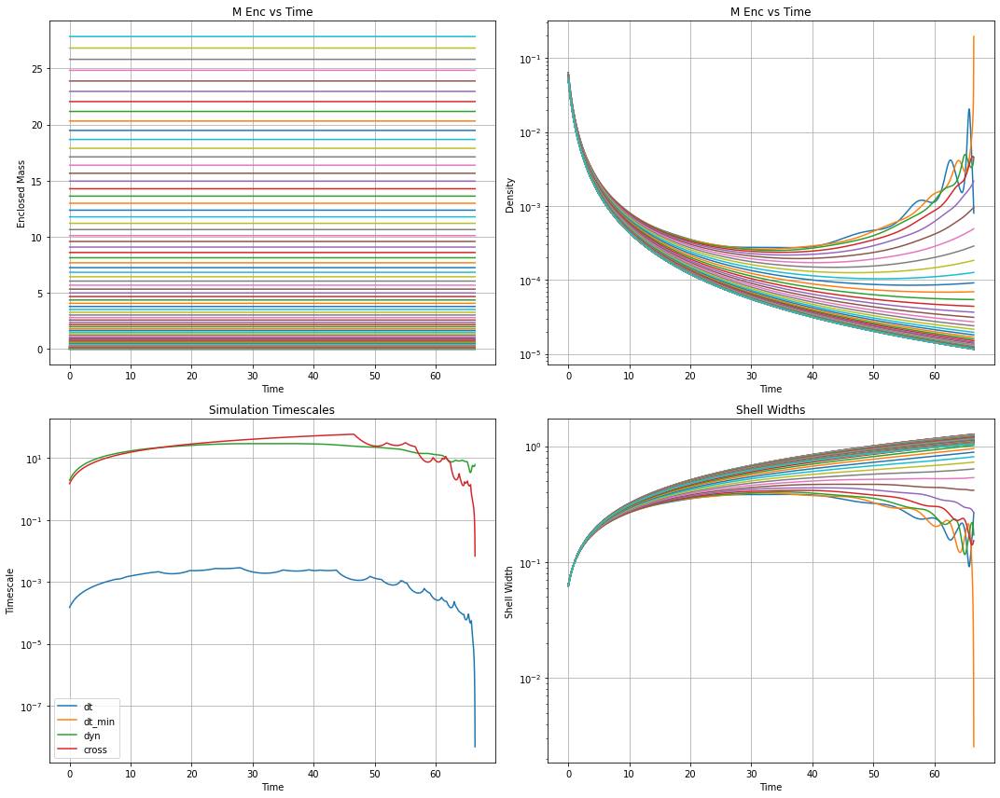

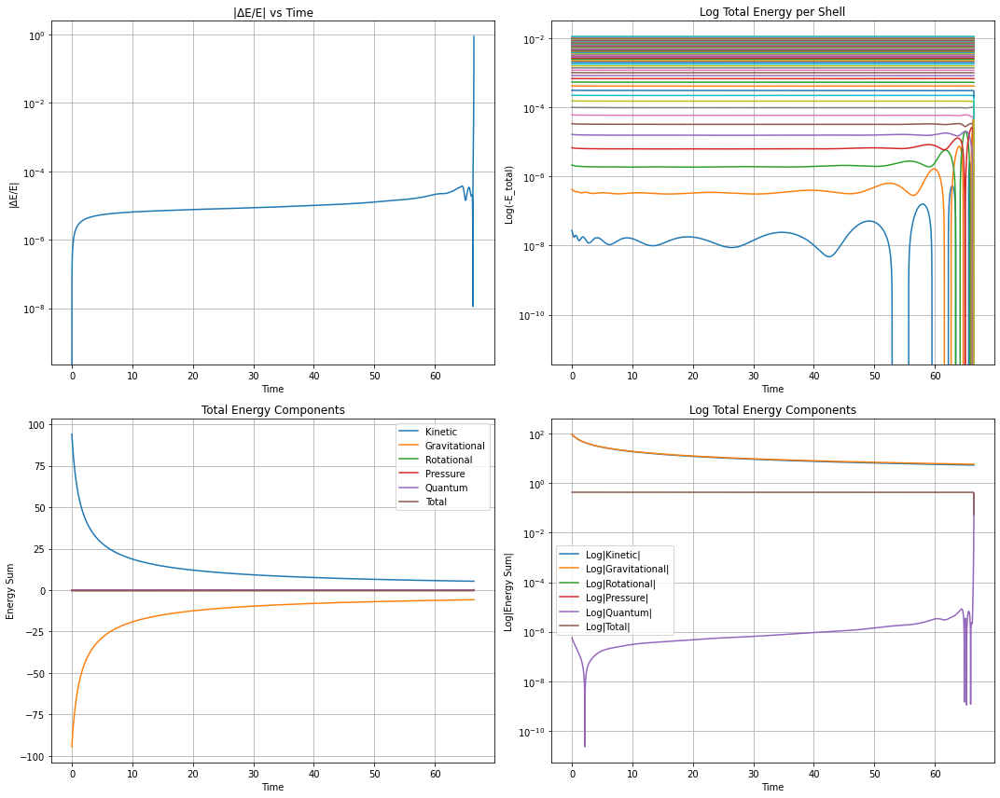

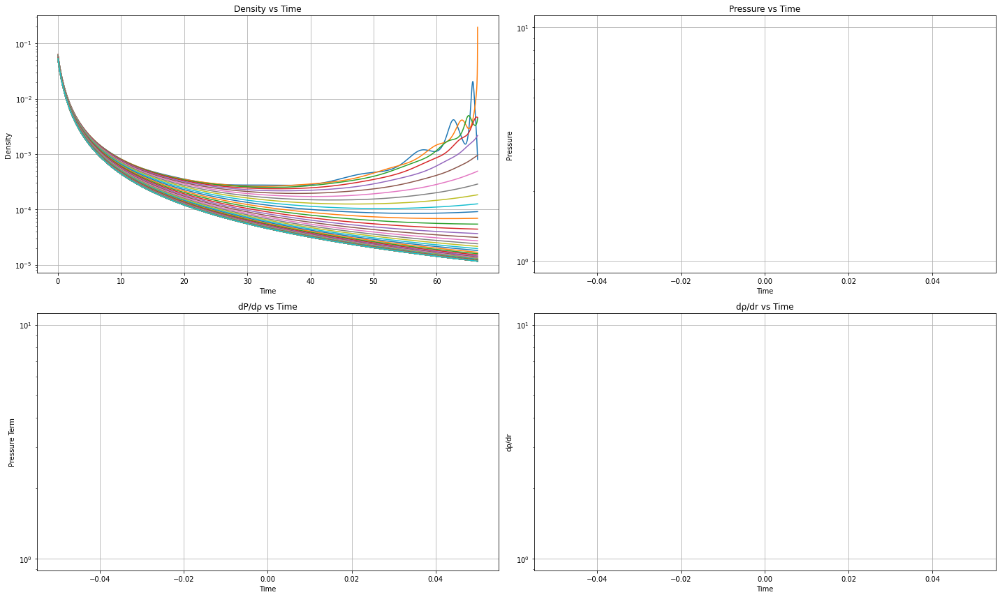

[0.0625 0.125  0.1875 0.25   0.3125 0.375  0.4375 0.5    0.5625 0.625
 0.6875 0.75   0.8125 0.875  0.9375 1.     1.0625 1.125  1.1875 1.25
 1.3125 1.375  1.4375 1.5    1.5625 1.625  1.6875 1.75   1.8125 1.875
 1.9375 2.     2.0625 2.125  2.1875 2.25   2.3125 2.375  2.4375 2.5
 2.5625 2.625  2.6875 2.75   2.8125 2.875  2.9375 3.     3.0625 3.125
 3.1875 3.25   3.3125 3.375  3.4375 3.5    3.5625 3.625  3.6875 3.75
 3.8125 3.875  3.9375 4.     4.0625 4.125  4.1875 4.25   4.3125 4.375
 4.4375 4.5    4.5625 4.625  4.6875 4.75   4.8125 4.875  4.9375 5.    ]


In [6]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [3]:
t_max = 74.978 # on r_half
hm2 = 1e-3
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa_cross2', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 10:26:46,563 - collapse - INFO - Simulation setup complete


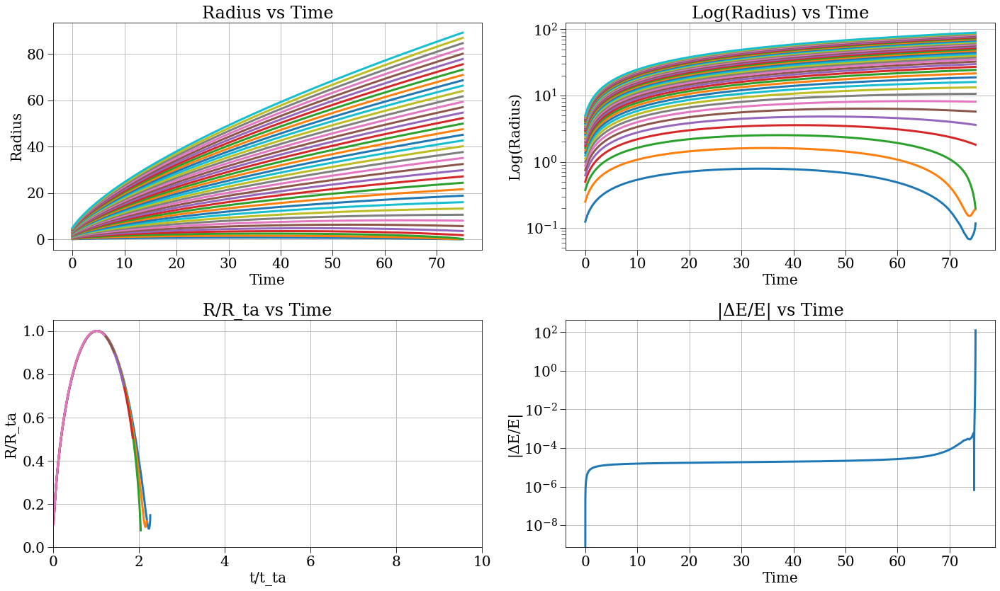

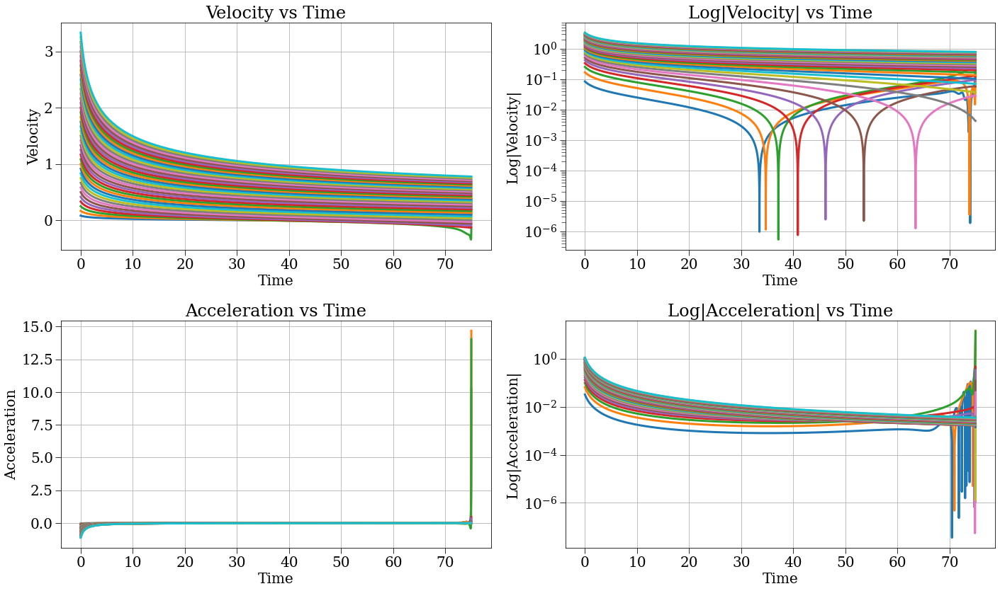

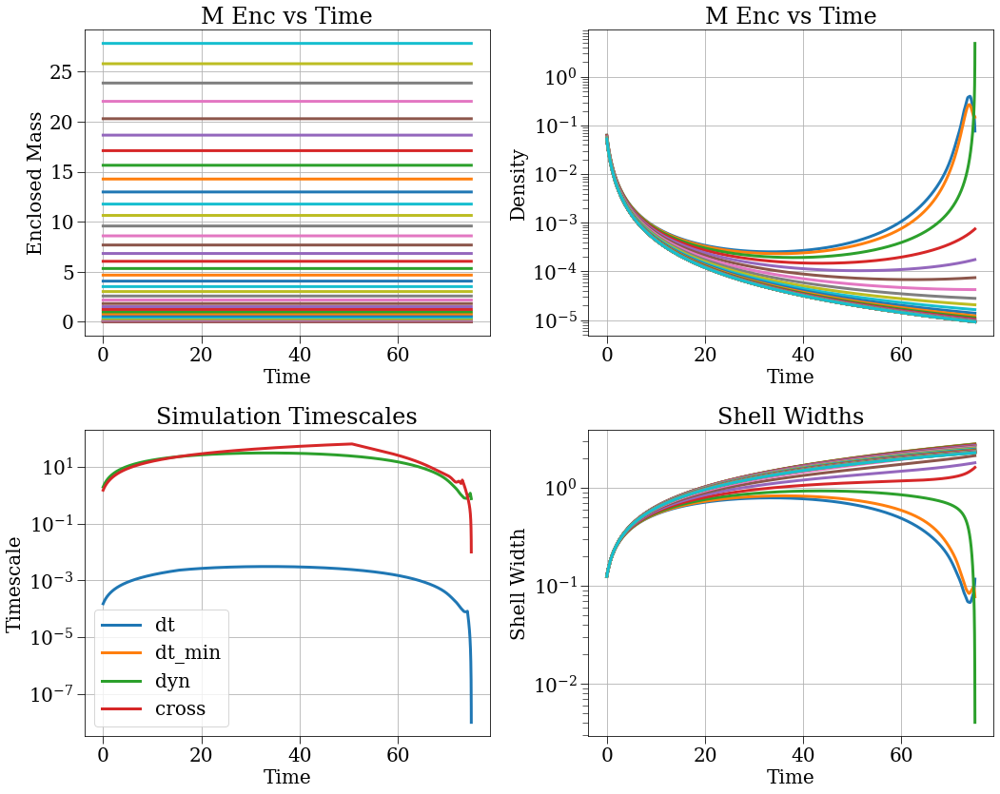

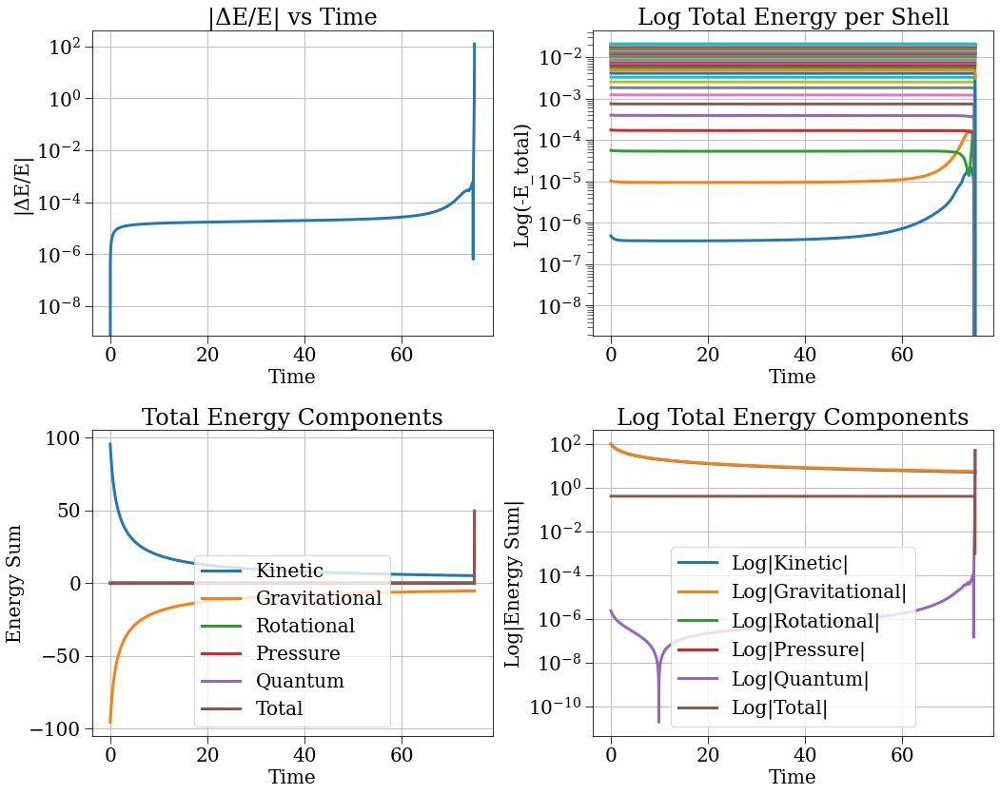

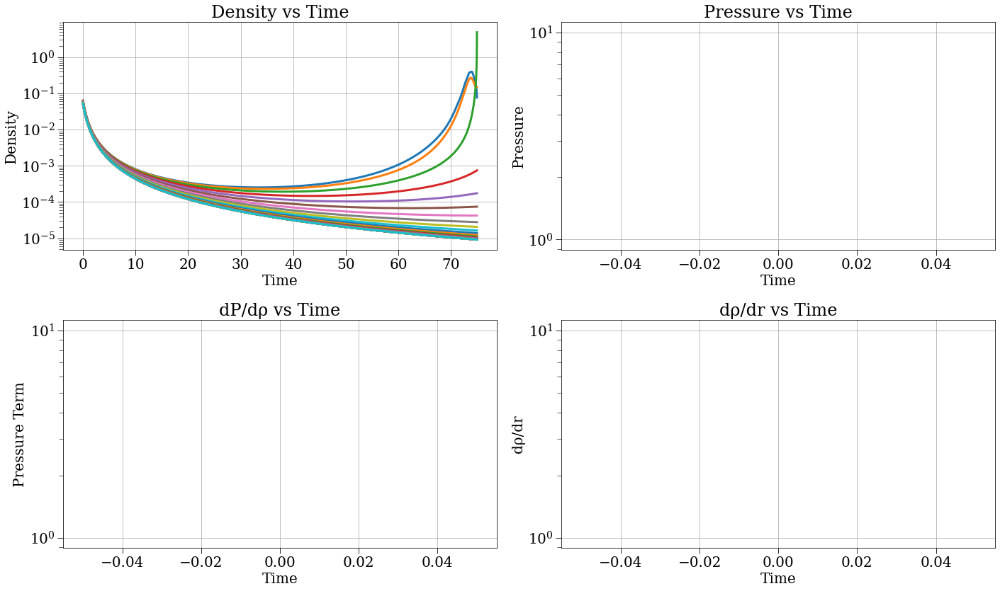

[0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.    1.125 1.25  1.375 1.5
 1.625 1.75  1.875 2.    2.125 2.25  2.375 2.5   2.625 2.75  2.875 3.
 3.125 3.25  3.375 3.5   3.625 3.75  3.875 4.    4.125 4.25  4.375 4.5
 4.625 4.75  4.875 5.   ]


In [4]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[10.24589198 14.67292763 14.0247672 ]


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/utils.py:138: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (array(float64, 1d, A), array(float64, 1d, C))
  dy[i] = np.dot(w[:, m], ys)


Text(0, 0.5, '$-a$')

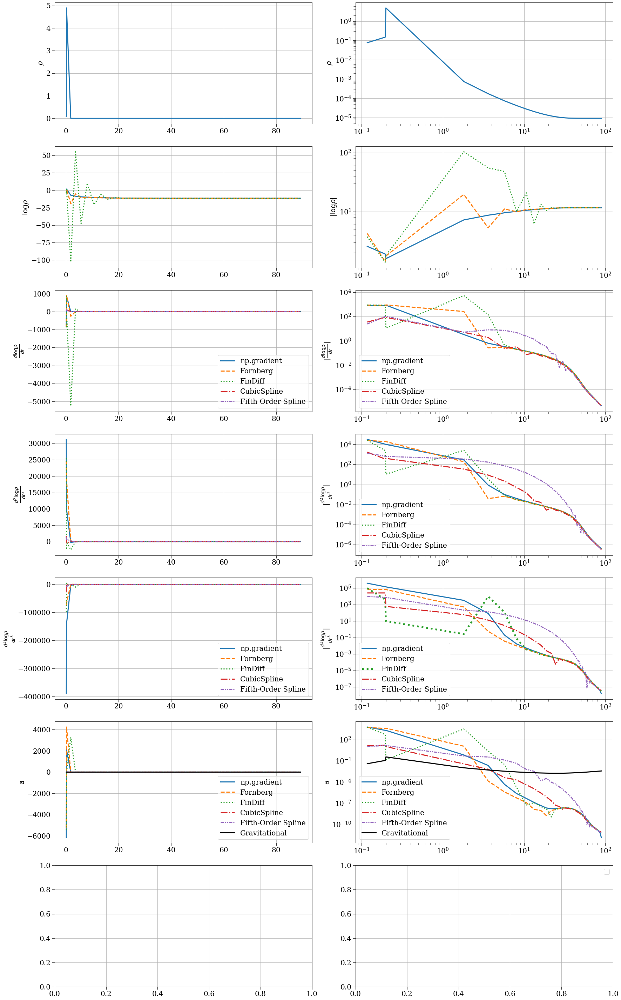

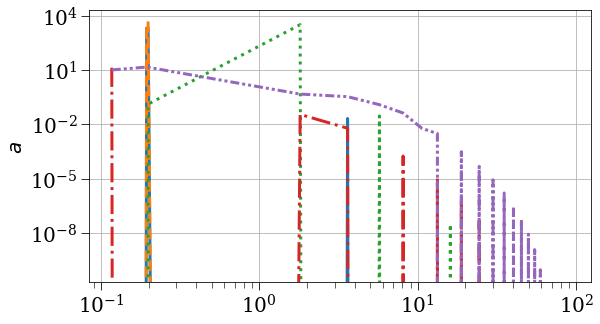

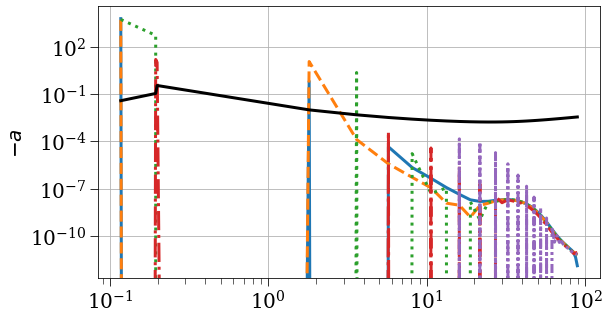

In [5]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])
r_halfs = np.zeros_like(r0)
r_halfs[0] = r0[0]/2
r_halfs[1:] = (r0[1:] + r0[:-1])/2

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r_halfs, log0)
fs = splrep(r_halfs, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [8]:
t_max = 74.978 # on r_half
hm2 = 1e-3
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

In [9]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

2025-05-01 10:53:27,129 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

## N=40

In [32]:
t_max = 14.08 # on r_half
hm2 = 1e-1
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 13:55:55,222 - collapse - INFO - Simulation setup complete


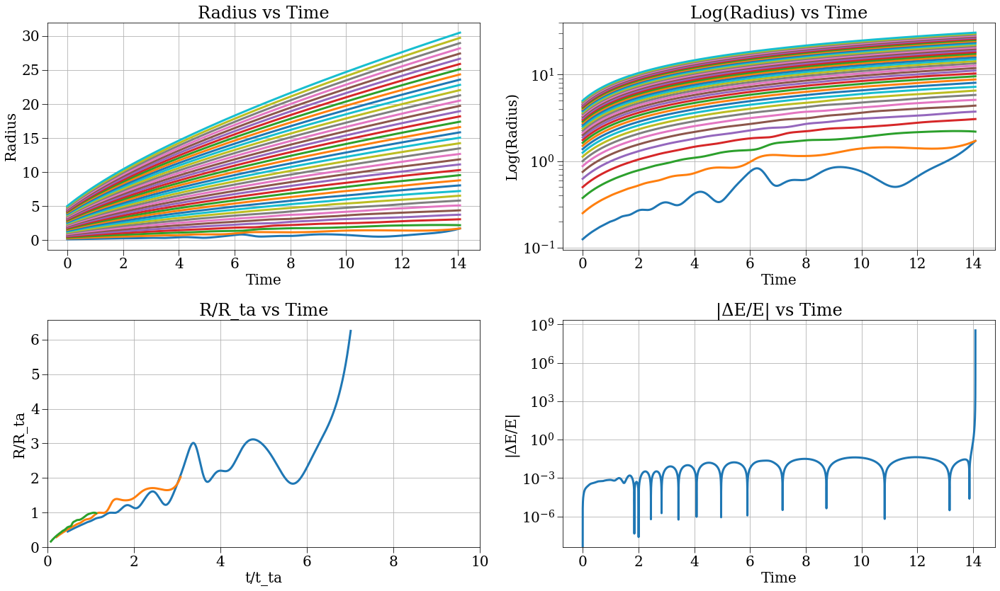

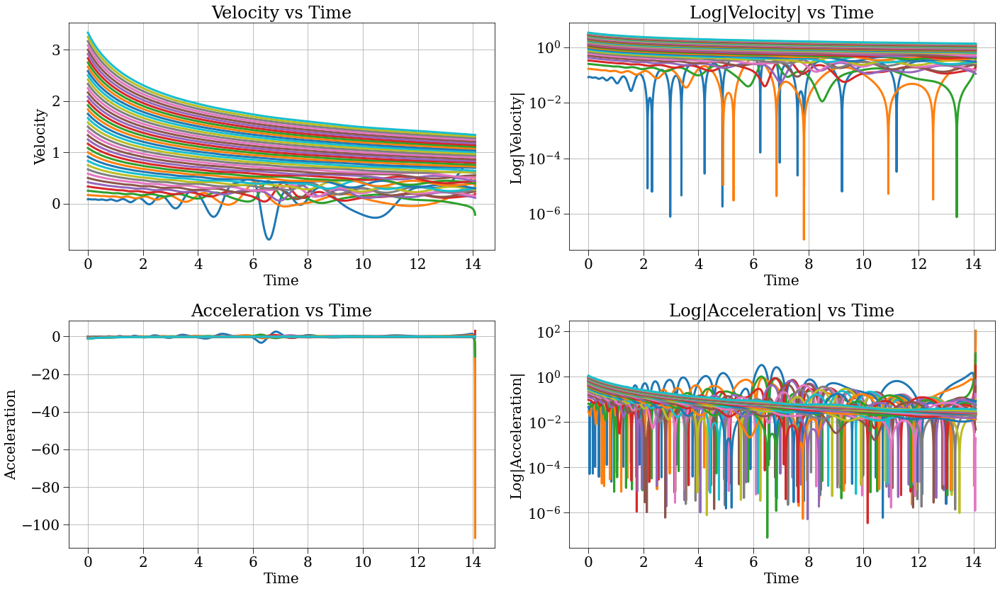

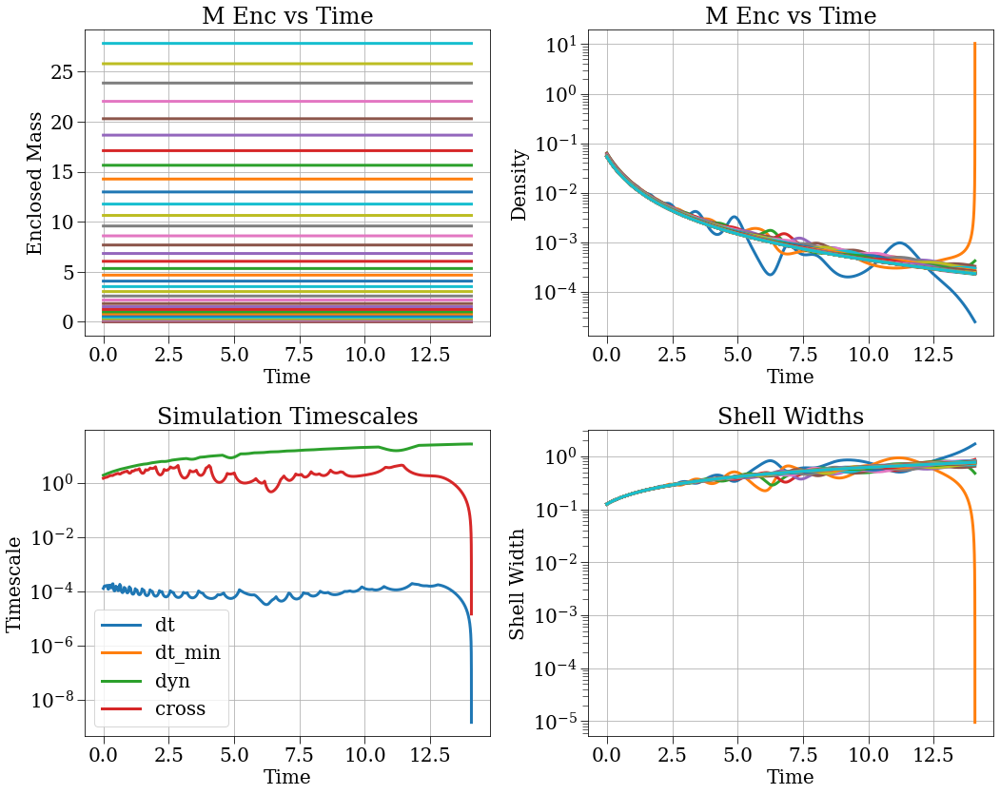

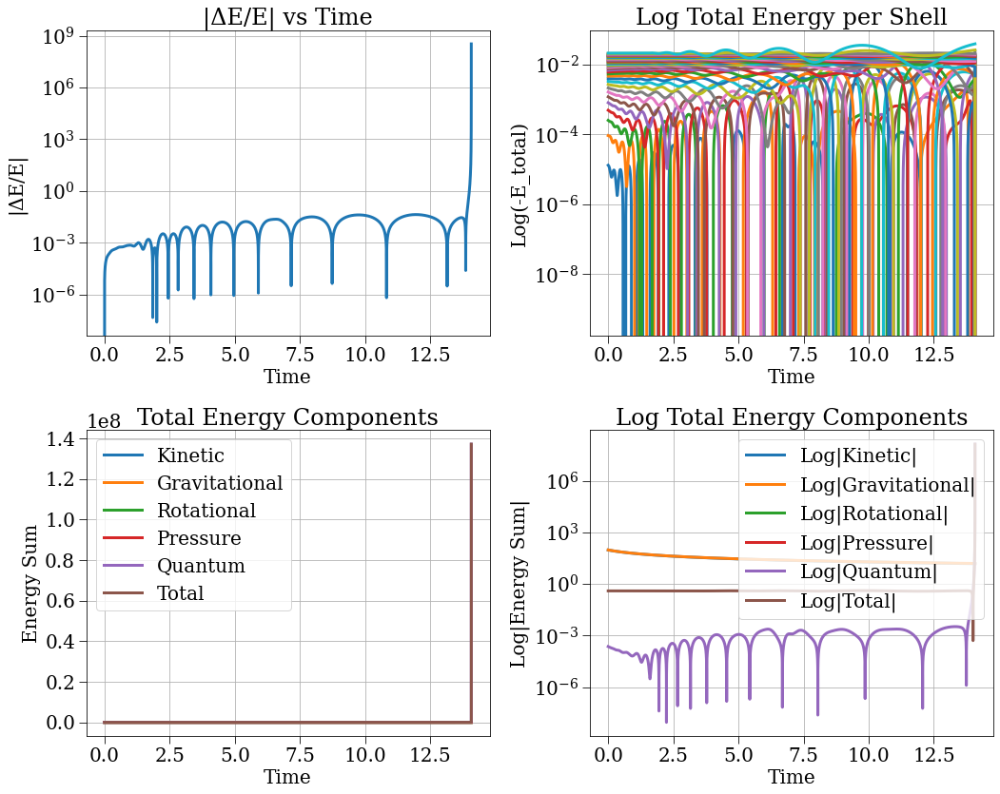

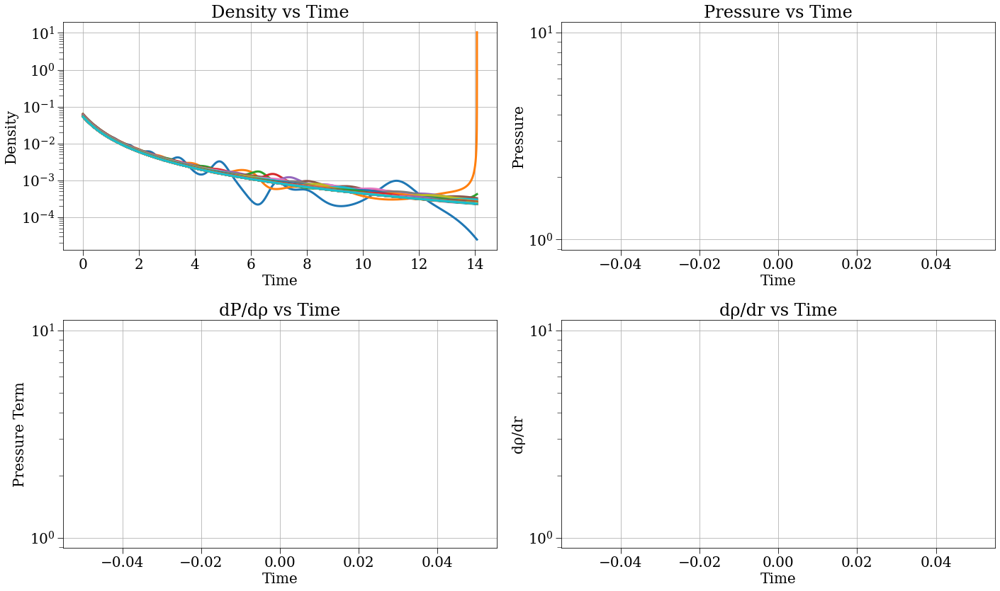

[0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.    1.125 1.25  1.375 1.5
 1.625 1.75  1.875 2.    2.125 2.25  2.375 2.5   2.625 2.75  2.875 3.
 3.125 3.25  3.375 3.5   3.625 3.75  3.875 4.    4.125 4.25  4.375 4.5
 4.625 4.75  4.875 5.   ]


In [33]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [26]:
t_max = 10 # on r_half
hm2 = 1e-1
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa_cross2', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 13:46:56,794 - collapse - INFO - Simulation setup complete


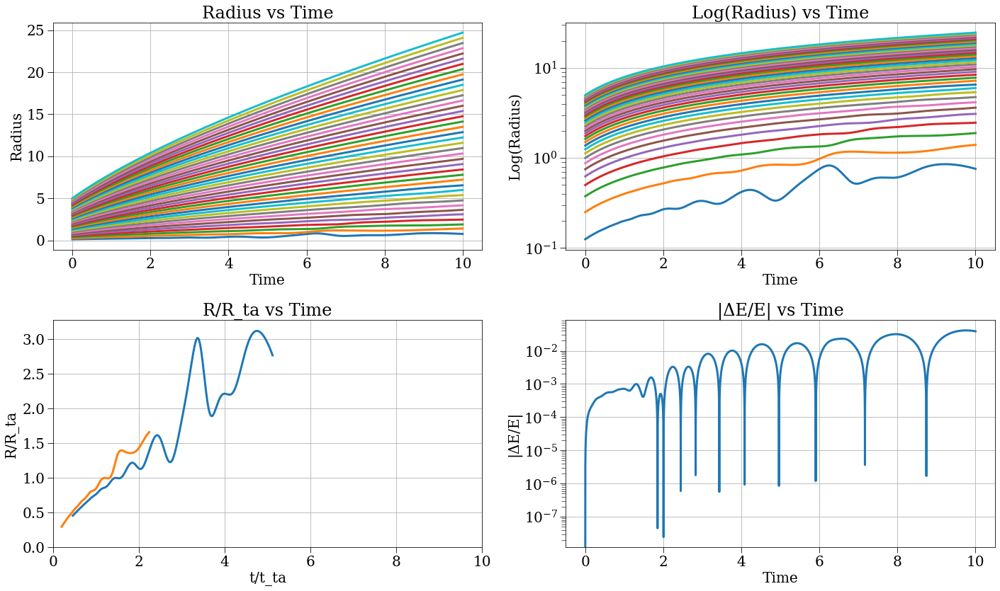

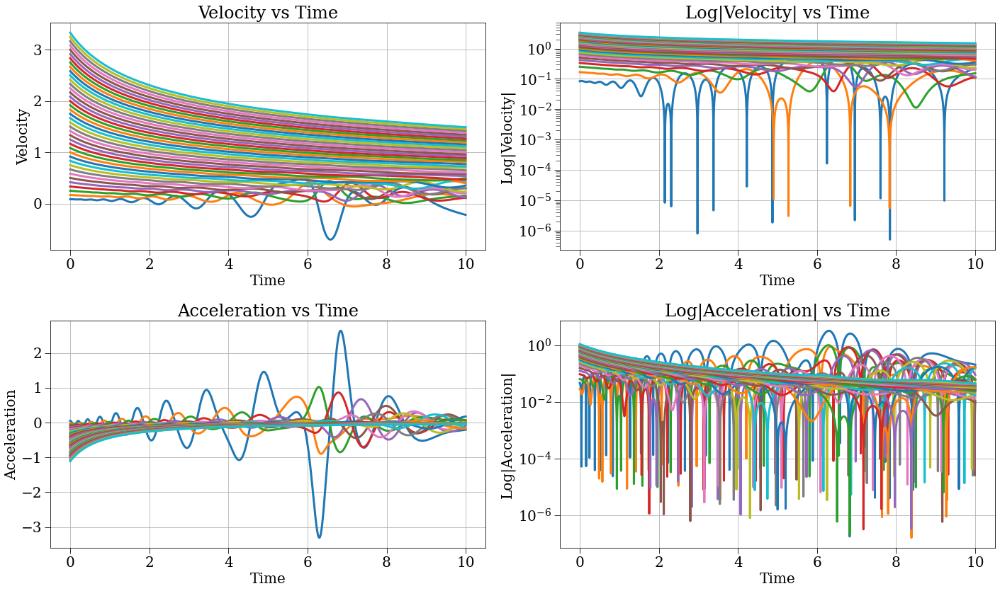

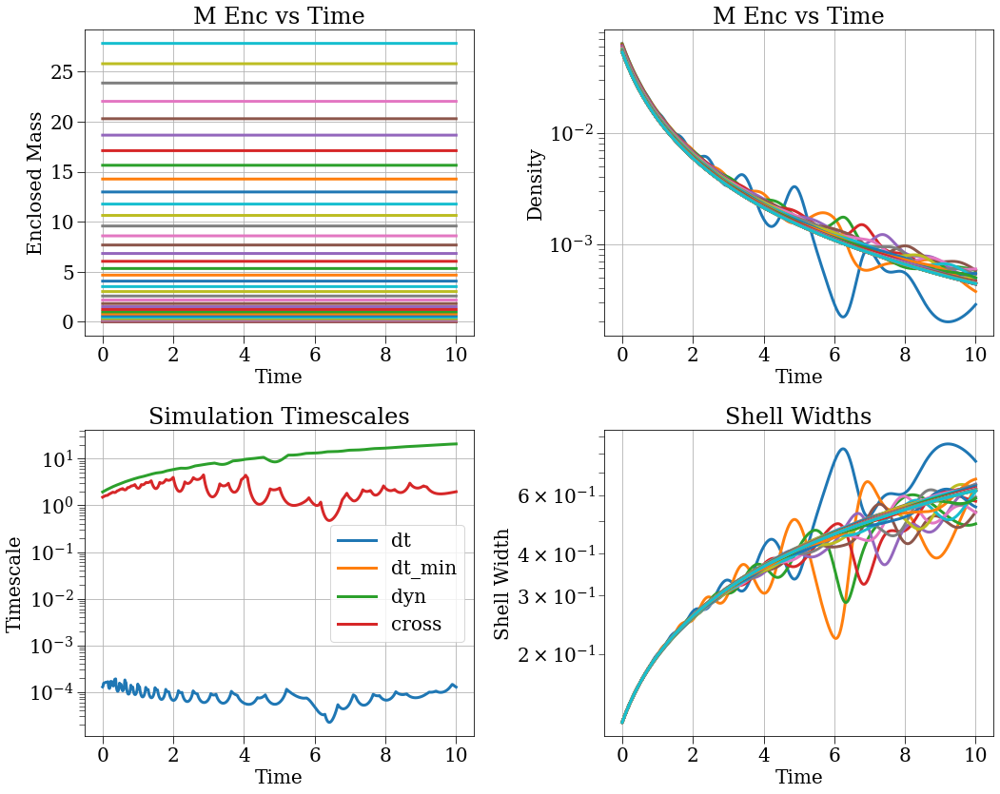

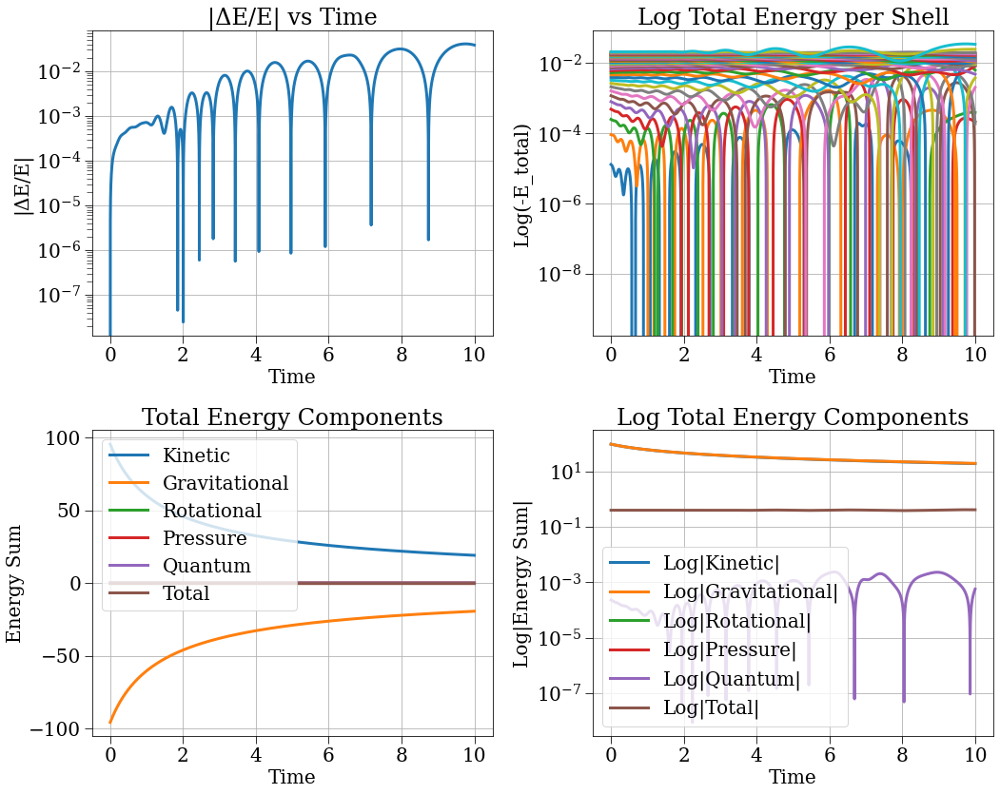

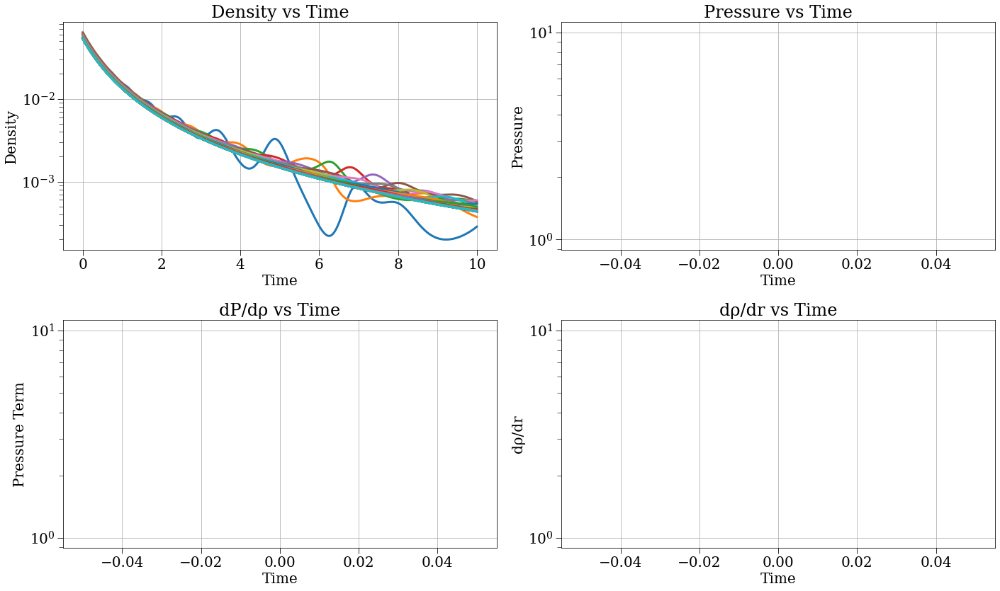

[0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.    1.125 1.25  1.375 1.5
 1.625 1.75  1.875 2.    2.125 2.25  2.375 2.5   2.625 2.75  2.875 3.
 3.125 3.25  3.375 3.5   3.625 3.75  3.875 4.    4.125 4.25  4.375 4.5
 4.625 4.75  4.875 5.   ]


In [27]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [15]:
t_max = 1169 # on r_half, cubic spline
hm2 = 1
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa_cross2', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2, irs='equal_mass')

In [16]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

2025-05-02 18:57:37,966 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

In [16]:
t_max = 74.978 # on r_half
hm2 = 1e-3
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa_cross2', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 03:31:04,874 - collapse - INFO - Simulation setup complete


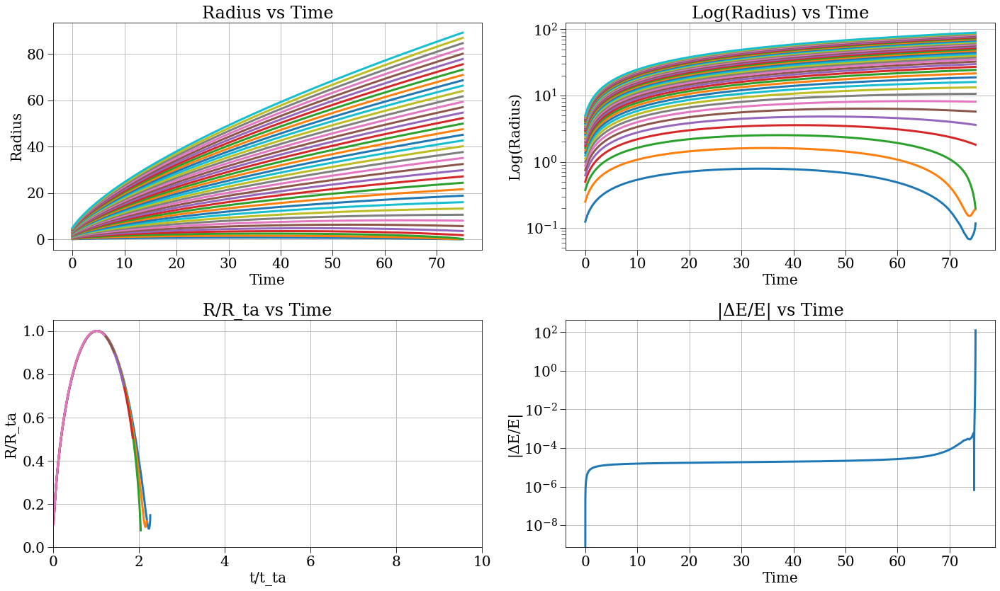

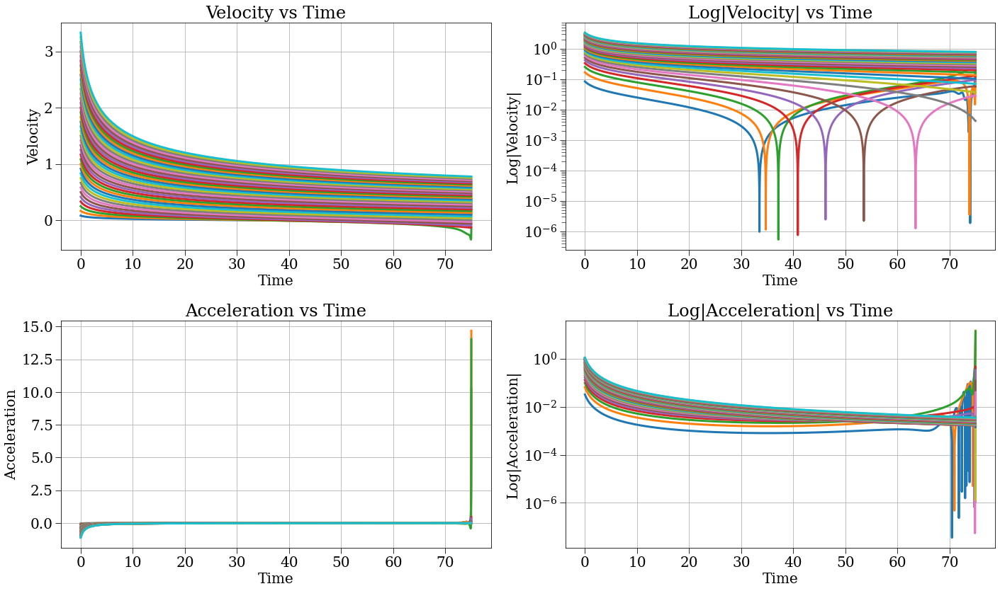

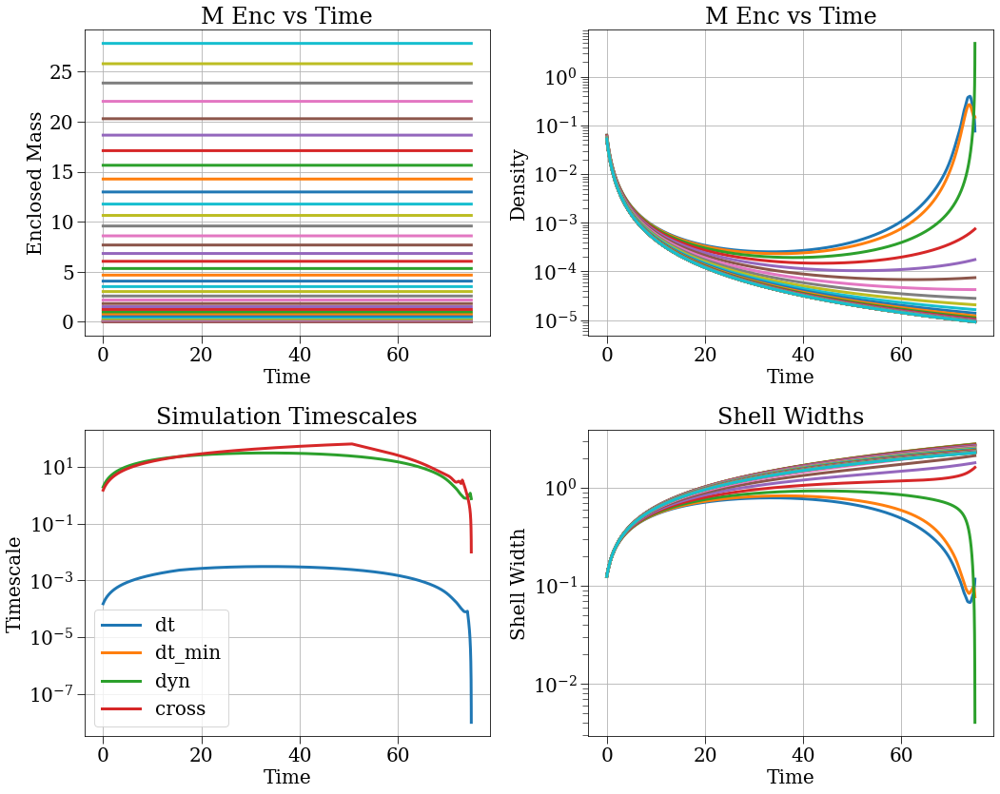

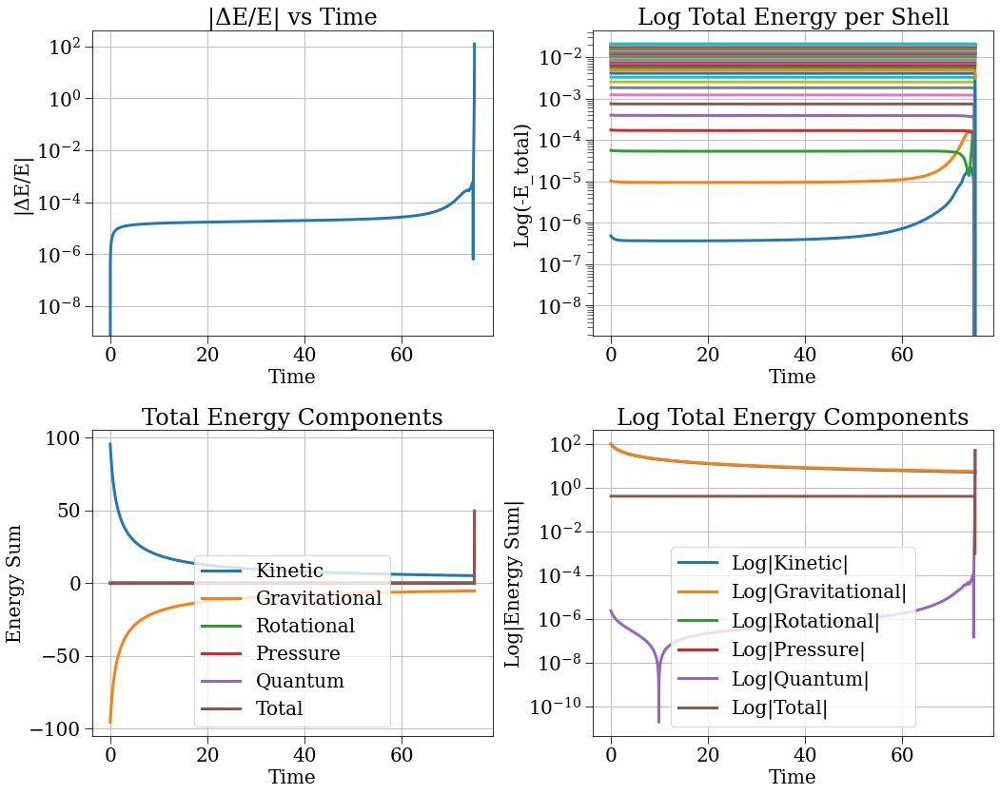

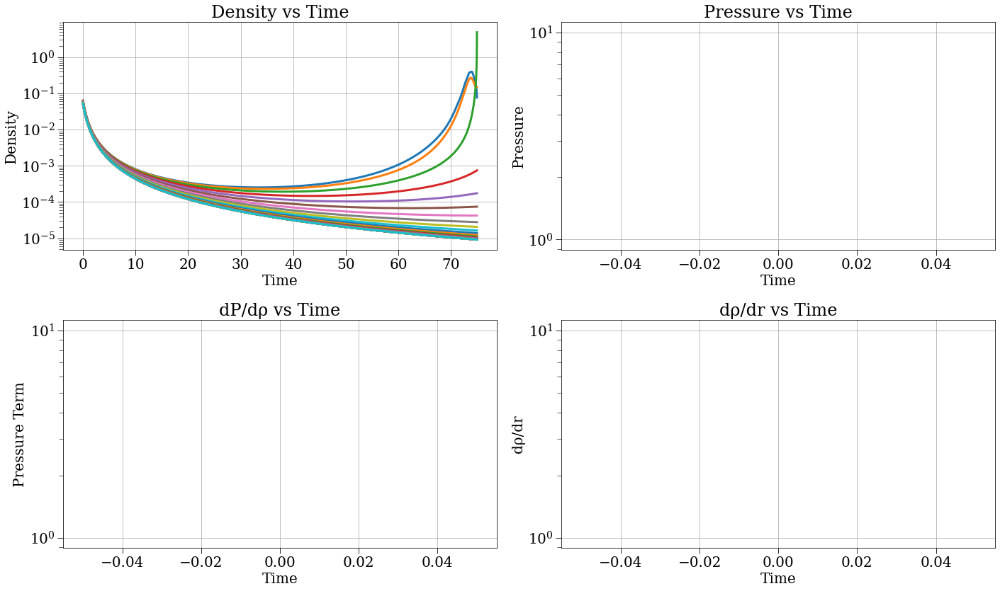

[0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.    1.125 1.25  1.375 1.5
 1.625 1.75  1.875 2.    2.125 2.25  2.375 2.5   2.625 2.75  2.875 3.
 3.125 3.25  3.375 3.5   3.625 3.75  3.875 4.    4.125 4.25  4.375 4.5
 4.625 4.75  4.875 5.   ]


In [17]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[10.24589198 14.67292763 14.0247672 ]


Text(0, 0.5, '$-a$')

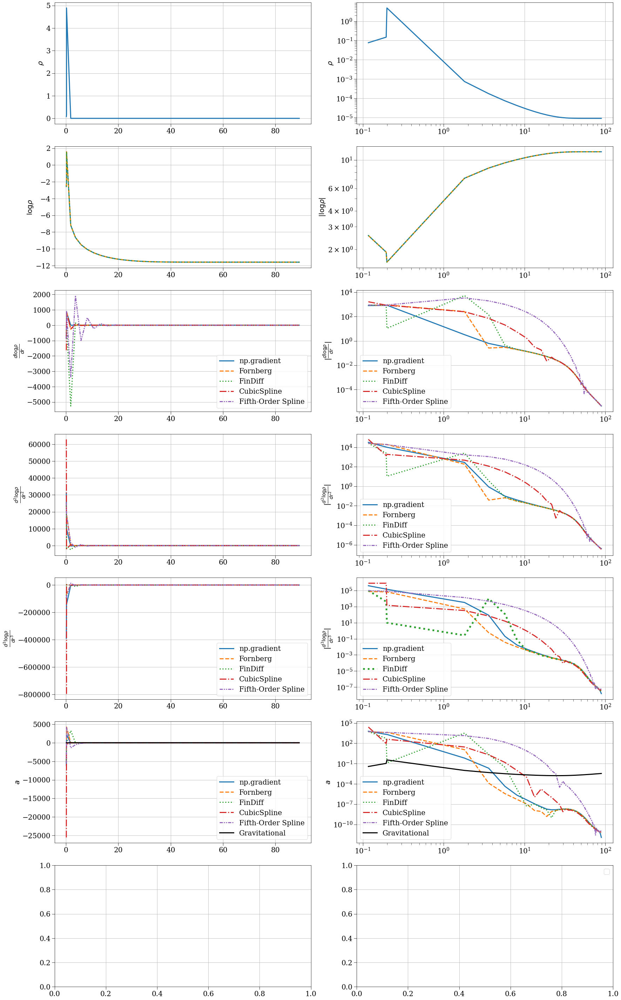

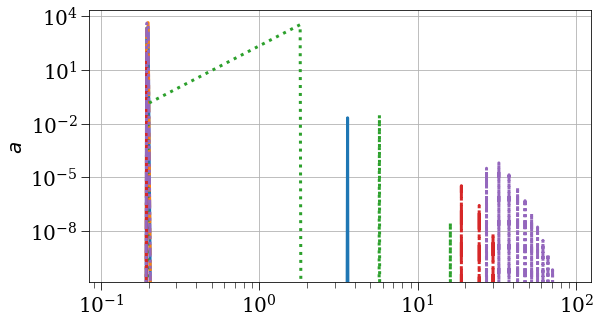

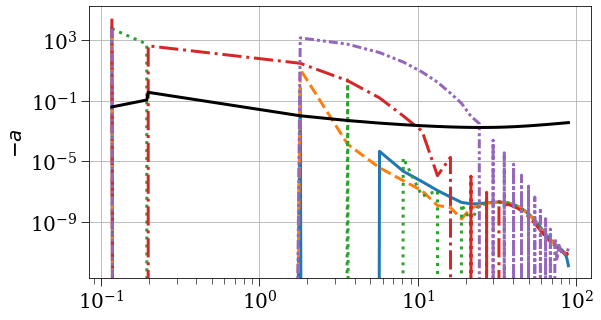

In [18]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [7]:
t_max = 70.795
hm2 = 1e-3
config_gauss = make_cycloid_config(N=40, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_crossa', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=hm2)#irs='equal_mass')

2025-05-01 02:40:26,632 - collapse - INFO - Simulation setup complete


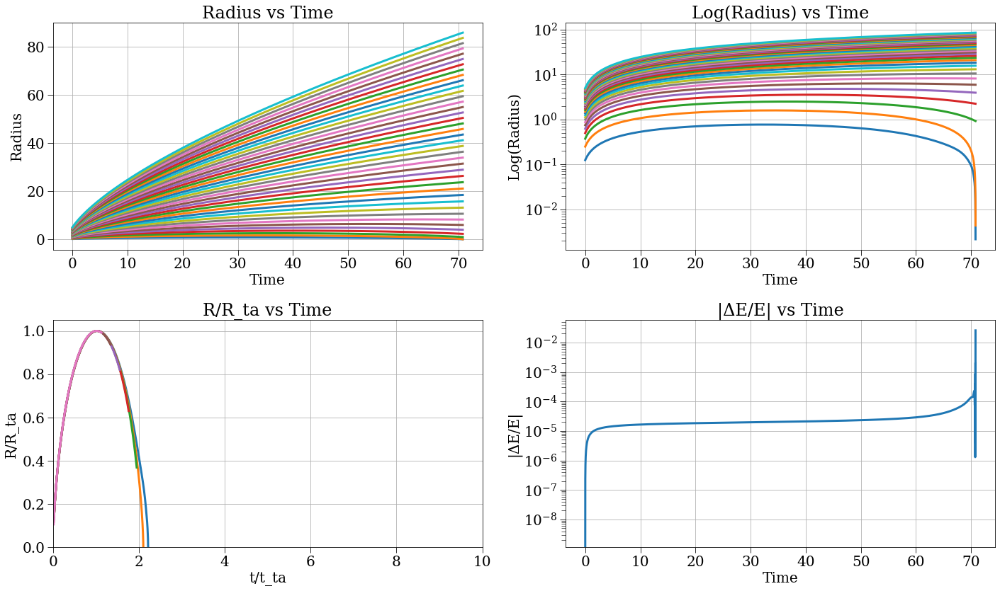

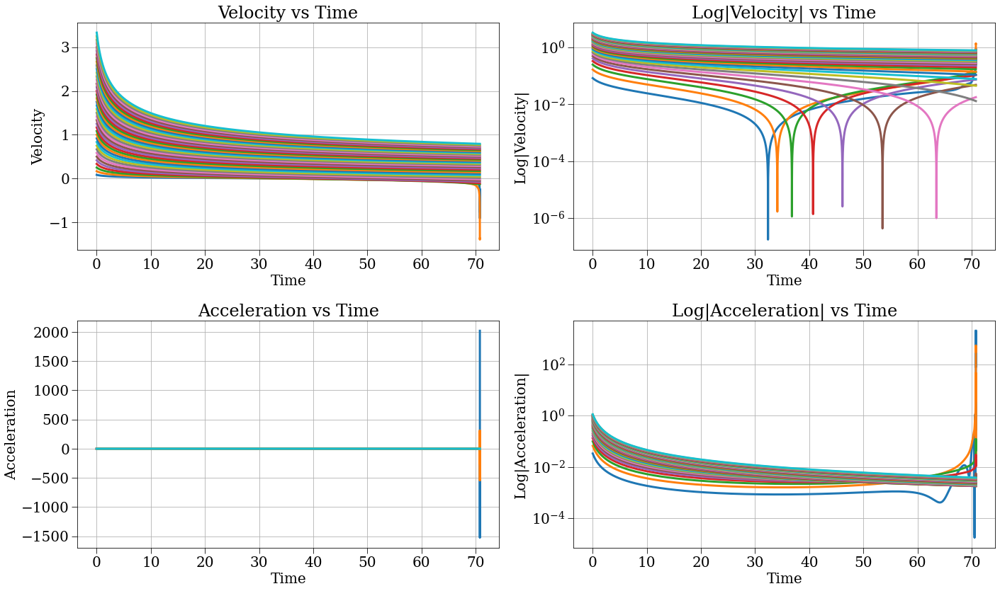

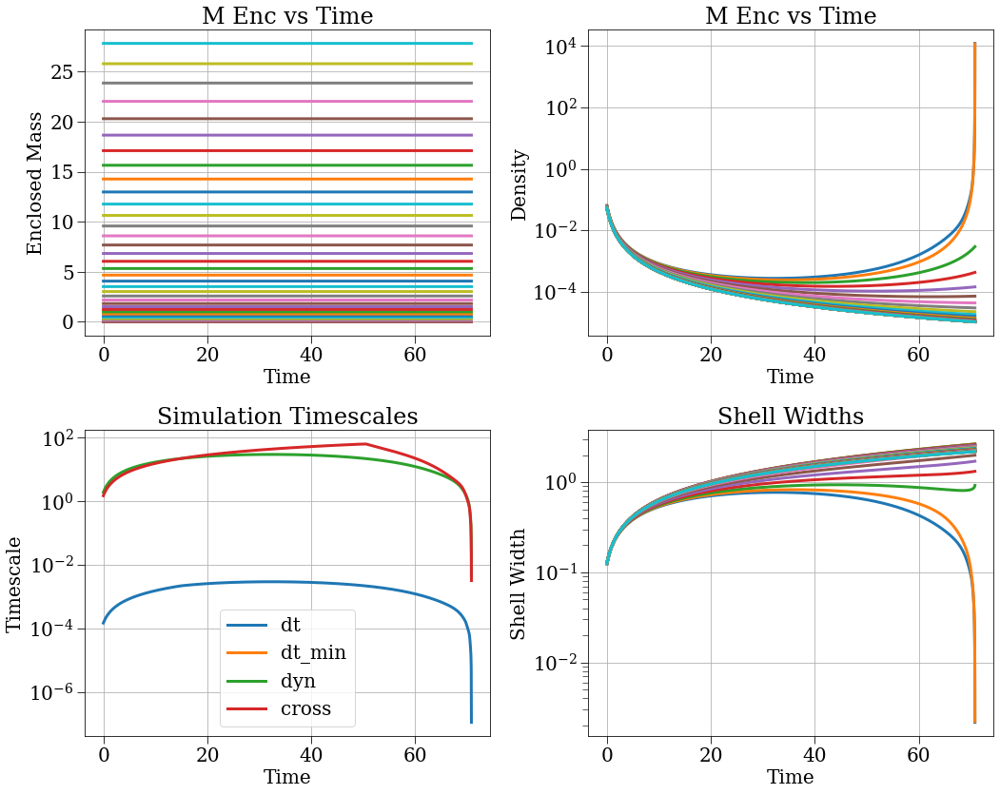

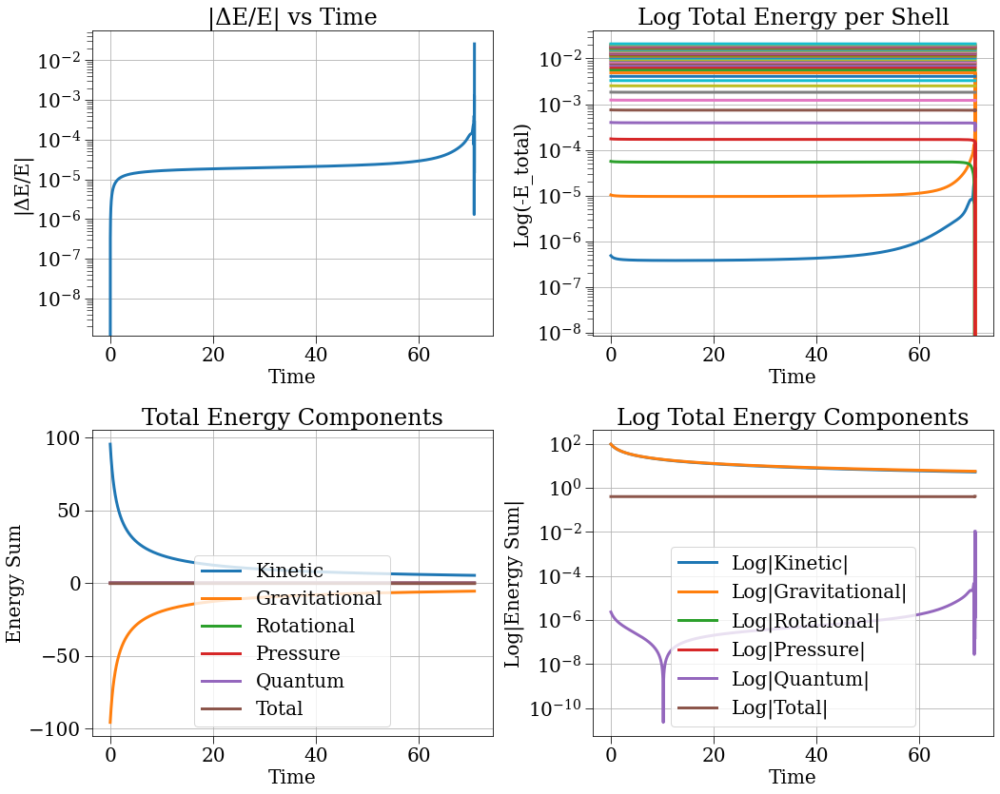

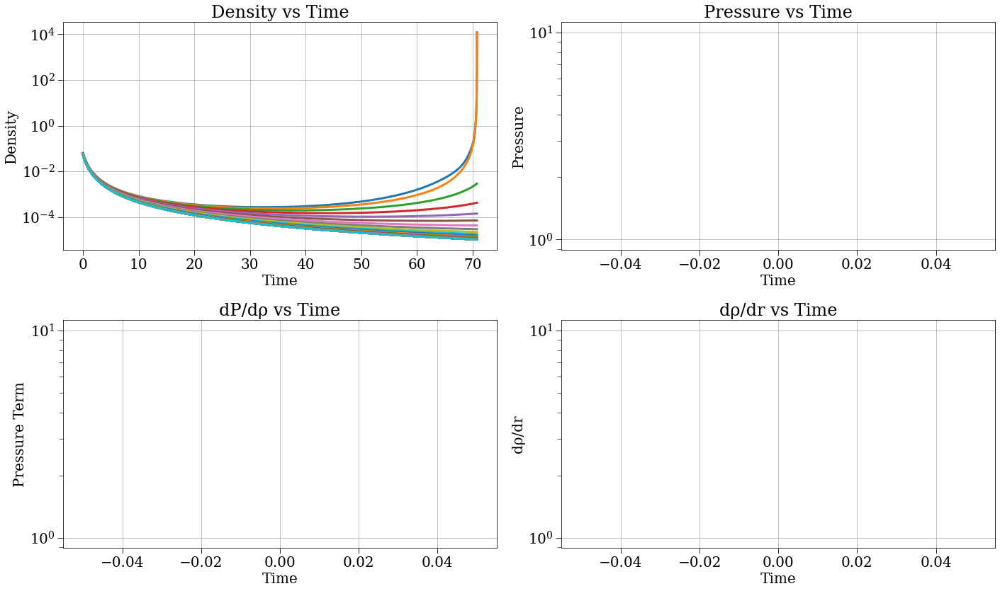

[0.125 0.25  0.375 0.5   0.625 0.75  0.875 1.    1.125 1.25  1.375 1.5
 1.625 1.75  1.875 2.    2.125 2.25  2.375 2.5   2.625 2.75  2.875 3.
 3.125 3.25  3.375 3.5   3.625 3.75  3.875 4.    4.125 4.25  4.375 4.5
 4.625 4.75  4.875 5.   ]


In [8]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[-0.02503747 -0.03274685 -0.00320458]


Text(0, 0.5, '$-a$')

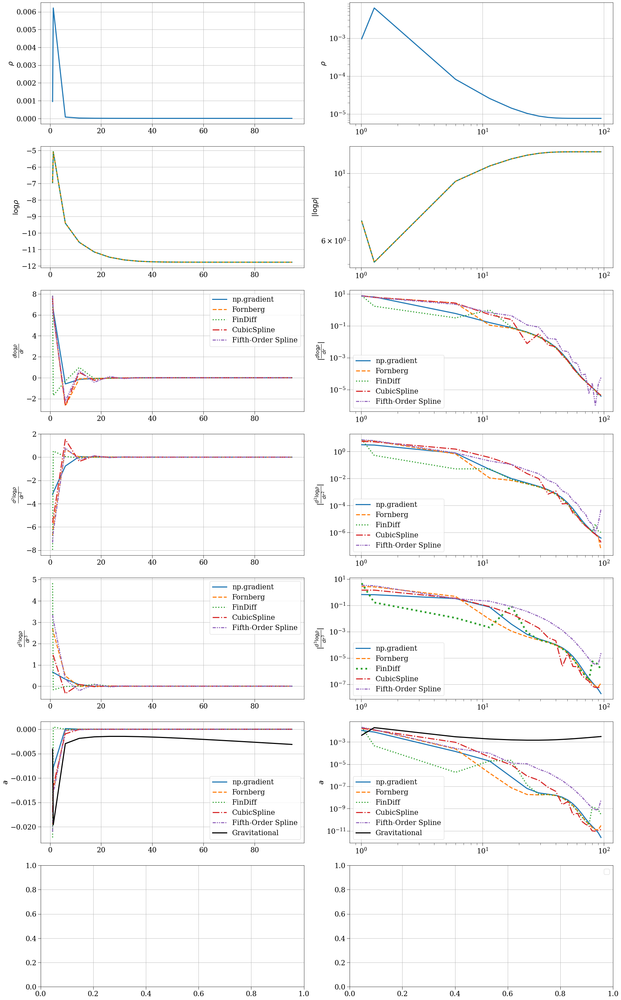

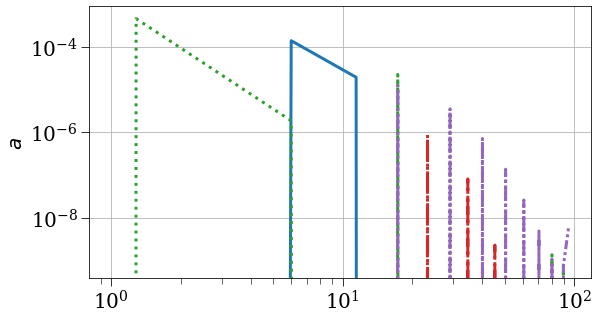

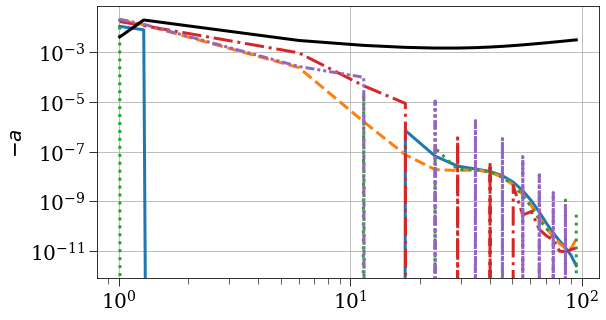

In [26]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = (1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad) * hm2
qp_fornberg = (1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg) * hm2
qp_fd = (1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd) * hm2
qp_cs = (1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs) * hm2
qp_fs = (1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs) * hm2

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.plot(r0, -(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(r['m_enc'][-1,:] / r0**2), label='Gravitational', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.figure()
plt.loglog(r0, qp_grad, label='np.gradient')
plt.loglog(r0, qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, -r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$a$')
plt.figure()
plt.loglog(r0, -qp_grad, label='np.gradient')
plt.loglog(r0, -qp_fornberg, label='Fornberg', ls='--')
plt.loglog(r0, -qp_fd, label='FinDiff', ls=':')
plt.loglog(r0, -qp_cs, label='CubicSpline', ls='-.')
plt.loglog(r0, -qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
plt.loglog(r0, r['m_enc'][-1,:] / r0**2, label='Gravitational', ls='-', color='black')
plt.ylabel(r'$-a$')

In [31]:
t_max = 0.54841
config_gauss = make_cycloid_config(N=200, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_vel_crossa_cross2', dt_min=0, safety_factor=1e-2, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=1e-3)#irs='equal_mass')

2025-04-30 18:48:02,812 - collapse - INFO - Simulation setup complete


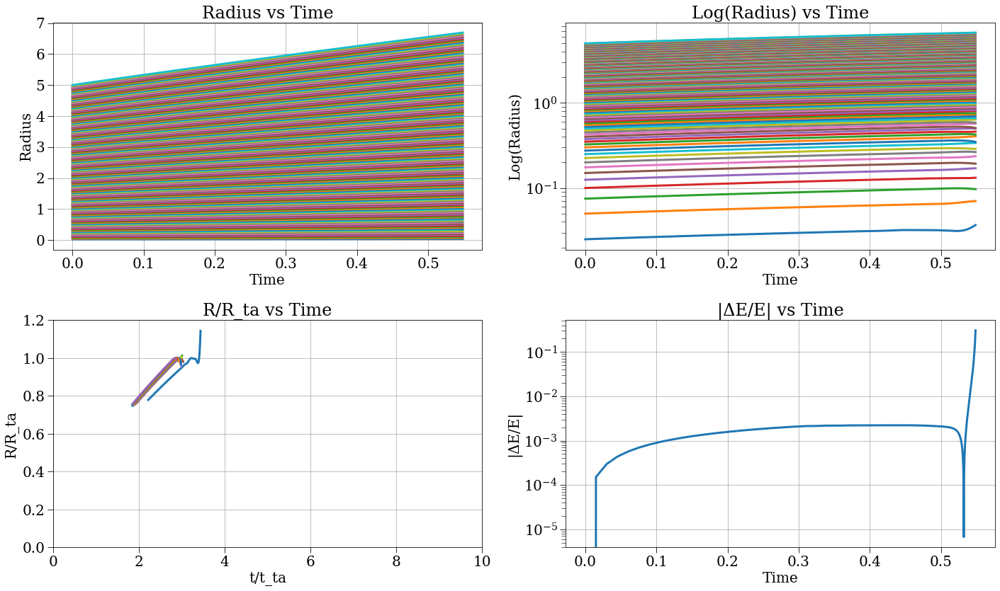

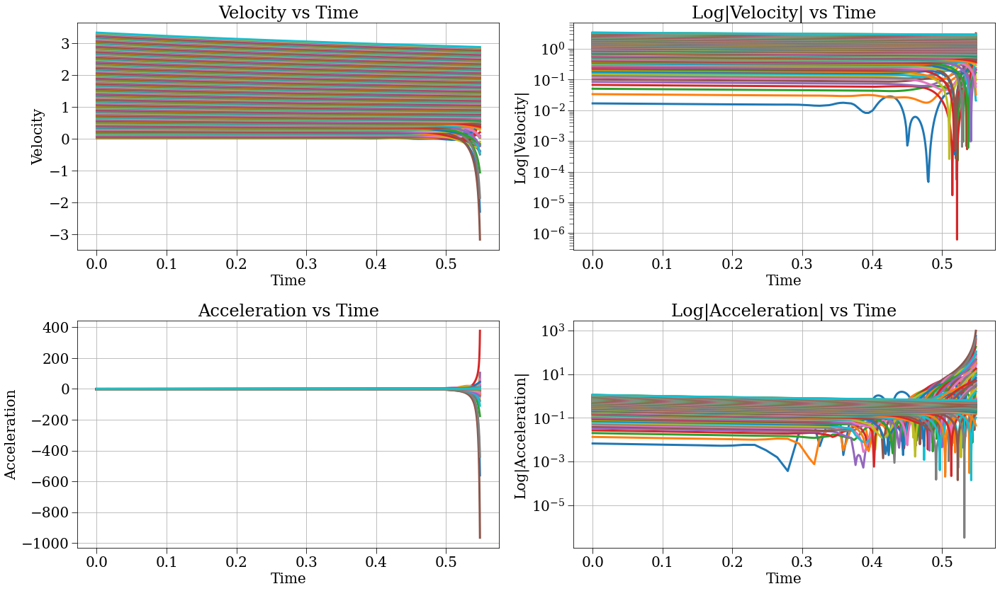

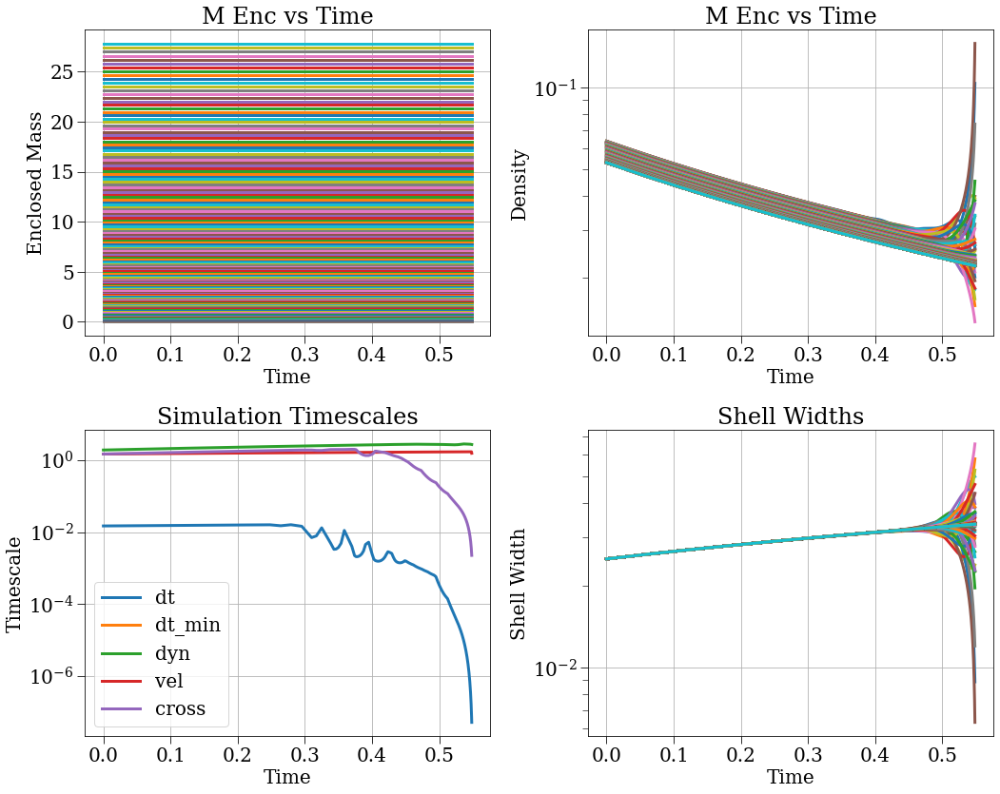

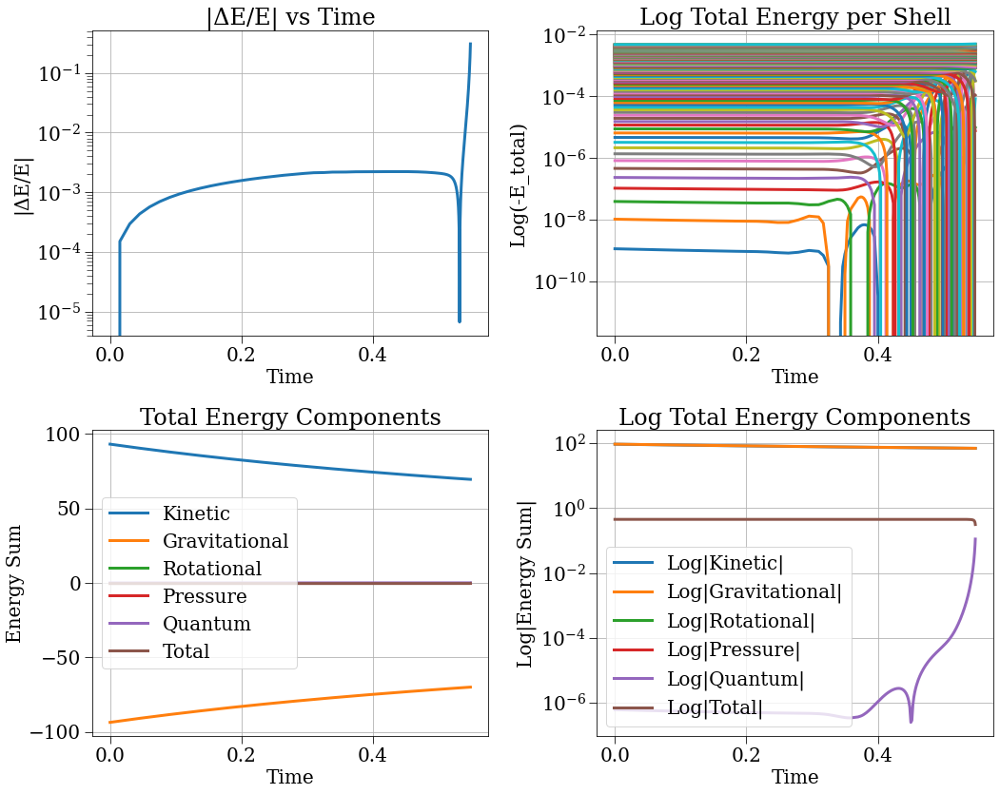

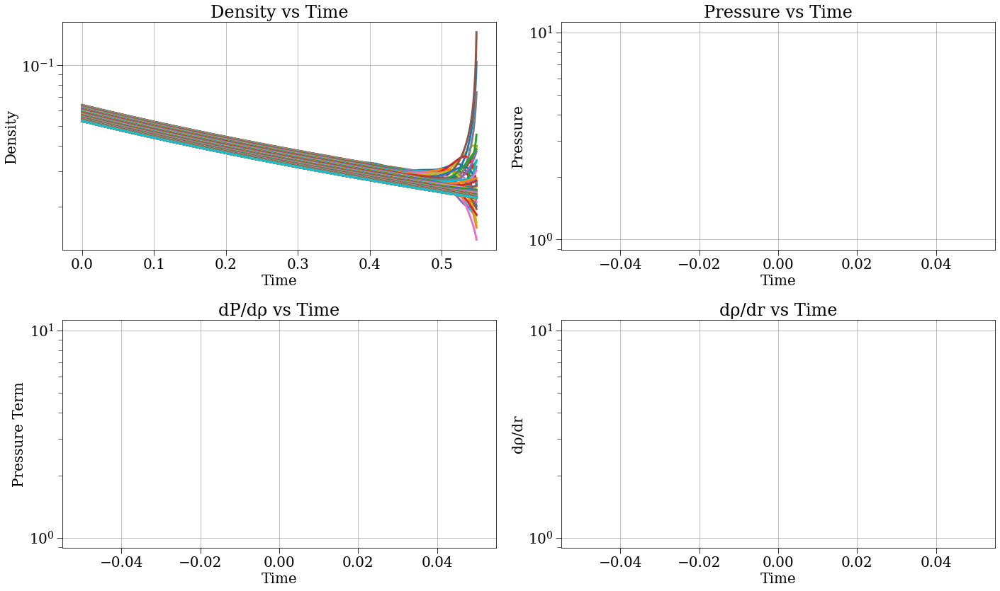

[0.025 0.05  0.075 0.1   0.125 0.15  0.175 0.2   0.225 0.25  0.275 0.3
 0.325 0.35  0.375 0.4   0.425 0.45  0.475 0.5   0.525 0.55  0.575 0.6
 0.625 0.65  0.675 0.7   0.725 0.75  0.775 0.8   0.825 0.85  0.875 0.9
 0.925 0.95  0.975 1.    1.025 1.05  1.075 1.1   1.125 1.15  1.175 1.2
 1.225 1.25  1.275 1.3   1.325 1.35  1.375 1.4   1.425 1.45  1.475 1.5
 1.525 1.55  1.575 1.6   1.625 1.65  1.675 1.7   1.725 1.75  1.775 1.8
 1.825 1.85  1.875 1.9   1.925 1.95  1.975 2.    2.025 2.05  2.075 2.1
 2.125 2.15  2.175 2.2   2.225 2.25  2.275 2.3   2.325 2.35  2.375 2.4
 2.425 2.45  2.475 2.5   2.525 2.55  2.575 2.6   2.625 2.65  2.675 2.7
 2.725 2.75  2.775 2.8   2.825 2.85  2.875 2.9   2.925 2.95  2.975 3.
 3.025 3.05  3.075 3.1   3.125 3.15  3.175 3.2   3.225 3.25  3.275 3.3
 3.325 3.35  3.375 3.4   3.425 3.45  3.475 3.5   3.525 3.55  3.575 3.6
 3.625 3.65  3.675 3.7   3.725 3.75  3.775 3.8   3.825 3.85  3.875 3.9
 3.925 3.95  3.975 4.    4.025 4.05  4.075 4.1   4.125 4.15  4.175 4.2
 4.225 

In [32]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[ 15.01768729 -10.4198703  -11.08378466]


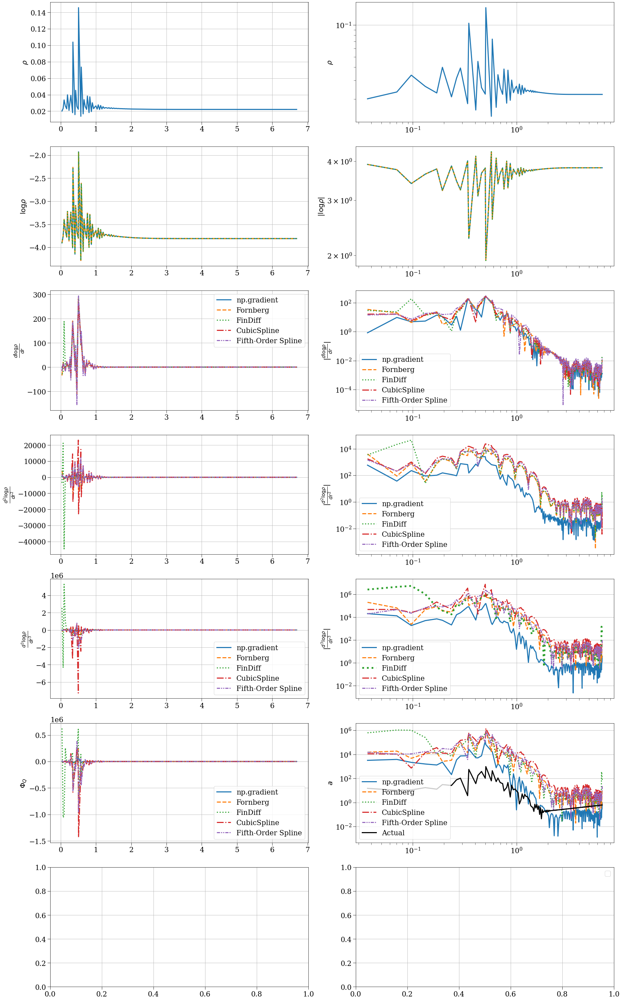

In [34]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = 1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad
qp_fornberg = 1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg
qp_fd = 1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd
qp_cs = 1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs
qp_fs = 1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\Phi_Q$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(a_fin), label='Actual', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.show()

In [5]:
t_max = 82.763
config_gauss = make_cycloid_config(N=20, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_cross_vel_crossa_cross2', dt_min=0, safety_factor=1e-2, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='quantum_potential', delta_i=0.2, r_th=1, energy_strategy='quantum_potential', H=H0, save_dt=1e-4, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', hbar2_over_m2=1e-3)#irs='equal_mass')

2025-04-30 17:16:22,267 - collapse - INFO - Simulation setup complete


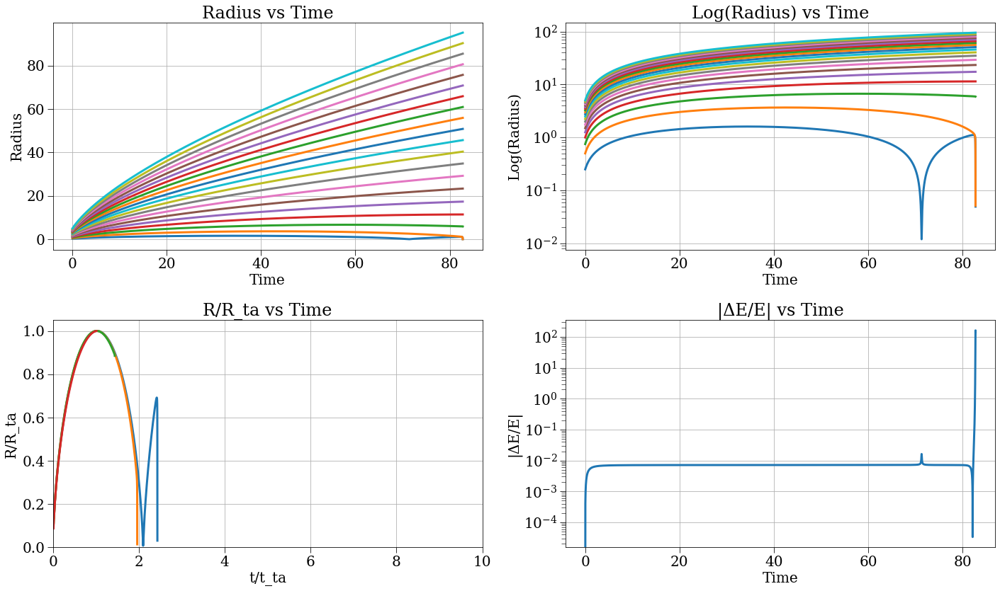

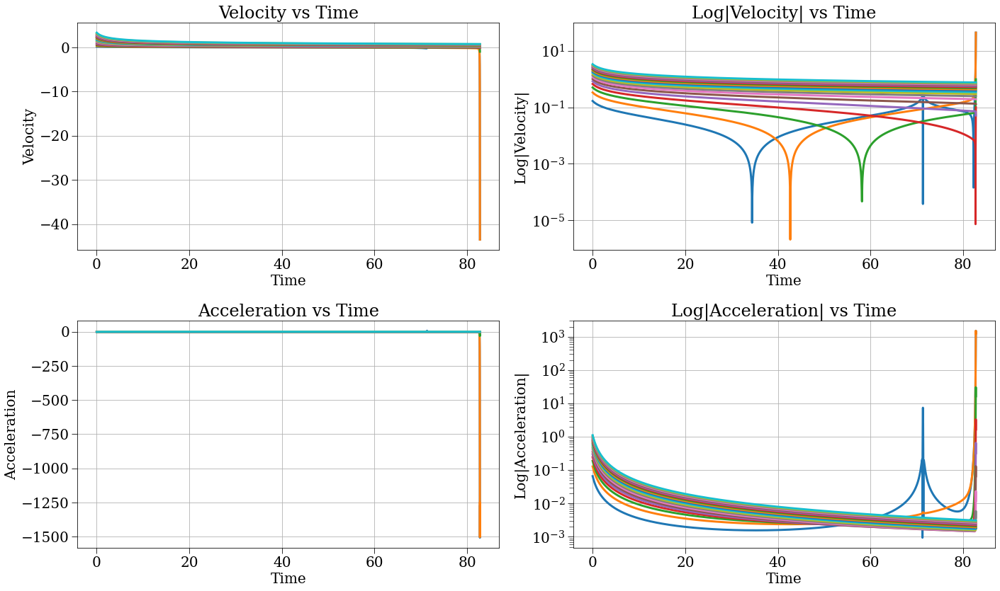

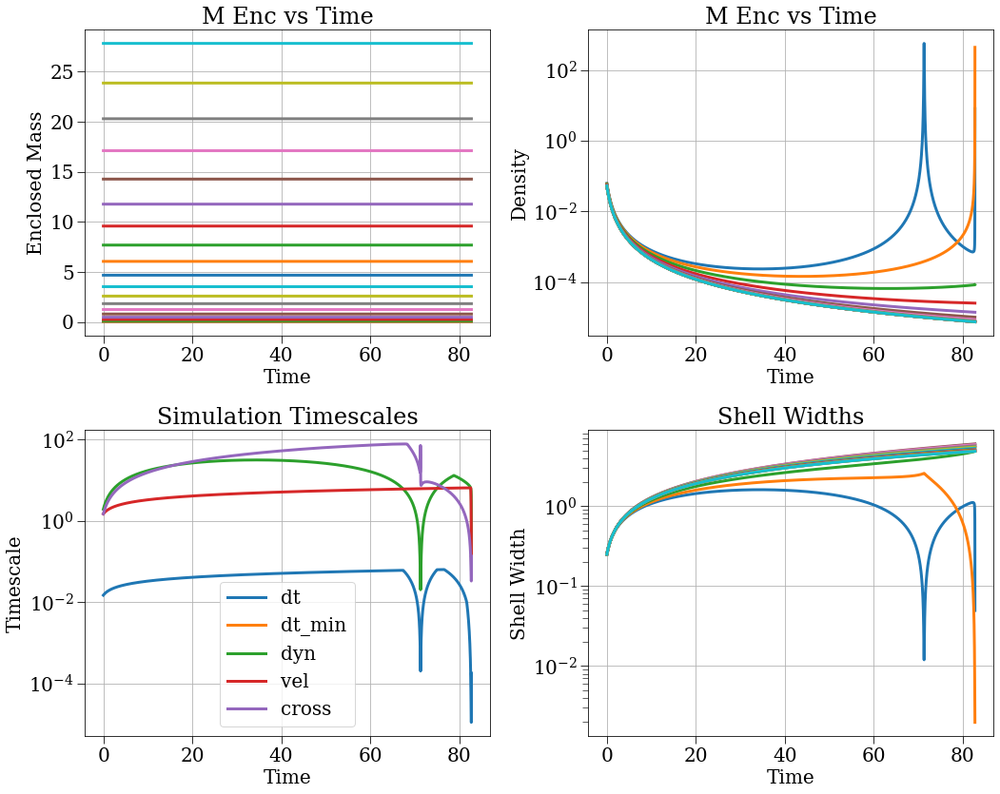

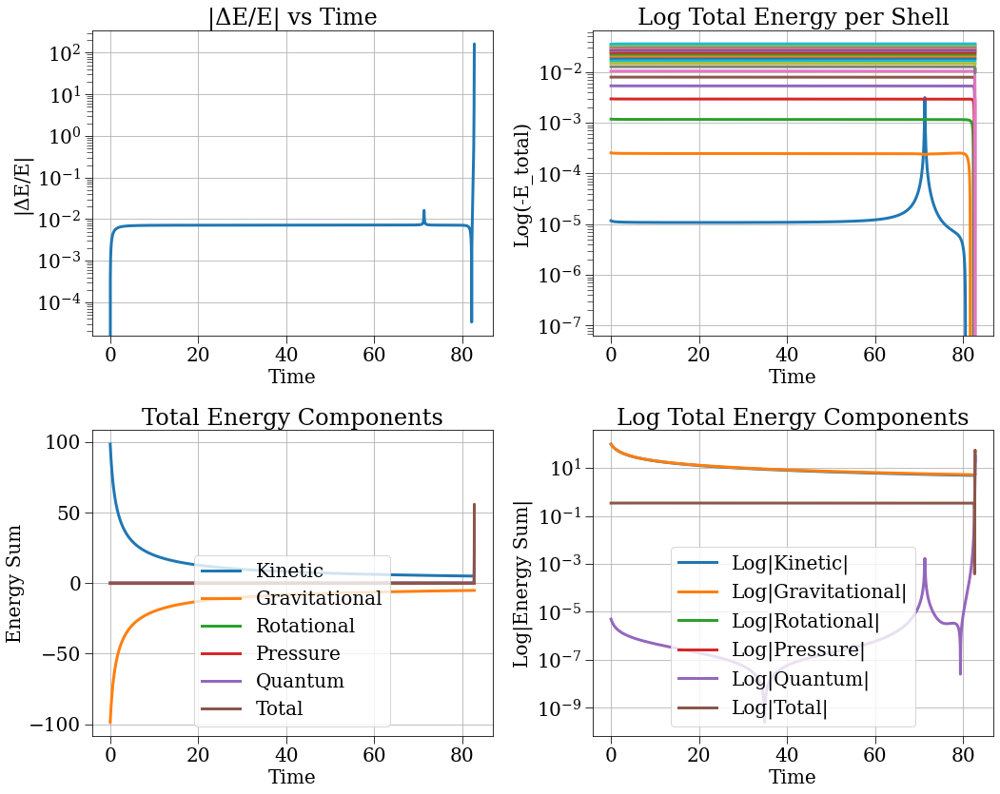

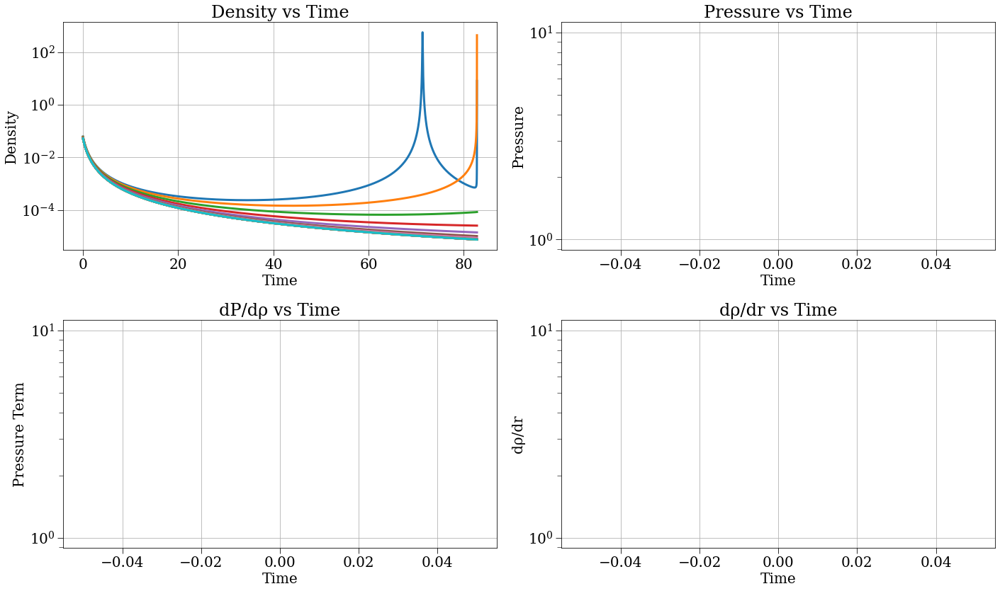

[0.25 0.5  0.75 1.   1.25 1.5  1.75 2.   2.25 2.5  2.75 3.   3.25 3.5
 3.75 4.   4.25 4.5  4.75 5.  ]


In [6]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

[-1277.76415586 -1253.10463678   -16.36475334]


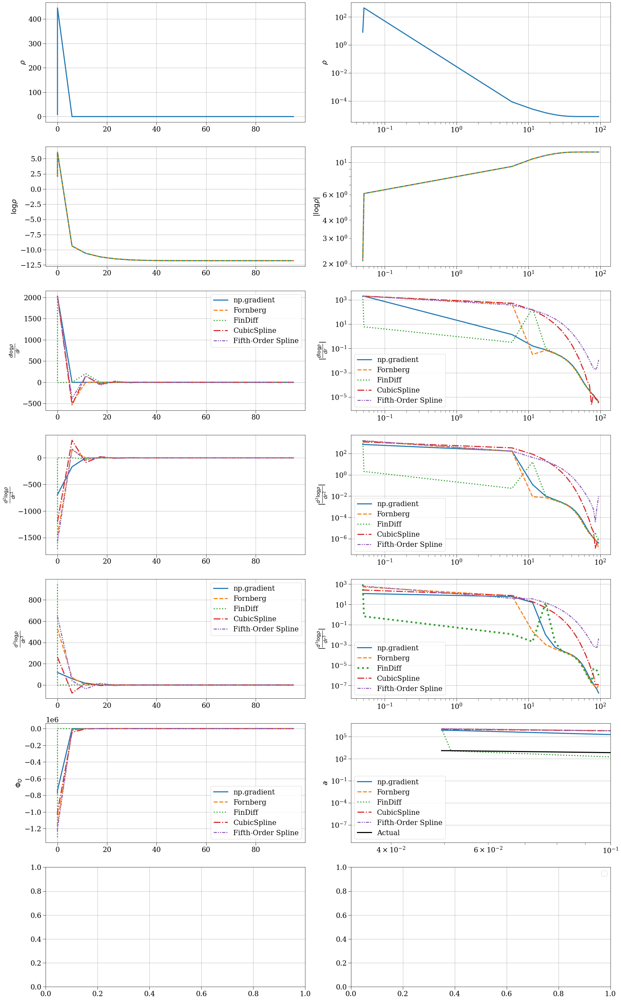

In [9]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin
print(a0[:3])

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = 1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad
qp_fornberg = 1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg
qp_fd = 1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd
qp_cs = 1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs
qp_fs = 1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\Phi_Q$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(a_fin), label='Actual', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        ax.set_xlim(None, 1e-1)
        ax.legend()


plt.tight_layout()
plt.show()

2025-04-30 16:38:23,125 - collapse - INFO - Simulation setup complete


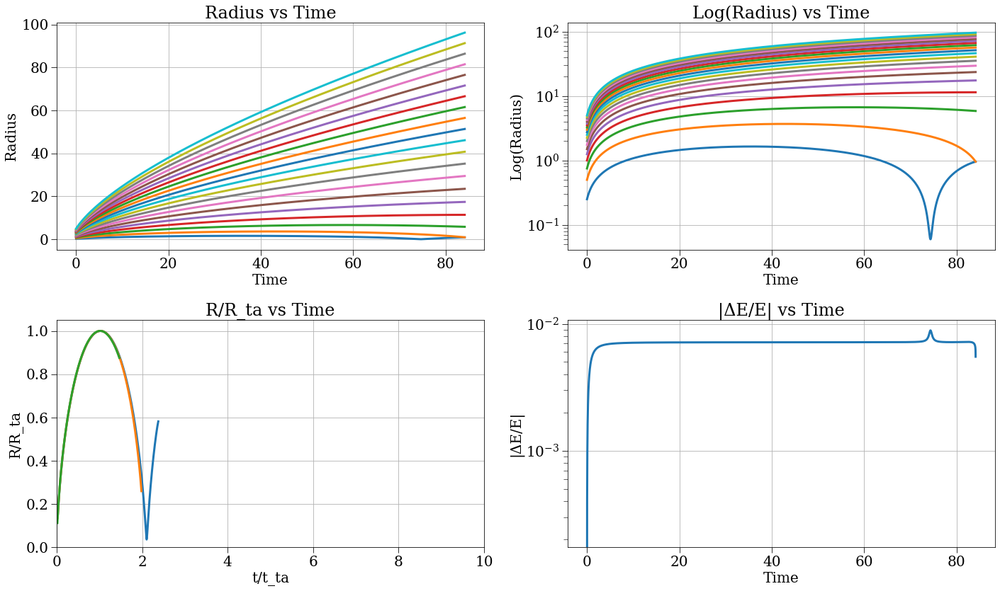

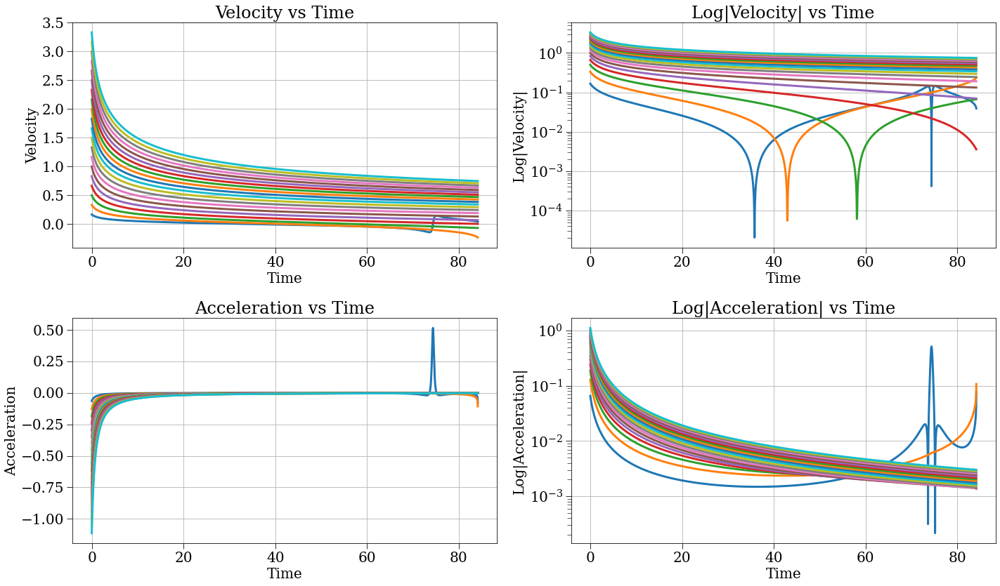

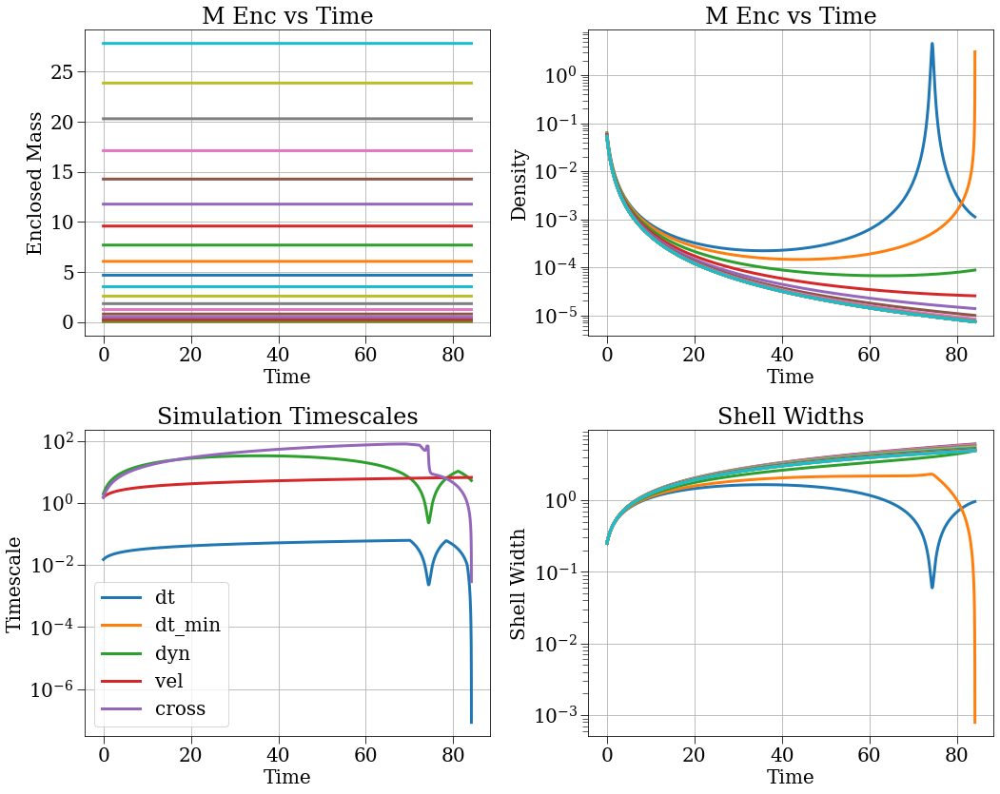

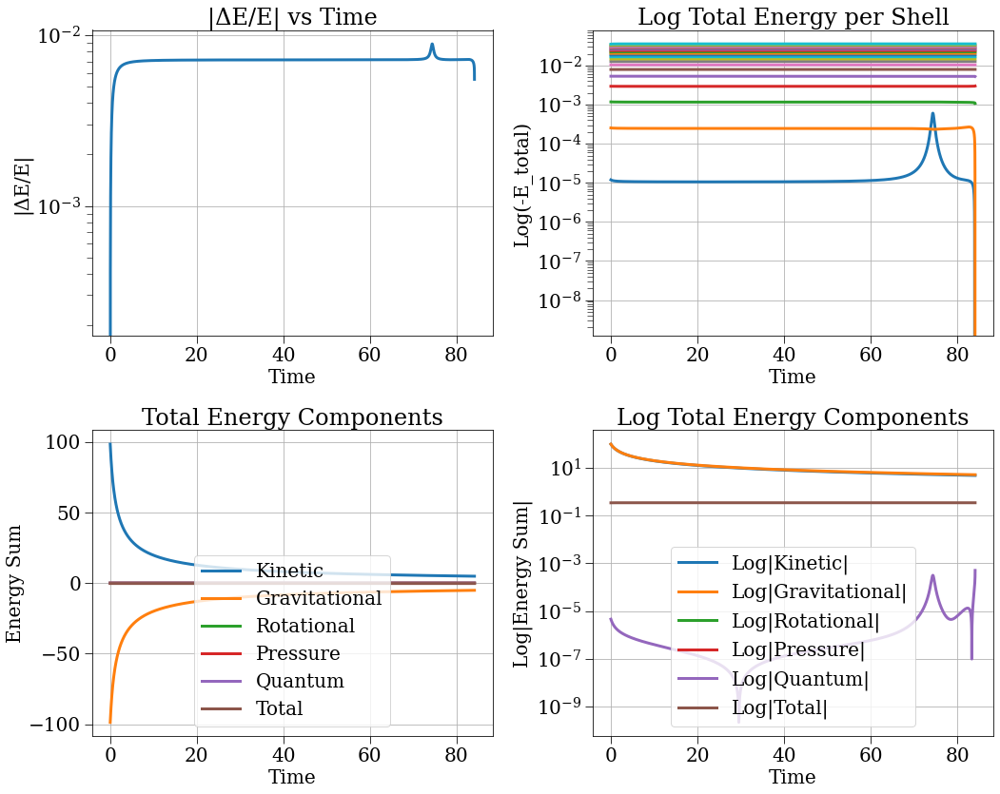

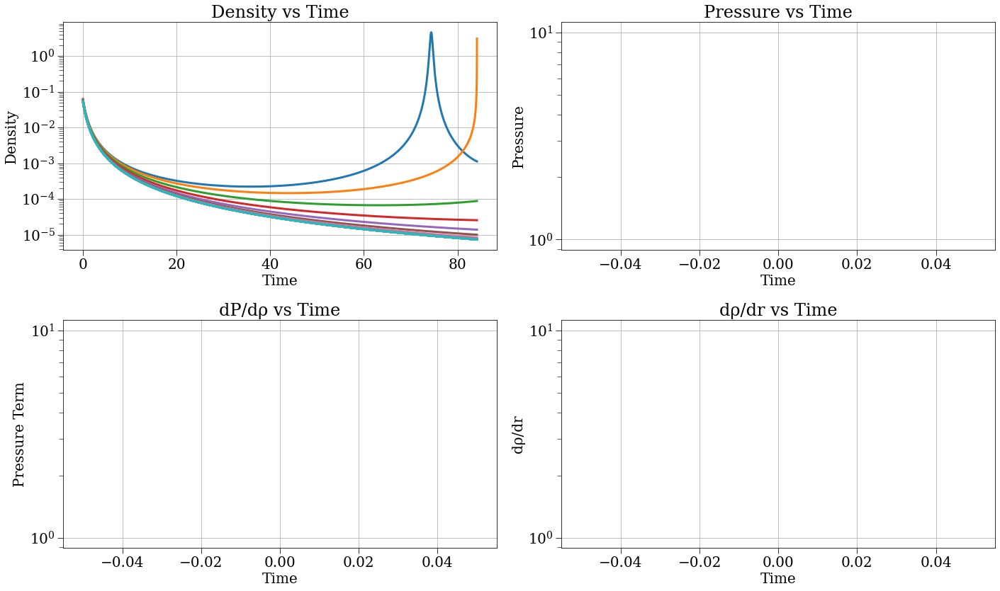

[0.25 0.5  0.75 1.   1.25 1.5  1.75 2.   2.25 2.5  2.75 3.   3.25 3.5
 3.75 4.   4.25 4.5  4.75 5.  ]


In [14]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/utils.py:138: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (array(float64, 1d, A), array(float64, 1d, C))
  dy[i] = np.dot(w[:, m], ys)


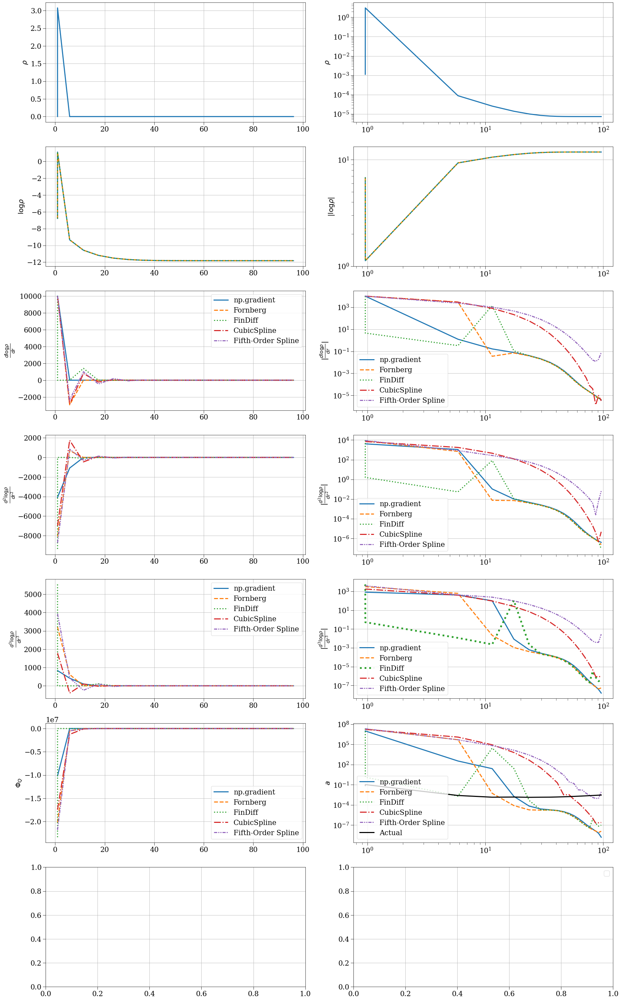

In [15]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
a0 = r['a'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
a_fin = r['a'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin
a0 = a_fin

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=6)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=6)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=6)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = 1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad
qp_fornberg = 1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg
qp_fd = 1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd
qp_cs = 1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs
qp_fs = 1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\Phi_Q$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.loglog(r0, np.abs(a_fin), label='Actual', ls='-', color='black')
        ax.set_ylabel(r'$a$')
        #ax.set_ylim(1e4, None)
        ax.legend()


plt.tight_layout()
plt.show()

2025-04-29 17:49:21,920 - collapse - INFO - Simulation setup complete



         32333698 function calls (31908103 primitive calls) in 58.196 seconds

   Ordered by: cumulative time
   List reduced from 414 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    1.858    1.858   58.196   58.196 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:247(run)
   103892    0.951    0.000   42.179    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:292(_update_simulation)
   103892    1.508    0.000   21.284    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:538(__call__)
   103892    4.797    0.000   17.548    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:1024(__call__)
   103892    4.043    0.000   14.213    0.000 /home/jsipple/one_d_spherical_collapse/

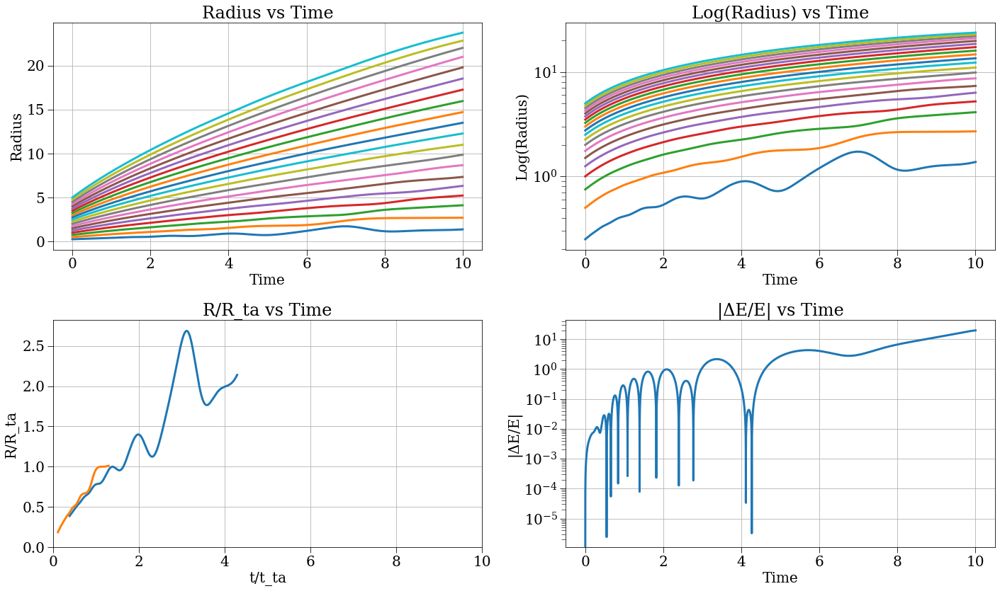

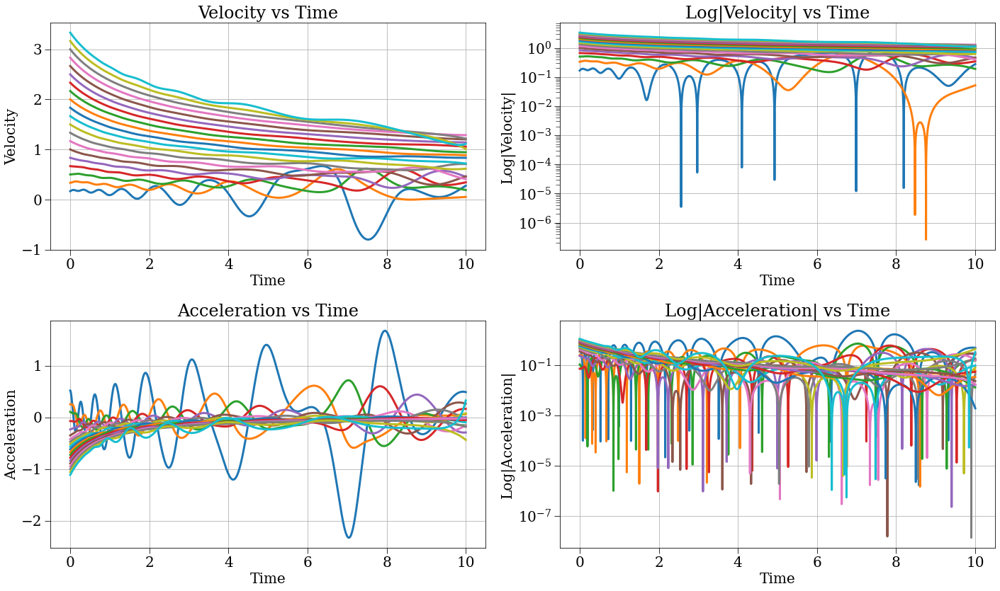

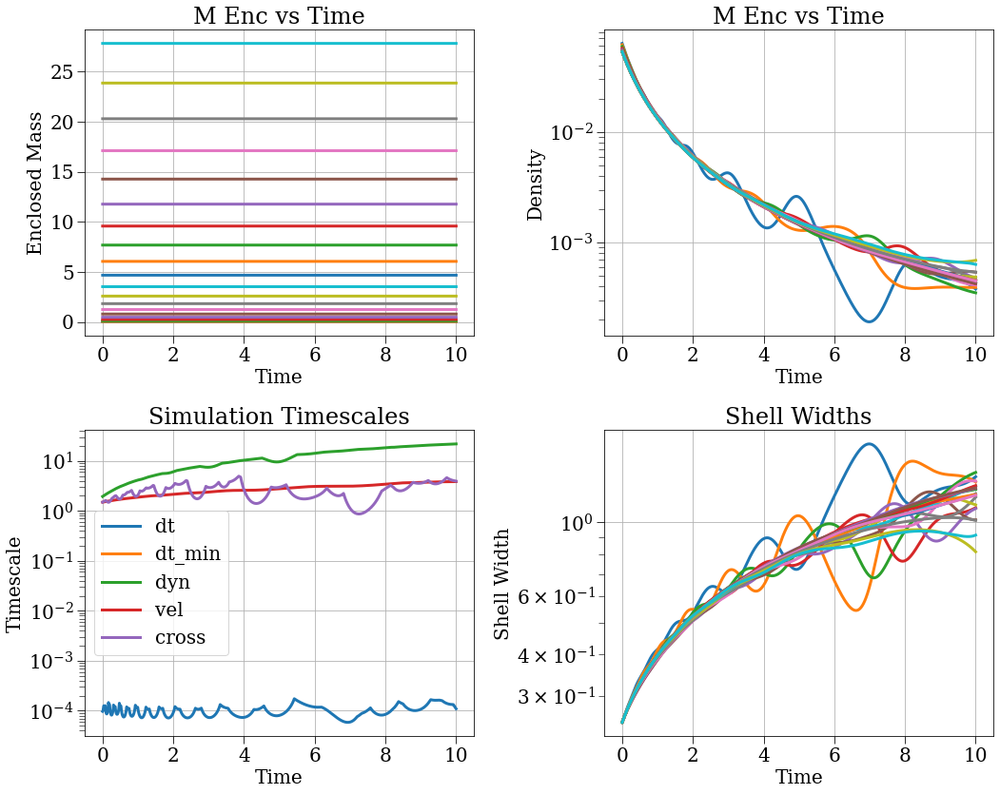

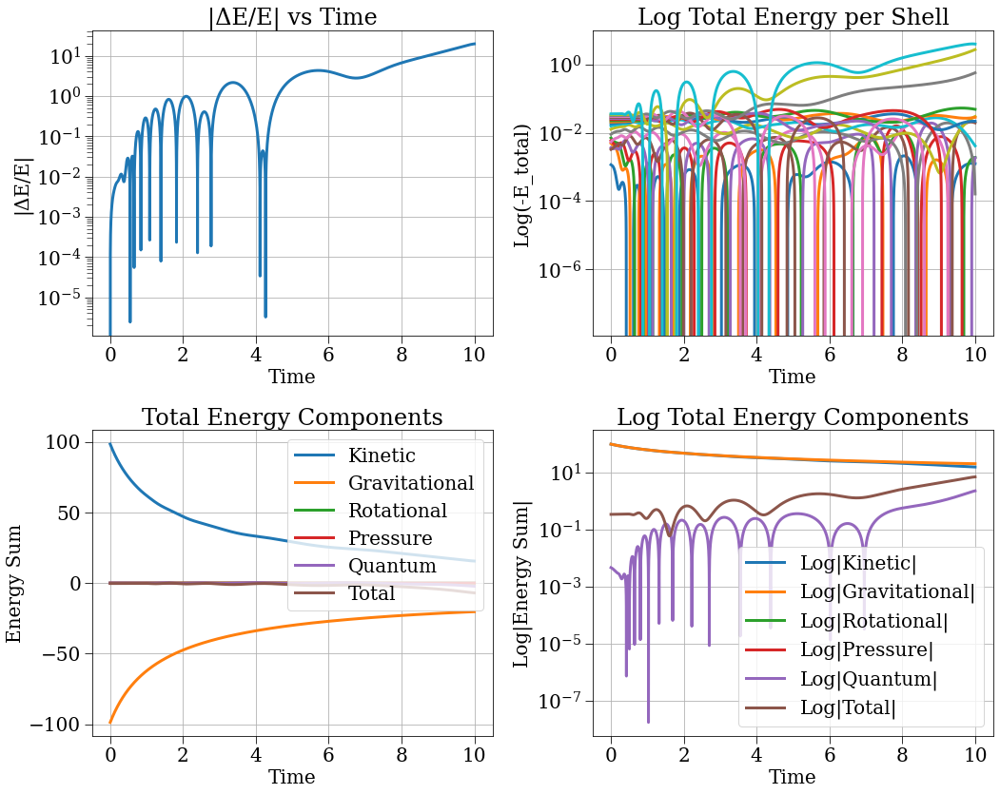

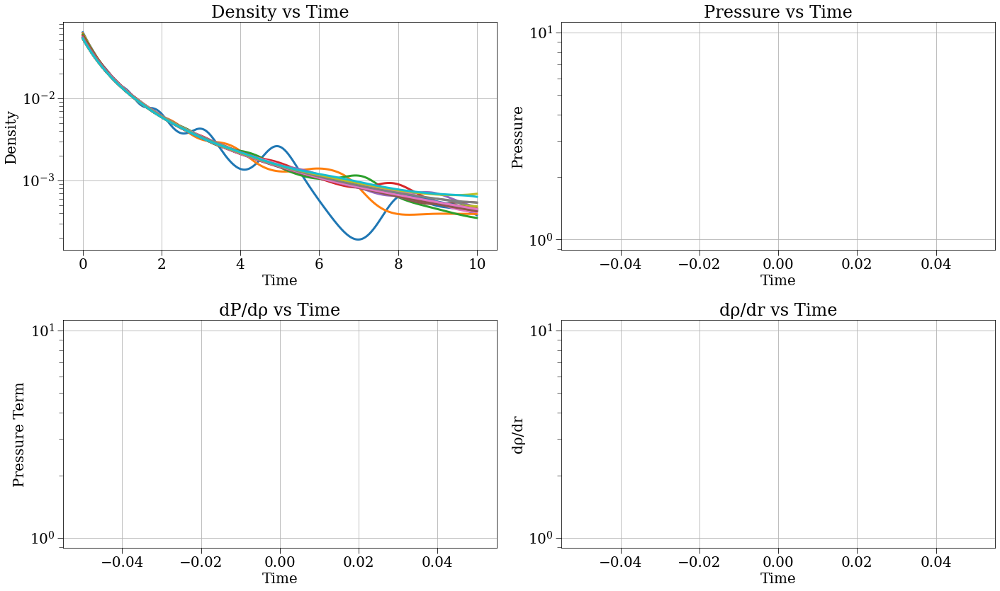

[0.25 0.5  0.75 1.   1.25 1.5  1.75 2.   2.25 2.5  2.75 3.   3.25 3.5
 3.75 4.   4.25 4.5  4.75 5.  ]


In [24]:
s, r, c = run_and_plot(config_gauss, profile=True)
print(r['r'][0,:])

In [6]:
t_max = 62
config_gauss = make_cycloid_config(N=2000, reflect_bool=False, t_max=t_max, r_min=0, timescale_strategy='dyn', dt_min=0, safety_factor=1e-4, pressure_strategy='zero', no_pm=False, r_max=5, accel_strategy='soft_all', delta_i=0.2, r_th=1, energy_strategy='kin_grav_rot', H=H0, save_dt=1e-2, stepper_strategy='beeman', j_coeff=0, density_strategy='background_plus_gaussian',)#irs='equal_mass')

2025-05-01 02:57:12,138 - collapse - INFO - Simulation setup complete


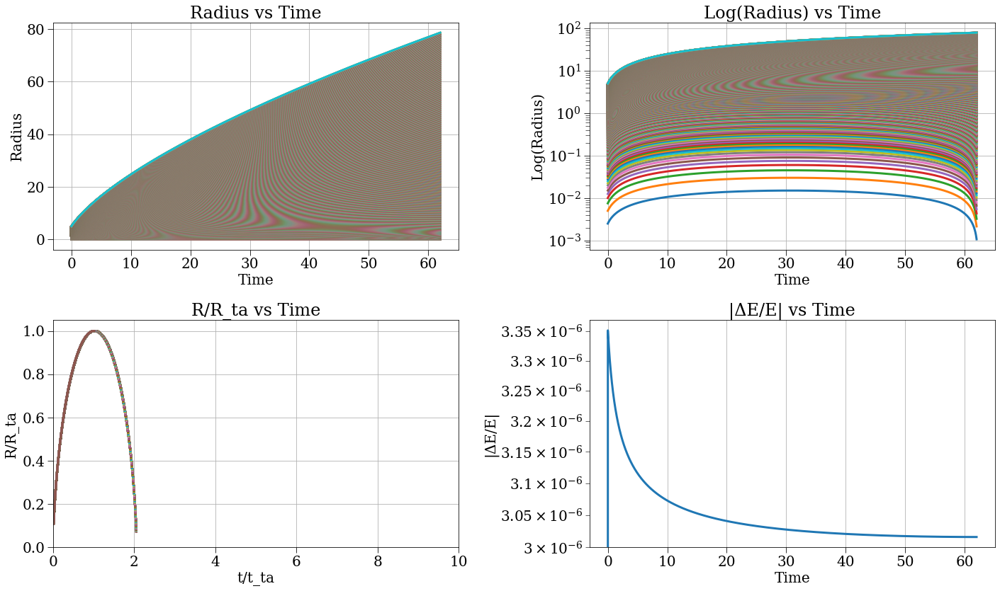

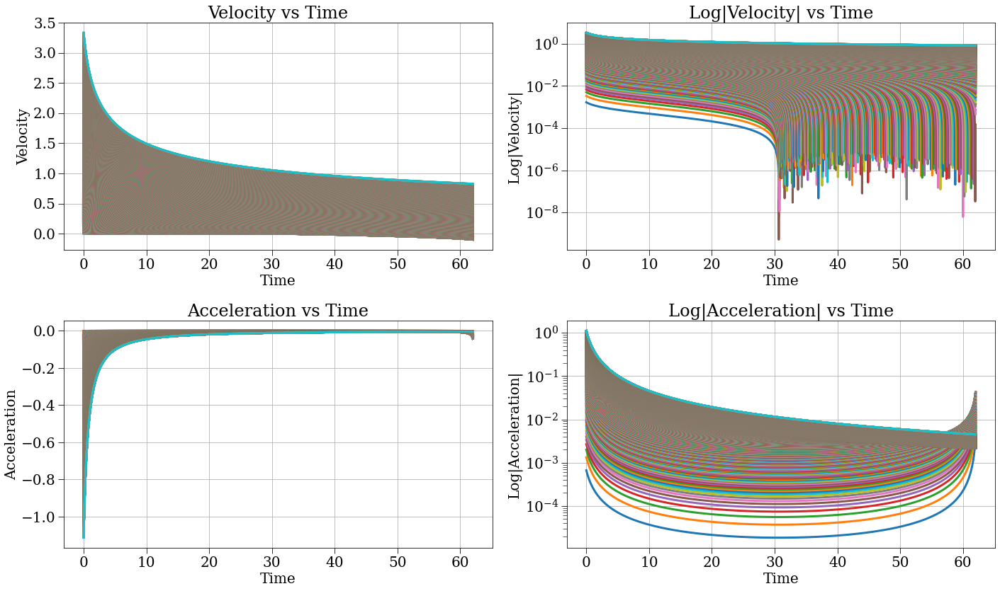

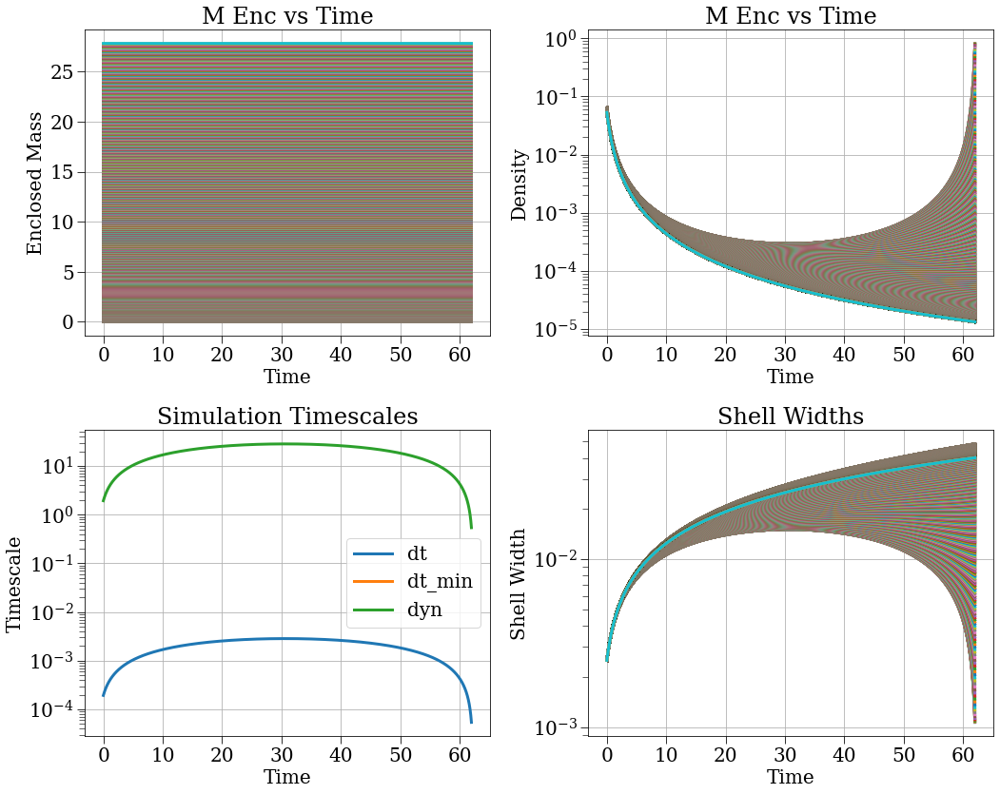

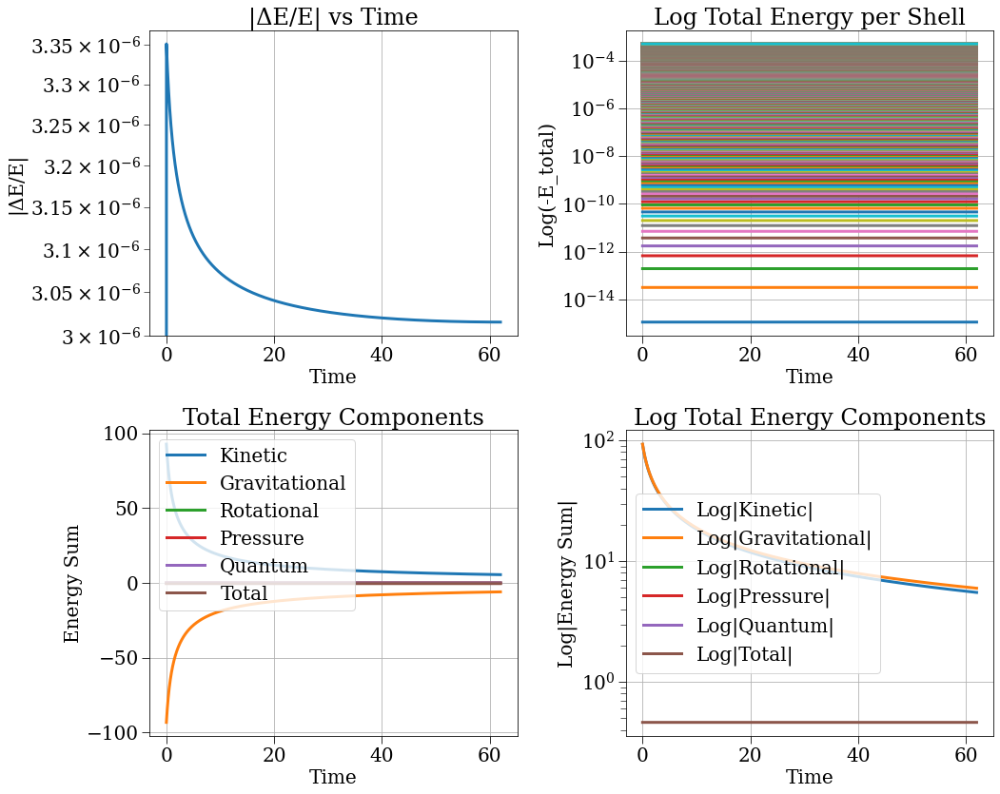

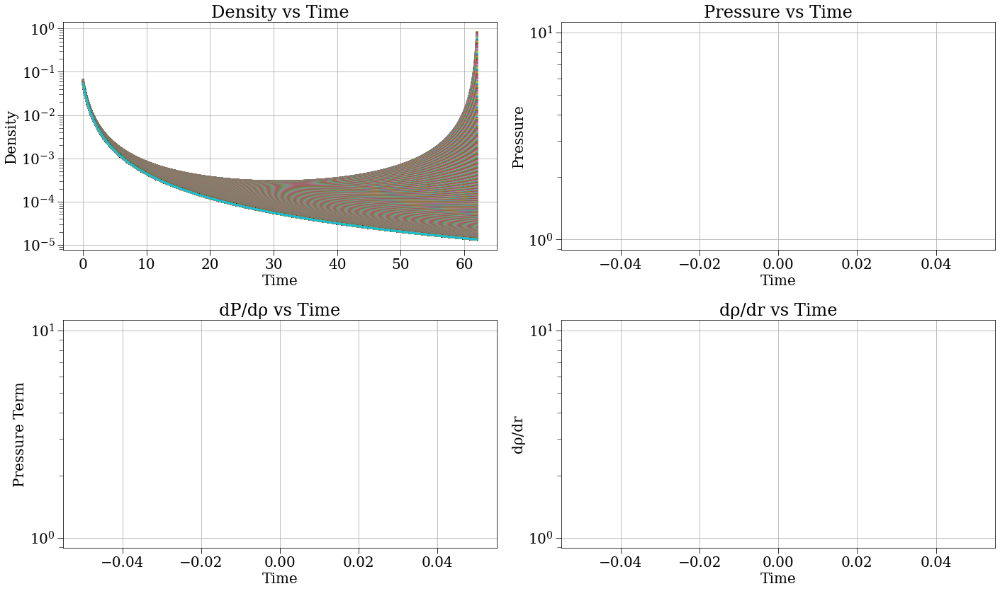

[2.5000e-03 5.0000e-03 7.5000e-03 ... 4.9950e+00 4.9975e+00 5.0000e+00]


In [7]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

### Derivatives (Different Ways)

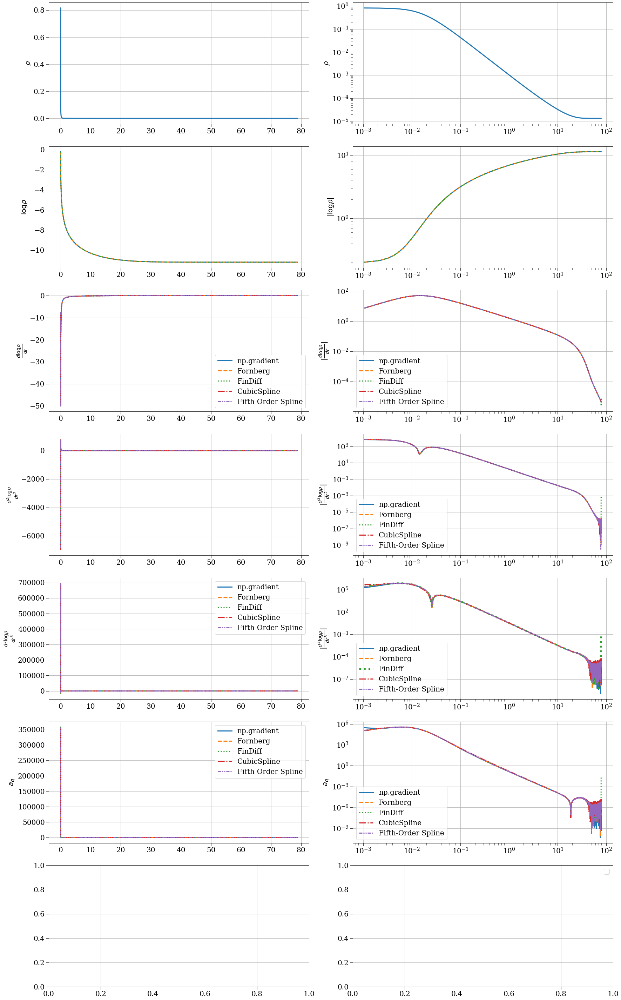

In [8]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=12)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=12)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=12)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = 1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad
qp_fornberg = 1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg
qp_fd = 1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd
qp_cs = 1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs
qp_fs = 1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        #ax.set_ylim(1e4, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$a_q$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$a_q$')
        #ax.set_ylim(1e4, None)
        ax.legend()


plt.tight_layout()
plt.show()

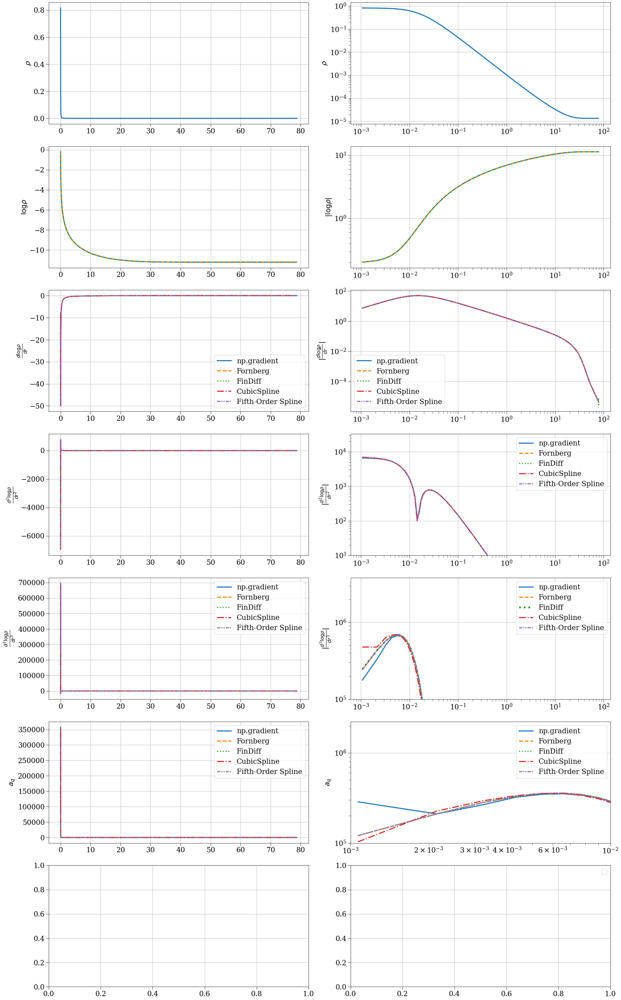

In [11]:
# values at different times
r0 = r['r'][0,:]
rho0 = r['rho_r'][0,:]
r_fin = r['r'][-1,:]
rho_fin = r['rho_r'][-1,:]
t_fin = r['t'][-1]
rho_H_fin = rho_H / t_fin**2
r0 = r_fin
rho0 = rho_fin

# rho, logrho, dlogrho, d2logrho, d3logrho, qp, aq
# Create a figure with 14 subplots (arranged as 4x4 with 2 unused)
fig, axes = plt.subplots(7, 2, figsize=(25, 40))
axes = axes.flatten()  # Flatten to easily iterate through all subplots

log0 = np.log(rho0)
cs = CubicSpline(r0, log0)
fs = splrep(r0, log0, k=5)

dlog_grad = np.gradient(log0, r0, edge_order=2)
dlog_fornberg = derivative_nonuniform(r0, log0, 1, stencil_size=5)
dlog_fd = FinDiff(0, r0, 1, acc=12)(log0)
dlog_cs = cs(r0, 1)
dlog_fs = splev(r0, fs, der=1)

d2log_grad = np.gradient(dlog_grad, r0, edge_order=2)
d2log_fornberg = derivative_nonuniform(r0, log0, 2, stencil_size=5)
d2log_fd = FinDiff(0, r0, 2, acc=12)(log0)
d2log_cs = cs(r0, 2)
d2log_fs = splev(r0, fs, der=2)

d3log_grad = np.gradient(d2log_grad, r0, edge_order=2)
d3log_fornberg = derivative_nonuniform(r0, log0, 3, stencil_size=5)
d3log_fd = FinDiff(0, r0, 3, acc=12)(log0)
d3log_cs = cs(r0, 3)
d3log_fs = splev(r0, fs, der=3)

qp_grad = 1/4 * d3log_grad + 1/4 * dlog_grad * d2log_grad - 1/2 * 1/r0**2 * dlog_grad + 1/2 * 1/r0 * d2log_grad
qp_fornberg = 1/4 * d3log_fornberg + 1/4 * dlog_fornberg * d2log_fornberg - 1/2 * 1/r0**2 * dlog_fornberg + 1/2 * 1/r0 * d2log_fornberg
qp_fd = 1/4 * d3log_fd + 1/4 * dlog_fd * d2log_fd - 1/2 * 1/r0**2 * dlog_fd + 1/2 * 1/r0 * d2log_fd
qp_cs = 1/4 * d3log_cs + 1/4 * dlog_cs * d2log_cs - 1/2 * 1/r0**2 * dlog_cs + 1/2 * 1/r0 * d2log_cs
qp_fs = 1/4 * d3log_fs + 1/4 * dlog_fs * d2log_fs - 1/2 * 1/r0**2 * dlog_fs + 1/2 * 1/r0 * d2log_fs

# Example plotting on each subplot
for i, ax in enumerate(axes):
    if i == 0:
        ax.plot(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 1:
        ax.loglog(r0, rho0)
        ax.set_ylabel(r'$\rho$')
    elif i == 2:
        ax.plot(r0, np.log(rho0))
        ax.plot(r0, cs(r0, 0), ls='--')
        ax.plot(r0, splev(r0, fs, der=0), ls=':')
        ax.set_ylabel(r'$\log\rho$')
    elif i == 3:
        ax.loglog(r0, np.abs(np.log(rho0)))
        ax.plot(r0, np.abs(cs(r0, 0)), ls='--')
        ax.plot(r0, np.abs(splev(r0, fs, der=0)), ls=':')
        ax.set_ylabel(r'$|\log\rho|$')
        plt.legend()
    elif i == 4:
        ax.plot(r0, dlog_grad, label='np.gradient',)
        ax.plot(r0, dlog_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, dlog_fd, label='FinDiff', ls=':')
        ax.plot(r0, dlog_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, dlog_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d\log\rho}{dr}$')
        ax.legend()
    elif i == 5:
        ax.loglog(r0, np.abs(dlog_grad), label='np.gradient')
        ax.loglog(r0, np.abs(dlog_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(dlog_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(dlog_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(dlog_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d\log\rho}{dr}|$')
        #ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 6:
        ax.plot(r0, d2log_grad, label='np.gradient')
        ax.plot(r0, d2log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d2log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d2log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d2log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^2\log\rho}{dr^2}$')
    elif i == 7:
        ax.loglog(r0, np.abs(d2log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d2log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d2log_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(d2log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d2log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^2\log\rho}{dr^2}|$')
        ax.set_ylim(1e1, None)
        ax.legend()
    elif i == 8:
        ax.plot(r0, d3log_grad, label='np.gradient')
        ax.plot(r0, d3log_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, d3log_fd, label='FinDiff', ls=':')
        ax.plot(r0, d3log_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, d3log_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$\frac{d^3\log\rho}{dr^3}$')
        ax.legend()
    elif i == 9:
        ax.loglog(r0, np.abs(d3log_grad), label='np.gradient')
        ax.loglog(r0, np.abs(d3log_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(d3log_fd), label='FinDiff', ls=':', lw=5)
        ax.loglog(r0, np.abs(d3log_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(d3log_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$|\frac{d^3\log\rho}{dr^3}|$')
        ax.set_ylim(1e5, None)
        ax.legend()
    elif i == 10:
        ax.plot(r0, qp_grad, label='np.gradient')
        ax.plot(r0, qp_fornberg, label='Fornberg', ls='--')
        ax.plot(r0, qp_fd, label='FinDiff', ls=':')
        ax.plot(r0, qp_cs, label='CubicSpline', ls='-.')
        ax.plot(r0, qp_fs, label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$a_q$')
        ax.legend()
    elif i == 11:
        ax.loglog(r0, np.abs(qp_grad), label='np.gradient')
        ax.loglog(r0, np.abs(qp_fornberg), label='Fornberg', ls='--')
        ax.loglog(r0, np.abs(qp_fd), label='FinDiff', ls=':')
        ax.loglog(r0, np.abs(qp_cs), label='CubicSpline', ls='-.')
        ax.loglog(r0, np.abs(qp_fs), label='Fifth-Order Spline', ls=(0, (3, 1, 1, 1, 1, 1)))
        ax.set_ylabel(r'$a_q$')
        ax.set_ylim(1e5, None)
        ax.set_xlim(1e-3, 1e-2)
        ax.legend()


plt.tight_layout()
plt.show()